# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

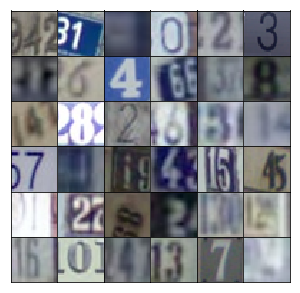

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        
        # First fully connected layer
        # Shape: 4x4x512
        x1 = tf.layers.dense(inputs=z, units=4*4*512, activation=None)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)  # Leaky ReLU
        
        # First convolutional layer
        # Shape: 8x8x256
        x2 = tf.layers.conv2d_transpose(inputs=x1, filters=256, kernel_size=(5, 5), strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
                
        # Second convolutional layer
        # Shape: 16x16x128
        x3 = tf.layers.conv2d_transpose(x2, 128, (5, 5), 2, 'same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        # Output layer
        # Shape: 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, (5, 5), 2, 'same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Shape of x: 32x32x3
        
        # First convolutional layer
        # Shape: 16x16x64
        x1 = tf.layers.conv2d(inputs=x, filters=64, kernel_size=(5,5), strides=2, padding='same')
        x1 = tf.maximum(alpha * x1, x1)  # Leaky ReLU
        
        # Second convolutional layer
        # Shape: 8x8x128
        x2 = tf.layers.conv2d(x1, 128, (5,5), 2, 'same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        
        # Third convolutional layer
        # Shape: 4x4x256
        x3 = tf.layers.conv2d(x1, 128, (5,5), 2, 'same')
        x3 = tf.layers.batch_normalization(x2, training=True)
        x3 = tf.maximum(alpha * x2, x2)
        
        flat = tf.reshape(x3, (-1, 4*4*256))
        logits = tf.layers.dense(inputs=flat, units=1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

**Reminder:** It's a good thing if the discriminator is classifiying images as real or fake about 50% of the time. This means that it cannot tell the difference between them and basically resorts to guessing.

In [16]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 4.1708... Generator Loss: 0.0342
Epoch 1/25... Discriminator Loss: 3.8977... Generator Loss: 0.0588
Epoch 1/25... Discriminator Loss: 2.3332... Generator Loss: 0.2890
Epoch 1/25... Discriminator Loss: 1.9581... Generator Loss: 0.4850
Epoch 1/25... Discriminator Loss: 2.2248... Generator Loss: 0.4929
Epoch 1/25... Discriminator Loss: 1.4300... Generator Loss: 0.7156
Epoch 1/25... Discriminator Loss: 1.7064... Generator Loss: 0.5621
Epoch 1/25... Discriminator Loss: 1.4543... Generator Loss: 0.9081
Epoch 1/25... Discriminator Loss: 1.1893... Generator Loss: 0.8970
Epoch 1/25... Discriminator Loss: 1.2620... Generator Loss: 0.9764


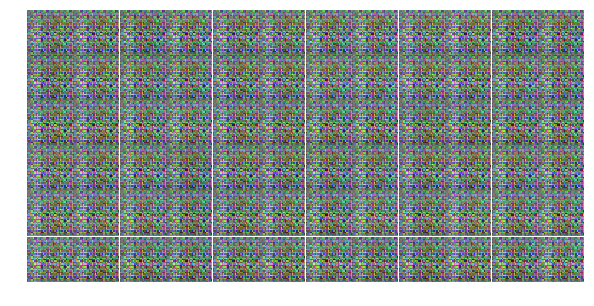

Epoch 1/25... Discriminator Loss: 0.7893... Generator Loss: 1.1272
Epoch 1/25... Discriminator Loss: 0.8722... Generator Loss: 1.0220
Epoch 1/25... Discriminator Loss: 0.6848... Generator Loss: 1.2292
Epoch 1/25... Discriminator Loss: 1.0644... Generator Loss: 1.1401
Epoch 1/25... Discriminator Loss: 1.4087... Generator Loss: 0.9785
Epoch 1/25... Discriminator Loss: 1.1720... Generator Loss: 1.0878
Epoch 1/25... Discriminator Loss: 1.0118... Generator Loss: 1.0583
Epoch 1/25... Discriminator Loss: 0.8587... Generator Loss: 1.4518
Epoch 1/25... Discriminator Loss: 0.7570... Generator Loss: 1.3470
Epoch 1/25... Discriminator Loss: 0.4193... Generator Loss: 1.7551


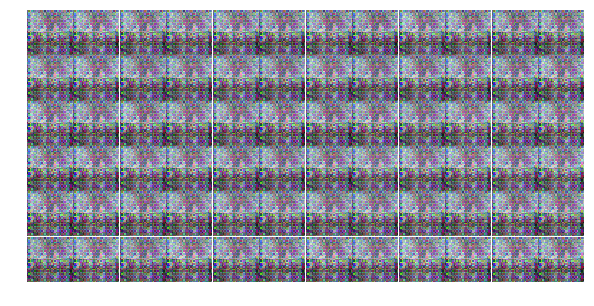

Epoch 1/25... Discriminator Loss: 0.5225... Generator Loss: 1.7103
Epoch 1/25... Discriminator Loss: 0.7500... Generator Loss: 1.2261
Epoch 1/25... Discriminator Loss: 1.2380... Generator Loss: 0.8229
Epoch 1/25... Discriminator Loss: 0.7930... Generator Loss: 1.3061
Epoch 1/25... Discriminator Loss: 0.7458... Generator Loss: 1.2957
Epoch 1/25... Discriminator Loss: 0.8214... Generator Loss: 1.1475
Epoch 1/25... Discriminator Loss: 0.5904... Generator Loss: 1.3674
Epoch 1/25... Discriminator Loss: 0.4696... Generator Loss: 1.3313
Epoch 1/25... Discriminator Loss: 0.5674... Generator Loss: 1.7793
Epoch 1/25... Discriminator Loss: 0.4312... Generator Loss: 1.9641


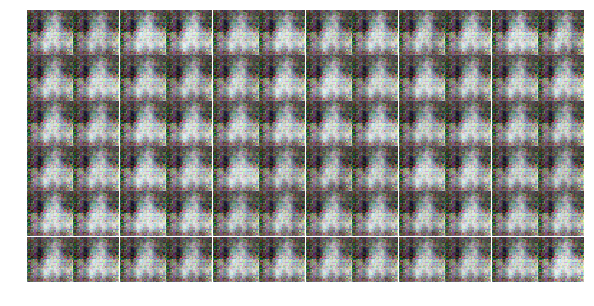

Epoch 1/25... Discriminator Loss: 0.6599... Generator Loss: 1.4902
Epoch 1/25... Discriminator Loss: 0.6904... Generator Loss: 1.3904
Epoch 1/25... Discriminator Loss: 0.8951... Generator Loss: 1.2841
Epoch 1/25... Discriminator Loss: 1.1882... Generator Loss: 0.8387
Epoch 1/25... Discriminator Loss: 0.9830... Generator Loss: 1.2148
Epoch 1/25... Discriminator Loss: 0.8103... Generator Loss: 1.4667
Epoch 1/25... Discriminator Loss: 1.0977... Generator Loss: 0.9858
Epoch 1/25... Discriminator Loss: 1.2536... Generator Loss: 0.8104
Epoch 1/25... Discriminator Loss: 1.3059... Generator Loss: 1.0104
Epoch 1/25... Discriminator Loss: 1.3001... Generator Loss: 0.8738


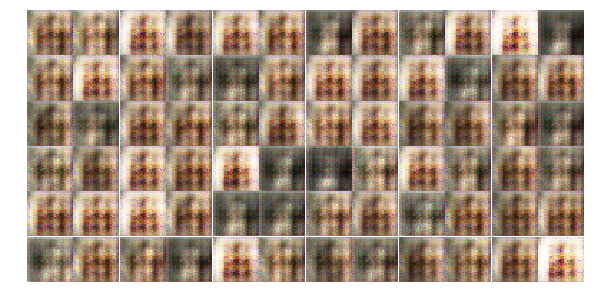

Epoch 1/25... Discriminator Loss: 1.2242... Generator Loss: 0.9142
Epoch 1/25... Discriminator Loss: 1.0463... Generator Loss: 1.0363
Epoch 1/25... Discriminator Loss: 1.5126... Generator Loss: 0.7354
Epoch 1/25... Discriminator Loss: 1.3009... Generator Loss: 0.8182
Epoch 1/25... Discriminator Loss: 1.2400... Generator Loss: 0.8221
Epoch 1/25... Discriminator Loss: 1.1233... Generator Loss: 0.8020
Epoch 1/25... Discriminator Loss: 1.0630... Generator Loss: 0.9730
Epoch 1/25... Discriminator Loss: 1.1728... Generator Loss: 0.8500
Epoch 1/25... Discriminator Loss: 1.3175... Generator Loss: 0.7775
Epoch 1/25... Discriminator Loss: 1.2131... Generator Loss: 0.8340


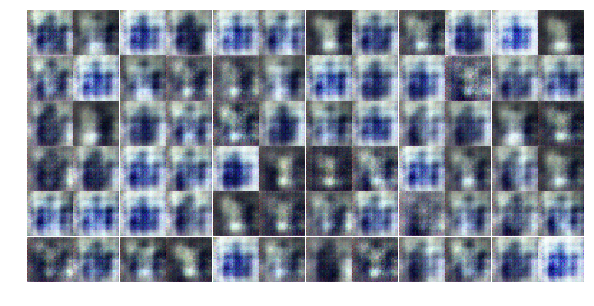

Epoch 1/25... Discriminator Loss: 1.0437... Generator Loss: 0.9554
Epoch 1/25... Discriminator Loss: 1.1114... Generator Loss: 0.9389
Epoch 1/25... Discriminator Loss: 1.0604... Generator Loss: 0.8838
Epoch 1/25... Discriminator Loss: 1.1187... Generator Loss: 0.9048
Epoch 1/25... Discriminator Loss: 1.1528... Generator Loss: 0.9221
Epoch 1/25... Discriminator Loss: 1.3952... Generator Loss: 0.7293
Epoch 1/25... Discriminator Loss: 0.9693... Generator Loss: 0.9841
Epoch 2/25... Discriminator Loss: 1.2681... Generator Loss: 0.8264
Epoch 2/25... Discriminator Loss: 1.1892... Generator Loss: 0.9041
Epoch 2/25... Discriminator Loss: 1.0113... Generator Loss: 0.9572


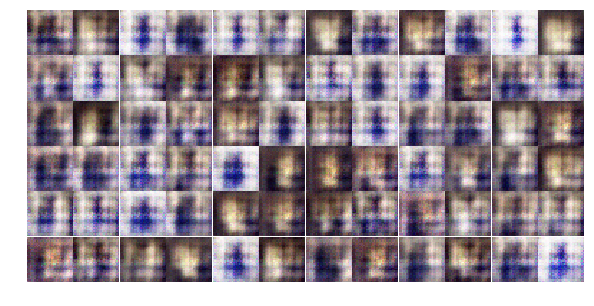

Epoch 2/25... Discriminator Loss: 1.1481... Generator Loss: 0.9473
Epoch 2/25... Discriminator Loss: 1.2042... Generator Loss: 0.8694
Epoch 2/25... Discriminator Loss: 1.3223... Generator Loss: 0.7951
Epoch 2/25... Discriminator Loss: 1.1370... Generator Loss: 0.8603
Epoch 2/25... Discriminator Loss: 1.3091... Generator Loss: 0.7809
Epoch 2/25... Discriminator Loss: 1.2302... Generator Loss: 0.9065
Epoch 2/25... Discriminator Loss: 1.1662... Generator Loss: 0.8555
Epoch 2/25... Discriminator Loss: 1.3528... Generator Loss: 0.8073
Epoch 2/25... Discriminator Loss: 1.2866... Generator Loss: 0.7193
Epoch 2/25... Discriminator Loss: 1.2676... Generator Loss: 0.7122


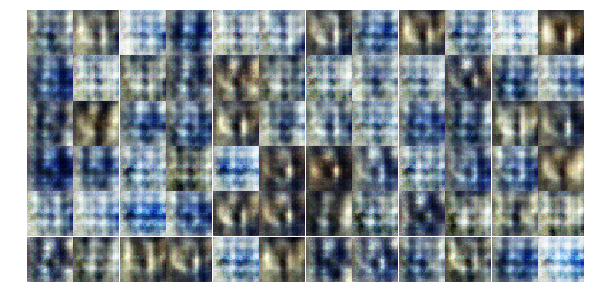

Epoch 2/25... Discriminator Loss: 1.4632... Generator Loss: 0.6536
Epoch 2/25... Discriminator Loss: 1.2780... Generator Loss: 0.7917
Epoch 2/25... Discriminator Loss: 1.3258... Generator Loss: 1.0482
Epoch 2/25... Discriminator Loss: 1.4341... Generator Loss: 0.6750
Epoch 2/25... Discriminator Loss: 1.3087... Generator Loss: 0.7549
Epoch 2/25... Discriminator Loss: 1.4730... Generator Loss: 0.7314
Epoch 2/25... Discriminator Loss: 1.2730... Generator Loss: 0.7584
Epoch 2/25... Discriminator Loss: 1.3786... Generator Loss: 0.6485
Epoch 2/25... Discriminator Loss: 1.2630... Generator Loss: 0.7886
Epoch 2/25... Discriminator Loss: 1.4906... Generator Loss: 0.7517


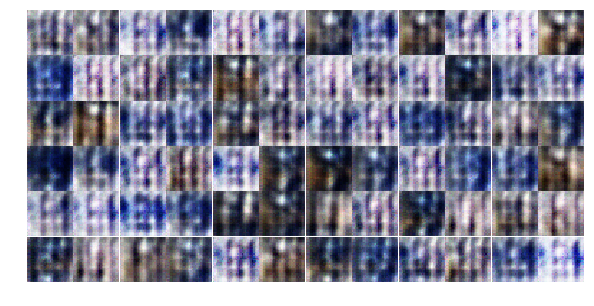

Epoch 2/25... Discriminator Loss: 1.1681... Generator Loss: 0.7992
Epoch 2/25... Discriminator Loss: 1.4174... Generator Loss: 0.6860
Epoch 2/25... Discriminator Loss: 1.3067... Generator Loss: 1.0170
Epoch 2/25... Discriminator Loss: 1.3125... Generator Loss: 1.0257
Epoch 2/25... Discriminator Loss: 1.3280... Generator Loss: 0.8932
Epoch 2/25... Discriminator Loss: 1.2245... Generator Loss: 0.8020
Epoch 2/25... Discriminator Loss: 1.0325... Generator Loss: 0.9643
Epoch 2/25... Discriminator Loss: 1.2500... Generator Loss: 0.6829
Epoch 2/25... Discriminator Loss: 1.1949... Generator Loss: 0.8356
Epoch 2/25... Discriminator Loss: 1.1463... Generator Loss: 0.7750


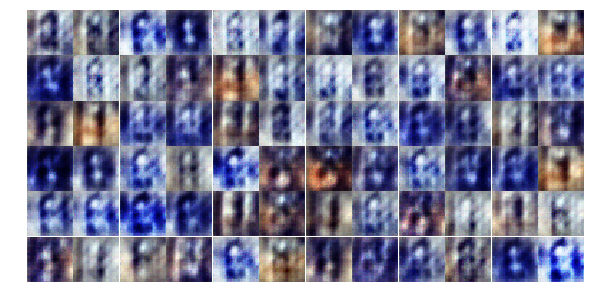

Epoch 2/25... Discriminator Loss: 1.2710... Generator Loss: 0.7724
Epoch 2/25... Discriminator Loss: 1.2925... Generator Loss: 0.8215
Epoch 2/25... Discriminator Loss: 1.2912... Generator Loss: 0.7825
Epoch 2/25... Discriminator Loss: 1.4763... Generator Loss: 0.5945
Epoch 2/25... Discriminator Loss: 1.3529... Generator Loss: 0.6866
Epoch 2/25... Discriminator Loss: 1.2116... Generator Loss: 0.8766
Epoch 2/25... Discriminator Loss: 1.2521... Generator Loss: 0.8752
Epoch 2/25... Discriminator Loss: 1.2405... Generator Loss: 0.7547
Epoch 2/25... Discriminator Loss: 1.5539... Generator Loss: 0.7054
Epoch 2/25... Discriminator Loss: 1.3384... Generator Loss: 0.8923


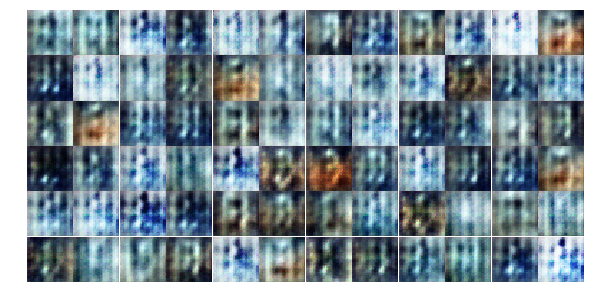

Epoch 2/25... Discriminator Loss: 1.2446... Generator Loss: 0.8626
Epoch 2/25... Discriminator Loss: 1.3215... Generator Loss: 0.7887
Epoch 2/25... Discriminator Loss: 1.2618... Generator Loss: 0.8892
Epoch 2/25... Discriminator Loss: 1.1970... Generator Loss: 0.9375
Epoch 2/25... Discriminator Loss: 1.3383... Generator Loss: 0.7593
Epoch 2/25... Discriminator Loss: 1.2683... Generator Loss: 0.8037
Epoch 2/25... Discriminator Loss: 1.2618... Generator Loss: 0.7025
Epoch 2/25... Discriminator Loss: 1.2334... Generator Loss: 0.7157
Epoch 2/25... Discriminator Loss: 1.2188... Generator Loss: 0.7471
Epoch 2/25... Discriminator Loss: 1.1094... Generator Loss: 0.9301


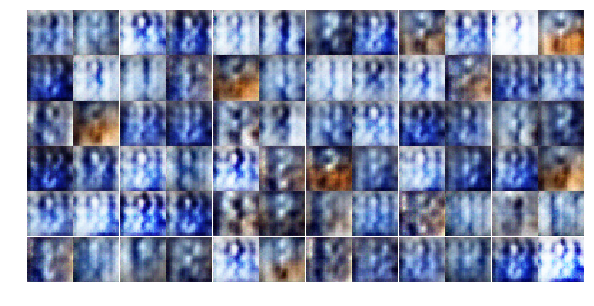

Epoch 2/25... Discriminator Loss: 1.3913... Generator Loss: 0.6879
Epoch 2/25... Discriminator Loss: 1.1364... Generator Loss: 0.9036
Epoch 2/25... Discriminator Loss: 1.3448... Generator Loss: 0.6987
Epoch 2/25... Discriminator Loss: 1.6633... Generator Loss: 0.6949
Epoch 3/25... Discriminator Loss: 1.2520... Generator Loss: 0.6707
Epoch 3/25... Discriminator Loss: 1.3183... Generator Loss: 0.7389
Epoch 3/25... Discriminator Loss: 1.4787... Generator Loss: 0.6761
Epoch 3/25... Discriminator Loss: 1.1667... Generator Loss: 0.8642
Epoch 3/25... Discriminator Loss: 1.3006... Generator Loss: 0.8006
Epoch 3/25... Discriminator Loss: 1.5064... Generator Loss: 0.6678


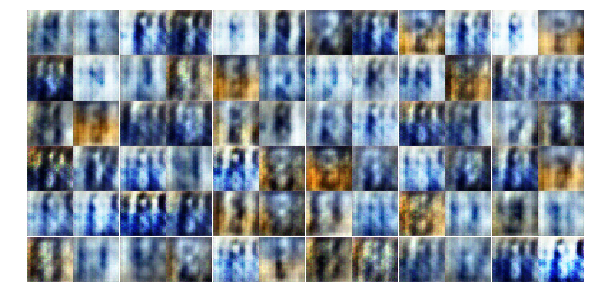

Epoch 3/25... Discriminator Loss: 1.4297... Generator Loss: 0.7599
Epoch 3/25... Discriminator Loss: 1.3870... Generator Loss: 0.8214
Epoch 3/25... Discriminator Loss: 1.5244... Generator Loss: 0.6550
Epoch 3/25... Discriminator Loss: 1.4770... Generator Loss: 0.6521
Epoch 3/25... Discriminator Loss: 1.3244... Generator Loss: 0.7448
Epoch 3/25... Discriminator Loss: 1.3458... Generator Loss: 0.7600
Epoch 3/25... Discriminator Loss: 1.3162... Generator Loss: 0.7618
Epoch 3/25... Discriminator Loss: 1.3480... Generator Loss: 0.7461
Epoch 3/25... Discriminator Loss: 1.2348... Generator Loss: 0.8415
Epoch 3/25... Discriminator Loss: 1.5667... Generator Loss: 0.6775


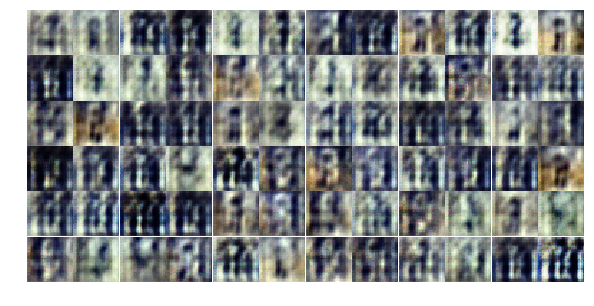

Epoch 3/25... Discriminator Loss: 1.4925... Generator Loss: 0.6490
Epoch 3/25... Discriminator Loss: 1.1979... Generator Loss: 0.8735
Epoch 3/25... Discriminator Loss: 1.3870... Generator Loss: 0.6917
Epoch 3/25... Discriminator Loss: 1.4031... Generator Loss: 0.7648
Epoch 3/25... Discriminator Loss: 1.3685... Generator Loss: 0.7748
Epoch 3/25... Discriminator Loss: 1.5246... Generator Loss: 0.6773
Epoch 3/25... Discriminator Loss: 1.4860... Generator Loss: 0.6630
Epoch 3/25... Discriminator Loss: 1.4264... Generator Loss: 0.6672
Epoch 3/25... Discriminator Loss: 1.2524... Generator Loss: 0.8232
Epoch 3/25... Discriminator Loss: 1.4009... Generator Loss: 0.7825


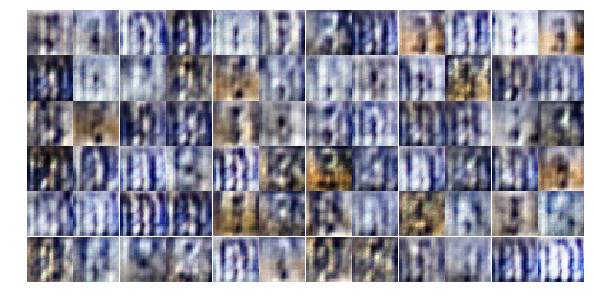

Epoch 3/25... Discriminator Loss: 1.3154... Generator Loss: 0.7526
Epoch 3/25... Discriminator Loss: 1.2935... Generator Loss: 0.7653
Epoch 3/25... Discriminator Loss: 1.4233... Generator Loss: 0.6804
Epoch 3/25... Discriminator Loss: 1.5536... Generator Loss: 0.6772
Epoch 3/25... Discriminator Loss: 1.3913... Generator Loss: 0.7241
Epoch 3/25... Discriminator Loss: 1.3423... Generator Loss: 0.7692
Epoch 3/25... Discriminator Loss: 1.4748... Generator Loss: 0.7152
Epoch 3/25... Discriminator Loss: 1.4231... Generator Loss: 0.7219
Epoch 3/25... Discriminator Loss: 1.4532... Generator Loss: 0.7031
Epoch 3/25... Discriminator Loss: 1.2317... Generator Loss: 0.7809


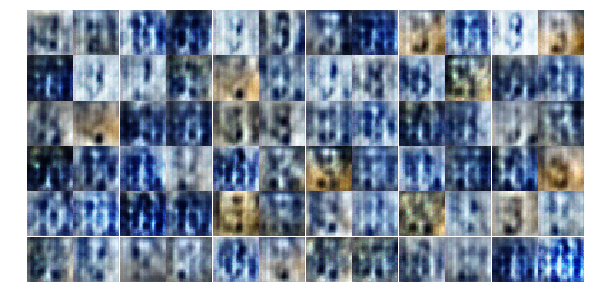

Epoch 3/25... Discriminator Loss: 1.3746... Generator Loss: 0.7108
Epoch 3/25... Discriminator Loss: 1.3821... Generator Loss: 0.6917
Epoch 3/25... Discriminator Loss: 1.3206... Generator Loss: 0.8096
Epoch 3/25... Discriminator Loss: 1.5429... Generator Loss: 0.6695
Epoch 3/25... Discriminator Loss: 1.4168... Generator Loss: 0.7212
Epoch 3/25... Discriminator Loss: 1.4718... Generator Loss: 0.6268
Epoch 3/25... Discriminator Loss: 1.2395... Generator Loss: 0.8456
Epoch 3/25... Discriminator Loss: 1.3483... Generator Loss: 0.7552
Epoch 3/25... Discriminator Loss: 1.3892... Generator Loss: 0.6860
Epoch 3/25... Discriminator Loss: 1.4488... Generator Loss: 0.6855


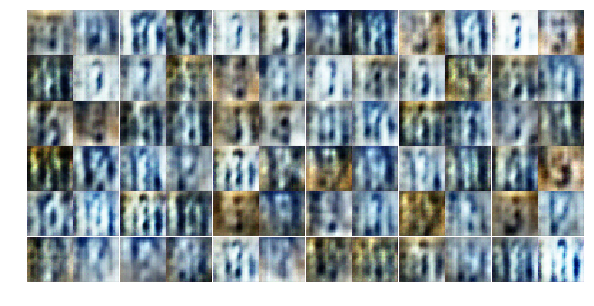

Epoch 3/25... Discriminator Loss: 1.5019... Generator Loss: 0.6098
Epoch 3/25... Discriminator Loss: 1.3772... Generator Loss: 0.6956
Epoch 3/25... Discriminator Loss: 1.4587... Generator Loss: 0.6822
Epoch 3/25... Discriminator Loss: 1.2021... Generator Loss: 0.8353
Epoch 3/25... Discriminator Loss: 1.2884... Generator Loss: 0.6740
Epoch 3/25... Discriminator Loss: 1.4659... Generator Loss: 0.6776
Epoch 3/25... Discriminator Loss: 1.4887... Generator Loss: 0.6858
Epoch 3/25... Discriminator Loss: 1.3484... Generator Loss: 0.8307
Epoch 3/25... Discriminator Loss: 1.3594... Generator Loss: 0.6912
Epoch 3/25... Discriminator Loss: 1.2928... Generator Loss: 0.8271


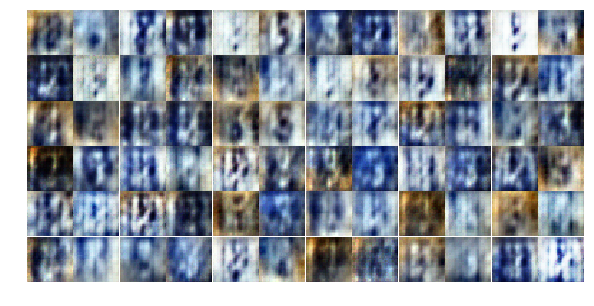

Epoch 3/25... Discriminator Loss: 1.6828... Generator Loss: 0.5543
Epoch 4/25... Discriminator Loss: 1.4273... Generator Loss: 0.7340
Epoch 4/25... Discriminator Loss: 1.2772... Generator Loss: 0.8273
Epoch 4/25... Discriminator Loss: 1.2384... Generator Loss: 0.7264
Epoch 4/25... Discriminator Loss: 1.4276... Generator Loss: 0.6495
Epoch 4/25... Discriminator Loss: 1.4229... Generator Loss: 0.7495
Epoch 4/25... Discriminator Loss: 1.2835... Generator Loss: 0.8077
Epoch 4/25... Discriminator Loss: 1.7197... Generator Loss: 0.5904
Epoch 4/25... Discriminator Loss: 1.5652... Generator Loss: 0.6579
Epoch 4/25... Discriminator Loss: 1.5138... Generator Loss: 0.6567


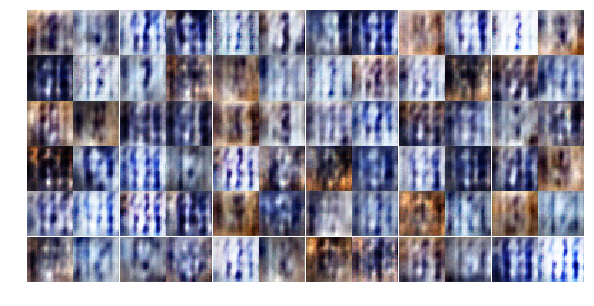

Epoch 4/25... Discriminator Loss: 1.3086... Generator Loss: 0.7606
Epoch 4/25... Discriminator Loss: 1.4291... Generator Loss: 0.6674
Epoch 4/25... Discriminator Loss: 1.3261... Generator Loss: 0.7955
Epoch 4/25... Discriminator Loss: 1.4076... Generator Loss: 0.6978
Epoch 4/25... Discriminator Loss: 1.2243... Generator Loss: 0.7499
Epoch 4/25... Discriminator Loss: 1.4701... Generator Loss: 0.6778
Epoch 4/25... Discriminator Loss: 1.4747... Generator Loss: 0.6840
Epoch 4/25... Discriminator Loss: 1.4212... Generator Loss: 0.7157
Epoch 4/25... Discriminator Loss: 1.3519... Generator Loss: 0.7664
Epoch 4/25... Discriminator Loss: 1.3024... Generator Loss: 0.7672


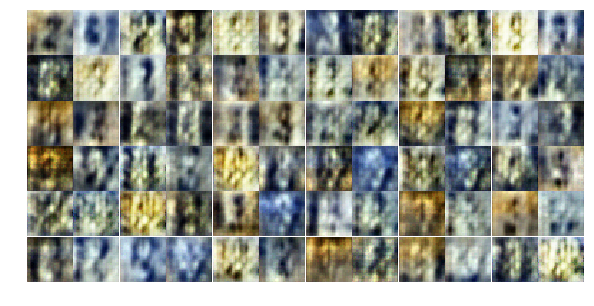

Epoch 4/25... Discriminator Loss: 1.3838... Generator Loss: 0.7652
Epoch 4/25... Discriminator Loss: 1.3995... Generator Loss: 0.7197
Epoch 4/25... Discriminator Loss: 1.2944... Generator Loss: 0.7154
Epoch 4/25... Discriminator Loss: 1.2673... Generator Loss: 0.7936
Epoch 4/25... Discriminator Loss: 1.2889... Generator Loss: 0.8053
Epoch 4/25... Discriminator Loss: 1.3541... Generator Loss: 0.7030
Epoch 4/25... Discriminator Loss: 1.4552... Generator Loss: 0.6460
Epoch 4/25... Discriminator Loss: 1.4233... Generator Loss: 0.6920
Epoch 4/25... Discriminator Loss: 1.5263... Generator Loss: 0.6316
Epoch 4/25... Discriminator Loss: 1.3712... Generator Loss: 0.7311


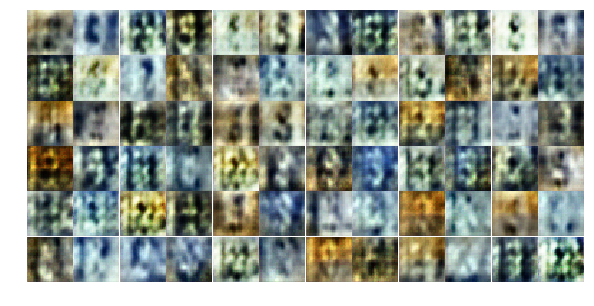

Epoch 4/25... Discriminator Loss: 1.3191... Generator Loss: 0.8158
Epoch 4/25... Discriminator Loss: 1.3406... Generator Loss: 0.7827
Epoch 4/25... Discriminator Loss: 1.2397... Generator Loss: 0.7856
Epoch 4/25... Discriminator Loss: 1.3106... Generator Loss: 0.8108
Epoch 4/25... Discriminator Loss: 1.4858... Generator Loss: 0.6926
Epoch 4/25... Discriminator Loss: 1.3890... Generator Loss: 0.7531
Epoch 4/25... Discriminator Loss: 1.4192... Generator Loss: 0.7028
Epoch 4/25... Discriminator Loss: 1.2230... Generator Loss: 0.8915
Epoch 4/25... Discriminator Loss: 1.4453... Generator Loss: 0.7337
Epoch 4/25... Discriminator Loss: 1.3956... Generator Loss: 0.6734


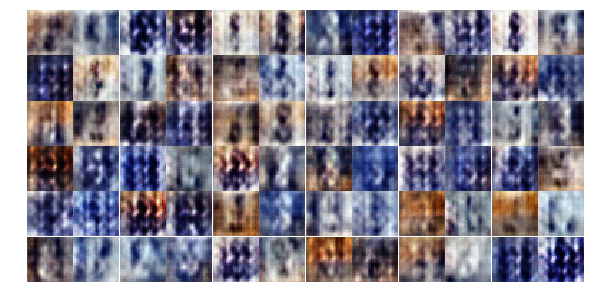

Epoch 4/25... Discriminator Loss: 1.3902... Generator Loss: 0.7727
Epoch 4/25... Discriminator Loss: 1.4314... Generator Loss: 0.7237
Epoch 4/25... Discriminator Loss: 1.6592... Generator Loss: 0.5465
Epoch 4/25... Discriminator Loss: 1.4421... Generator Loss: 0.6344
Epoch 4/25... Discriminator Loss: 1.3401... Generator Loss: 0.7784
Epoch 4/25... Discriminator Loss: 1.2982... Generator Loss: 0.7946
Epoch 4/25... Discriminator Loss: 1.2334... Generator Loss: 0.8384
Epoch 4/25... Discriminator Loss: 1.2618... Generator Loss: 0.7772
Epoch 4/25... Discriminator Loss: 1.4482... Generator Loss: 0.6916
Epoch 4/25... Discriminator Loss: 1.2542... Generator Loss: 0.9343


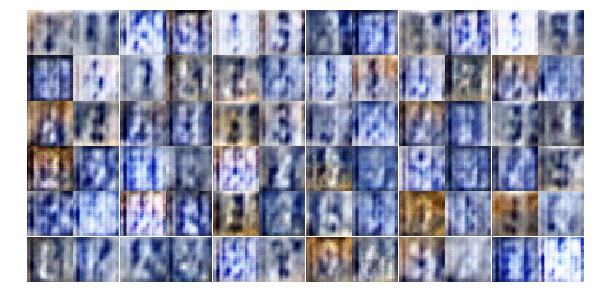

Epoch 4/25... Discriminator Loss: 1.3635... Generator Loss: 0.7654
Epoch 4/25... Discriminator Loss: 1.4441... Generator Loss: 0.6987
Epoch 4/25... Discriminator Loss: 1.5116... Generator Loss: 0.6732
Epoch 4/25... Discriminator Loss: 1.3042... Generator Loss: 0.7551
Epoch 4/25... Discriminator Loss: 1.4309... Generator Loss: 0.6872
Epoch 4/25... Discriminator Loss: 1.3447... Generator Loss: 0.7156
Epoch 4/25... Discriminator Loss: 1.4406... Generator Loss: 0.7005
Epoch 4/25... Discriminator Loss: 1.3188... Generator Loss: 0.7394
Epoch 4/25... Discriminator Loss: 1.3292... Generator Loss: 0.7197
Epoch 5/25... Discriminator Loss: 1.3726... Generator Loss: 0.7859


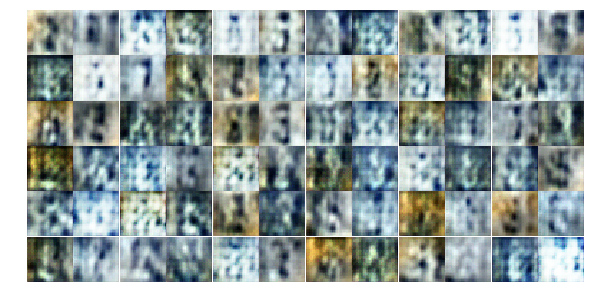

Epoch 5/25... Discriminator Loss: 1.4573... Generator Loss: 0.6018
Epoch 5/25... Discriminator Loss: 1.4168... Generator Loss: 0.6746
Epoch 5/25... Discriminator Loss: 1.2700... Generator Loss: 0.8224
Epoch 5/25... Discriminator Loss: 1.1668... Generator Loss: 0.8275
Epoch 5/25... Discriminator Loss: 1.4459... Generator Loss: 0.6984
Epoch 5/25... Discriminator Loss: 1.4216... Generator Loss: 0.6614
Epoch 5/25... Discriminator Loss: 1.3738... Generator Loss: 0.7158
Epoch 5/25... Discriminator Loss: 1.4265... Generator Loss: 0.6908
Epoch 5/25... Discriminator Loss: 1.1890... Generator Loss: 0.8512
Epoch 5/25... Discriminator Loss: 1.1858... Generator Loss: 0.8343


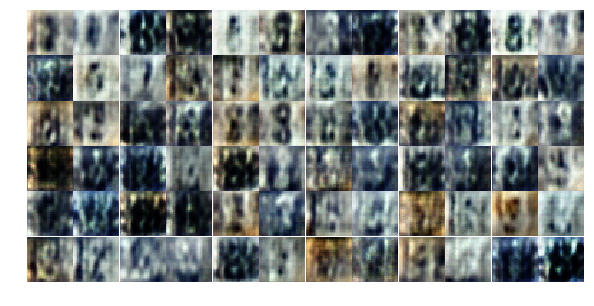

Epoch 5/25... Discriminator Loss: 1.1598... Generator Loss: 0.9051
Epoch 5/25... Discriminator Loss: 1.1890... Generator Loss: 0.8694
Epoch 5/25... Discriminator Loss: 1.5004... Generator Loss: 0.6507
Epoch 5/25... Discriminator Loss: 1.5926... Generator Loss: 0.6076
Epoch 5/25... Discriminator Loss: 1.4113... Generator Loss: 0.7103
Epoch 5/25... Discriminator Loss: 1.4205... Generator Loss: 0.7130
Epoch 5/25... Discriminator Loss: 1.2555... Generator Loss: 0.7629
Epoch 5/25... Discriminator Loss: 1.3702... Generator Loss: 0.7944
Epoch 5/25... Discriminator Loss: 1.5701... Generator Loss: 0.5241
Epoch 5/25... Discriminator Loss: 1.4333... Generator Loss: 0.7019


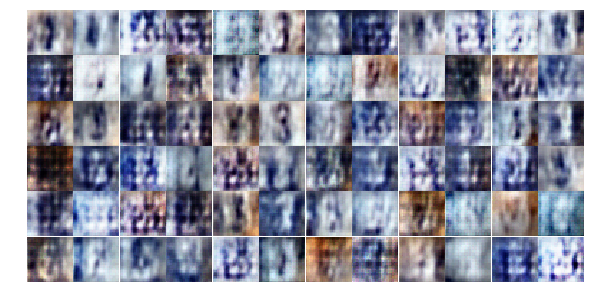

Epoch 5/25... Discriminator Loss: 1.4375... Generator Loss: 0.6667
Epoch 5/25... Discriminator Loss: 1.3007... Generator Loss: 0.7739
Epoch 5/25... Discriminator Loss: 1.2792... Generator Loss: 0.8490
Epoch 5/25... Discriminator Loss: 1.2682... Generator Loss: 0.7957
Epoch 5/25... Discriminator Loss: 1.3869... Generator Loss: 0.7354
Epoch 5/25... Discriminator Loss: 1.2868... Generator Loss: 0.8059
Epoch 5/25... Discriminator Loss: 1.3989... Generator Loss: 0.7010
Epoch 5/25... Discriminator Loss: 1.5216... Generator Loss: 0.6312
Epoch 5/25... Discriminator Loss: 1.1865... Generator Loss: 0.8723
Epoch 5/25... Discriminator Loss: 1.3314... Generator Loss: 0.7120


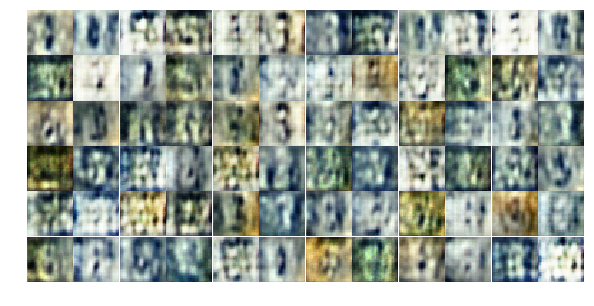

Epoch 5/25... Discriminator Loss: 1.3858... Generator Loss: 0.6476
Epoch 5/25... Discriminator Loss: 1.4279... Generator Loss: 0.7730
Epoch 5/25... Discriminator Loss: 1.2525... Generator Loss: 0.7622
Epoch 5/25... Discriminator Loss: 1.3851... Generator Loss: 0.6847
Epoch 5/25... Discriminator Loss: 1.5445... Generator Loss: 0.6006
Epoch 5/25... Discriminator Loss: 1.2462... Generator Loss: 0.7888
Epoch 5/25... Discriminator Loss: 1.5652... Generator Loss: 0.6114
Epoch 5/25... Discriminator Loss: 1.4001... Generator Loss: 0.7182
Epoch 5/25... Discriminator Loss: 1.3978... Generator Loss: 0.6712
Epoch 5/25... Discriminator Loss: 1.3061... Generator Loss: 0.7683


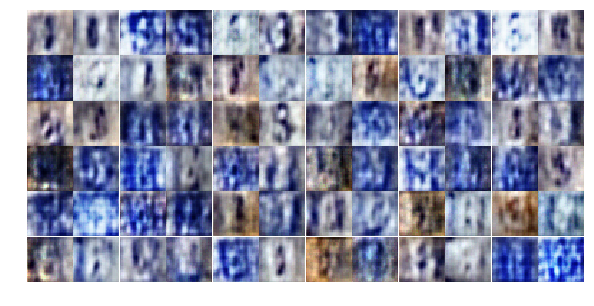

Epoch 5/25... Discriminator Loss: 1.3942... Generator Loss: 0.7236
Epoch 5/25... Discriminator Loss: 1.2127... Generator Loss: 0.7993
Epoch 5/25... Discriminator Loss: 1.3453... Generator Loss: 0.7501
Epoch 5/25... Discriminator Loss: 1.2949... Generator Loss: 0.8269
Epoch 5/25... Discriminator Loss: 1.2537... Generator Loss: 0.8168
Epoch 5/25... Discriminator Loss: 1.5486... Generator Loss: 0.6418
Epoch 5/25... Discriminator Loss: 1.4849... Generator Loss: 0.6795
Epoch 5/25... Discriminator Loss: 1.3773... Generator Loss: 0.7032
Epoch 5/25... Discriminator Loss: 1.3778... Generator Loss: 0.6774
Epoch 5/25... Discriminator Loss: 1.3296... Generator Loss: 0.7538


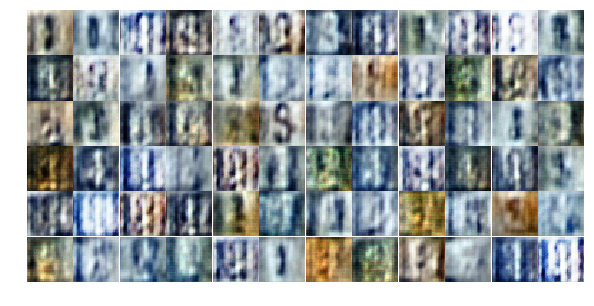

Epoch 5/25... Discriminator Loss: 1.3420... Generator Loss: 0.7947
Epoch 5/25... Discriminator Loss: 1.3841... Generator Loss: 0.7375
Epoch 5/25... Discriminator Loss: 1.5816... Generator Loss: 0.6717
Epoch 5/25... Discriminator Loss: 1.2910... Generator Loss: 0.7451
Epoch 5/25... Discriminator Loss: 1.3512... Generator Loss: 0.7539
Epoch 5/25... Discriminator Loss: 1.4614... Generator Loss: 0.6805
Epoch 6/25... Discriminator Loss: 1.3053... Generator Loss: 0.7508
Epoch 6/25... Discriminator Loss: 1.3697... Generator Loss: 0.7095
Epoch 6/25... Discriminator Loss: 1.2042... Generator Loss: 0.8340
Epoch 6/25... Discriminator Loss: 1.3790... Generator Loss: 0.7009


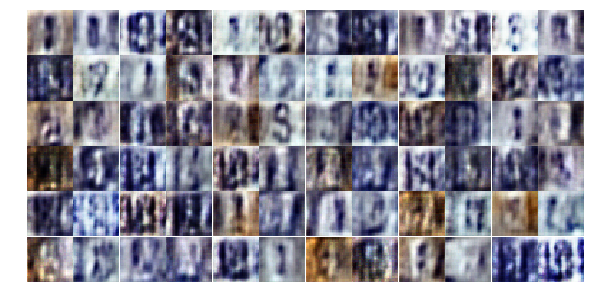

Epoch 6/25... Discriminator Loss: 1.3525... Generator Loss: 0.7590
Epoch 6/25... Discriminator Loss: 1.3950... Generator Loss: 0.7033
Epoch 6/25... Discriminator Loss: 1.3219... Generator Loss: 0.7320
Epoch 6/25... Discriminator Loss: 1.4528... Generator Loss: 0.7318
Epoch 6/25... Discriminator Loss: 1.2630... Generator Loss: 0.7808
Epoch 6/25... Discriminator Loss: 1.3140... Generator Loss: 0.7804
Epoch 6/25... Discriminator Loss: 1.3194... Generator Loss: 0.7270
Epoch 6/25... Discriminator Loss: 1.4302... Generator Loss: 0.6653
Epoch 6/25... Discriminator Loss: 1.2432... Generator Loss: 0.8756
Epoch 6/25... Discriminator Loss: 1.1978... Generator Loss: 0.8249


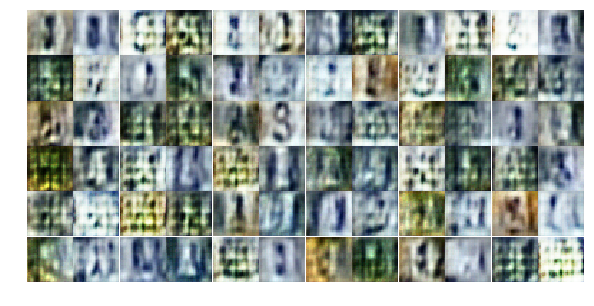

Epoch 6/25... Discriminator Loss: 1.3549... Generator Loss: 0.7393
Epoch 6/25... Discriminator Loss: 1.4347... Generator Loss: 0.6523
Epoch 6/25... Discriminator Loss: 1.4578... Generator Loss: 0.6643
Epoch 6/25... Discriminator Loss: 1.2000... Generator Loss: 0.8017
Epoch 6/25... Discriminator Loss: 1.5835... Generator Loss: 0.6127
Epoch 6/25... Discriminator Loss: 1.3226... Generator Loss: 0.7928
Epoch 6/25... Discriminator Loss: 1.3466... Generator Loss: 0.7263
Epoch 6/25... Discriminator Loss: 1.4941... Generator Loss: 0.6938
Epoch 6/25... Discriminator Loss: 1.2600... Generator Loss: 0.7788
Epoch 6/25... Discriminator Loss: 1.4615... Generator Loss: 0.6263


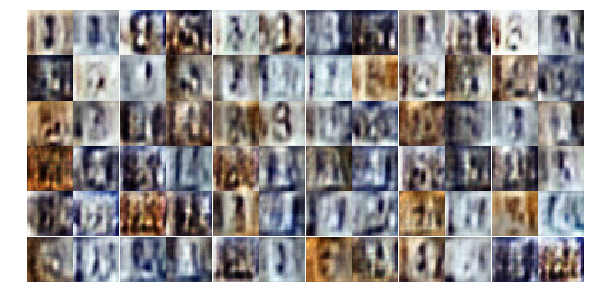

Epoch 6/25... Discriminator Loss: 1.3251... Generator Loss: 0.7117
Epoch 6/25... Discriminator Loss: 1.2409... Generator Loss: 0.7822
Epoch 6/25... Discriminator Loss: 1.3643... Generator Loss: 0.6713
Epoch 6/25... Discriminator Loss: 1.3931... Generator Loss: 0.6956
Epoch 6/25... Discriminator Loss: 1.4144... Generator Loss: 0.7786
Epoch 6/25... Discriminator Loss: 1.4544... Generator Loss: 0.6190
Epoch 6/25... Discriminator Loss: 1.3483... Generator Loss: 0.6977
Epoch 6/25... Discriminator Loss: 1.5205... Generator Loss: 0.6461
Epoch 6/25... Discriminator Loss: 1.3604... Generator Loss: 0.7042
Epoch 6/25... Discriminator Loss: 1.2293... Generator Loss: 0.8694


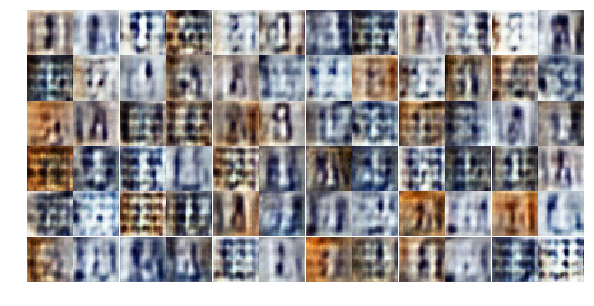

Epoch 6/25... Discriminator Loss: 1.3968... Generator Loss: 0.7171
Epoch 6/25... Discriminator Loss: 1.4072... Generator Loss: 0.6556
Epoch 6/25... Discriminator Loss: 1.4030... Generator Loss: 0.6772
Epoch 6/25... Discriminator Loss: 1.3383... Generator Loss: 0.8085
Epoch 6/25... Discriminator Loss: 1.2002... Generator Loss: 0.8349
Epoch 6/25... Discriminator Loss: 1.2946... Generator Loss: 0.6770
Epoch 6/25... Discriminator Loss: 1.3663... Generator Loss: 0.7356
Epoch 6/25... Discriminator Loss: 1.4850... Generator Loss: 0.6590
Epoch 6/25... Discriminator Loss: 1.2649... Generator Loss: 0.8611
Epoch 6/25... Discriminator Loss: 1.4418... Generator Loss: 0.7151


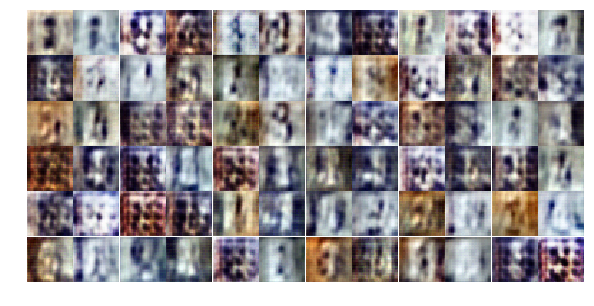

Epoch 6/25... Discriminator Loss: 1.4062... Generator Loss: 0.7351
Epoch 6/25... Discriminator Loss: 1.2843... Generator Loss: 0.8087
Epoch 6/25... Discriminator Loss: 1.3285... Generator Loss: 0.7420
Epoch 6/25... Discriminator Loss: 1.4315... Generator Loss: 0.6495
Epoch 6/25... Discriminator Loss: 1.1620... Generator Loss: 0.7875
Epoch 6/25... Discriminator Loss: 1.2883... Generator Loss: 0.8307
Epoch 6/25... Discriminator Loss: 1.3400... Generator Loss: 0.9033
Epoch 6/25... Discriminator Loss: 1.3687... Generator Loss: 0.5901
Epoch 6/25... Discriminator Loss: 1.4018... Generator Loss: 0.6772
Epoch 6/25... Discriminator Loss: 1.4666... Generator Loss: 0.6202


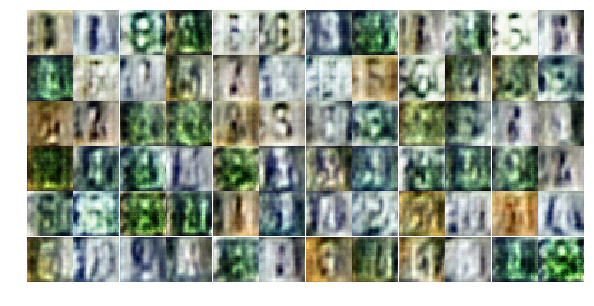

Epoch 6/25... Discriminator Loss: 1.3692... Generator Loss: 0.5919
Epoch 6/25... Discriminator Loss: 1.4003... Generator Loss: 0.5830
Epoch 6/25... Discriminator Loss: 1.3621... Generator Loss: 0.7052
Epoch 7/25... Discriminator Loss: 1.2822... Generator Loss: 0.8252
Epoch 7/25... Discriminator Loss: 1.2761... Generator Loss: 0.8034
Epoch 7/25... Discriminator Loss: 1.2862... Generator Loss: 0.8811
Epoch 7/25... Discriminator Loss: 1.5105... Generator Loss: 0.6288
Epoch 7/25... Discriminator Loss: 1.3588... Generator Loss: 0.7359
Epoch 7/25... Discriminator Loss: 1.2828... Generator Loss: 0.6809
Epoch 7/25... Discriminator Loss: 1.3709... Generator Loss: 0.7685


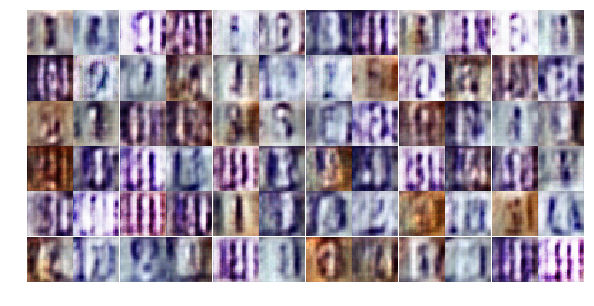

Epoch 7/25... Discriminator Loss: 1.3777... Generator Loss: 0.7058
Epoch 7/25... Discriminator Loss: 1.2449... Generator Loss: 0.7929
Epoch 7/25... Discriminator Loss: 1.3383... Generator Loss: 0.6679
Epoch 7/25... Discriminator Loss: 1.2755... Generator Loss: 0.7594
Epoch 7/25... Discriminator Loss: 1.5215... Generator Loss: 0.6431
Epoch 7/25... Discriminator Loss: 1.1838... Generator Loss: 0.8575
Epoch 7/25... Discriminator Loss: 1.3612... Generator Loss: 0.7320
Epoch 7/25... Discriminator Loss: 1.3082... Generator Loss: 0.7085
Epoch 7/25... Discriminator Loss: 1.3278... Generator Loss: 0.8191
Epoch 7/25... Discriminator Loss: 1.1440... Generator Loss: 0.9909


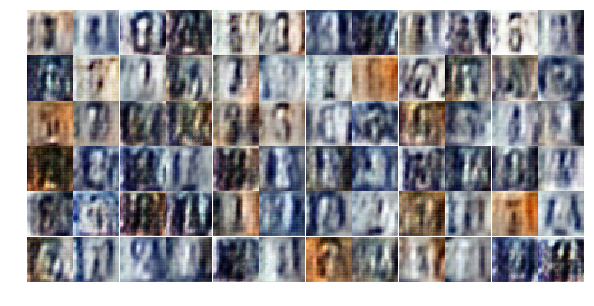

Epoch 7/25... Discriminator Loss: 1.3148... Generator Loss: 0.7435
Epoch 7/25... Discriminator Loss: 1.3046... Generator Loss: 0.7914
Epoch 7/25... Discriminator Loss: 1.3213... Generator Loss: 0.7405
Epoch 7/25... Discriminator Loss: 1.3215... Generator Loss: 0.8596
Epoch 7/25... Discriminator Loss: 1.2772... Generator Loss: 0.8281
Epoch 7/25... Discriminator Loss: 1.2308... Generator Loss: 0.8181
Epoch 7/25... Discriminator Loss: 1.2313... Generator Loss: 0.8196
Epoch 7/25... Discriminator Loss: 1.3468... Generator Loss: 0.6336
Epoch 7/25... Discriminator Loss: 1.4049... Generator Loss: 0.7014
Epoch 7/25... Discriminator Loss: 1.3137... Generator Loss: 0.7802


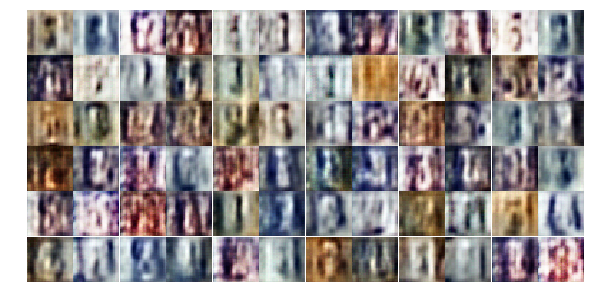

Epoch 7/25... Discriminator Loss: 1.3177... Generator Loss: 0.7904
Epoch 7/25... Discriminator Loss: 1.2489... Generator Loss: 0.8387
Epoch 7/25... Discriminator Loss: 1.3668... Generator Loss: 0.7290
Epoch 7/25... Discriminator Loss: 1.0717... Generator Loss: 0.8874
Epoch 7/25... Discriminator Loss: 1.2496... Generator Loss: 0.7759
Epoch 7/25... Discriminator Loss: 1.2632... Generator Loss: 0.7791
Epoch 7/25... Discriminator Loss: 1.6334... Generator Loss: 0.5989
Epoch 7/25... Discriminator Loss: 1.2677... Generator Loss: 0.7978
Epoch 7/25... Discriminator Loss: 1.3149... Generator Loss: 0.7474
Epoch 7/25... Discriminator Loss: 1.5132... Generator Loss: 0.6301


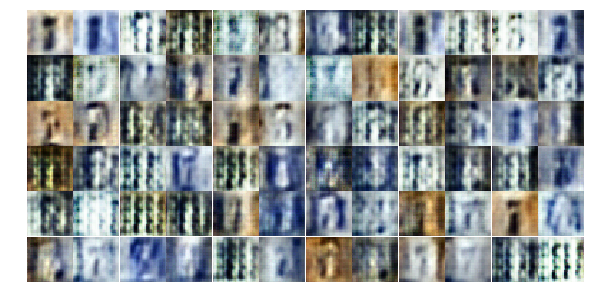

Epoch 7/25... Discriminator Loss: 1.3423... Generator Loss: 0.7835
Epoch 7/25... Discriminator Loss: 1.3039... Generator Loss: 0.7156
Epoch 7/25... Discriminator Loss: 1.3035... Generator Loss: 0.7854
Epoch 7/25... Discriminator Loss: 1.3822... Generator Loss: 0.6581
Epoch 7/25... Discriminator Loss: 1.2735... Generator Loss: 0.7979
Epoch 7/25... Discriminator Loss: 1.2827... Generator Loss: 0.7525
Epoch 7/25... Discriminator Loss: 1.2236... Generator Loss: 0.9173
Epoch 7/25... Discriminator Loss: 1.3033... Generator Loss: 0.8389
Epoch 7/25... Discriminator Loss: 1.2919... Generator Loss: 0.9598
Epoch 7/25... Discriminator Loss: 1.2909... Generator Loss: 0.7793


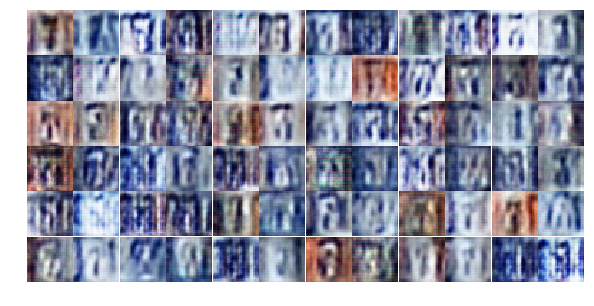

Epoch 7/25... Discriminator Loss: 1.2762... Generator Loss: 0.7863
Epoch 7/25... Discriminator Loss: 1.4246... Generator Loss: 0.8067
Epoch 7/25... Discriminator Loss: 1.2660... Generator Loss: 0.7920
Epoch 7/25... Discriminator Loss: 1.3402... Generator Loss: 0.7014
Epoch 7/25... Discriminator Loss: 1.2541... Generator Loss: 0.8098
Epoch 7/25... Discriminator Loss: 1.3200... Generator Loss: 0.7688
Epoch 7/25... Discriminator Loss: 1.0687... Generator Loss: 0.9744
Epoch 7/25... Discriminator Loss: 1.4033... Generator Loss: 0.6862
Epoch 7/25... Discriminator Loss: 1.4012... Generator Loss: 0.7537
Epoch 7/25... Discriminator Loss: 1.0793... Generator Loss: 1.0146


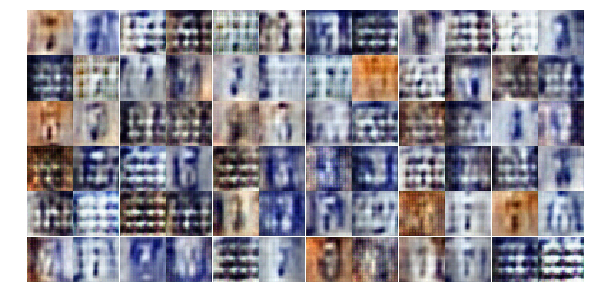

Epoch 7/25... Discriminator Loss: 1.1963... Generator Loss: 0.9824
Epoch 8/25... Discriminator Loss: 1.4680... Generator Loss: 0.6753
Epoch 8/25... Discriminator Loss: 1.1378... Generator Loss: 0.8165
Epoch 8/25... Discriminator Loss: 1.5664... Generator Loss: 0.7044
Epoch 8/25... Discriminator Loss: 1.3849... Generator Loss: 0.7482
Epoch 8/25... Discriminator Loss: 1.2314... Generator Loss: 0.7821
Epoch 8/25... Discriminator Loss: 1.3896... Generator Loss: 0.7241
Epoch 8/25... Discriminator Loss: 1.3284... Generator Loss: 0.7579
Epoch 8/25... Discriminator Loss: 1.1606... Generator Loss: 0.8491
Epoch 8/25... Discriminator Loss: 1.2434... Generator Loss: 0.7671


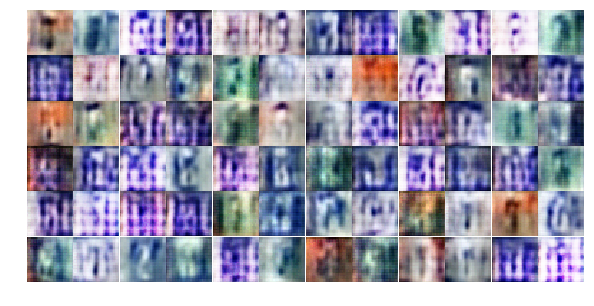

Epoch 8/25... Discriminator Loss: 1.1865... Generator Loss: 0.8686
Epoch 8/25... Discriminator Loss: 1.3005... Generator Loss: 0.7261
Epoch 8/25... Discriminator Loss: 1.2831... Generator Loss: 0.8427
Epoch 8/25... Discriminator Loss: 1.2270... Generator Loss: 0.8818
Epoch 8/25... Discriminator Loss: 1.1813... Generator Loss: 0.8791
Epoch 8/25... Discriminator Loss: 1.2782... Generator Loss: 0.7756
Epoch 8/25... Discriminator Loss: 1.3033... Generator Loss: 0.6993
Epoch 8/25... Discriminator Loss: 1.2799... Generator Loss: 0.8511
Epoch 8/25... Discriminator Loss: 1.2735... Generator Loss: 0.7657
Epoch 8/25... Discriminator Loss: 1.3004... Generator Loss: 0.7659


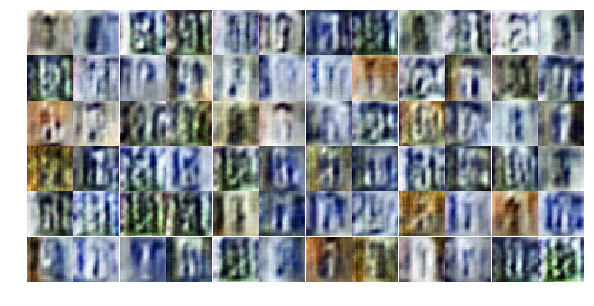

Epoch 8/25... Discriminator Loss: 1.3049... Generator Loss: 0.9188
Epoch 8/25... Discriminator Loss: 1.1341... Generator Loss: 0.9498
Epoch 8/25... Discriminator Loss: 1.4084... Generator Loss: 0.6391
Epoch 8/25... Discriminator Loss: 1.3896... Generator Loss: 0.6973
Epoch 8/25... Discriminator Loss: 1.3659... Generator Loss: 0.7612
Epoch 8/25... Discriminator Loss: 1.3506... Generator Loss: 0.8137
Epoch 8/25... Discriminator Loss: 1.2957... Generator Loss: 0.6900
Epoch 8/25... Discriminator Loss: 1.2696... Generator Loss: 0.9309
Epoch 8/25... Discriminator Loss: 1.2209... Generator Loss: 0.8214
Epoch 8/25... Discriminator Loss: 1.2716... Generator Loss: 0.7873


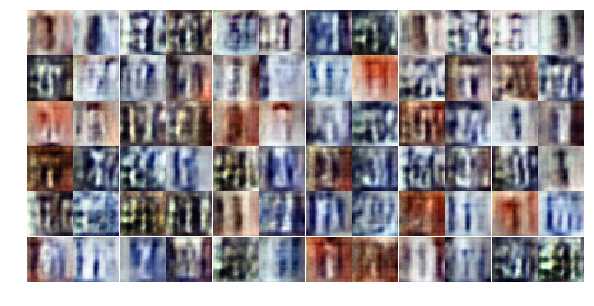

Epoch 8/25... Discriminator Loss: 1.2547... Generator Loss: 0.7551
Epoch 8/25... Discriminator Loss: 1.2081... Generator Loss: 0.8491
Epoch 8/25... Discriminator Loss: 1.5016... Generator Loss: 0.5818
Epoch 8/25... Discriminator Loss: 1.1891... Generator Loss: 0.7692
Epoch 8/25... Discriminator Loss: 1.2085... Generator Loss: 0.7913
Epoch 8/25... Discriminator Loss: 1.0185... Generator Loss: 0.9169
Epoch 8/25... Discriminator Loss: 1.1819... Generator Loss: 0.9024
Epoch 8/25... Discriminator Loss: 1.2775... Generator Loss: 0.7847
Epoch 8/25... Discriminator Loss: 1.3597... Generator Loss: 0.7985
Epoch 8/25... Discriminator Loss: 1.2758... Generator Loss: 0.7371


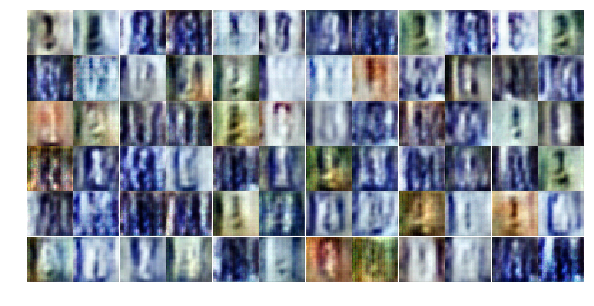

Epoch 8/25... Discriminator Loss: 1.2841... Generator Loss: 0.8031
Epoch 8/25... Discriminator Loss: 1.3796... Generator Loss: 0.6865
Epoch 8/25... Discriminator Loss: 1.0909... Generator Loss: 0.9338
Epoch 8/25... Discriminator Loss: 1.2761... Generator Loss: 0.7792
Epoch 8/25... Discriminator Loss: 1.3526... Generator Loss: 0.8255
Epoch 8/25... Discriminator Loss: 1.2506... Generator Loss: 0.7617
Epoch 8/25... Discriminator Loss: 1.2940... Generator Loss: 0.6735
Epoch 8/25... Discriminator Loss: 1.4089... Generator Loss: 0.6347
Epoch 8/25... Discriminator Loss: 1.2938... Generator Loss: 0.6746
Epoch 8/25... Discriminator Loss: 1.3376... Generator Loss: 0.7902


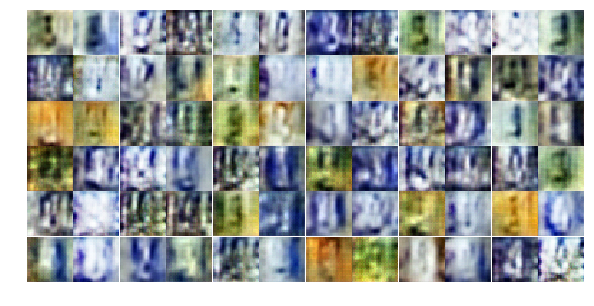

Epoch 8/25... Discriminator Loss: 1.3667... Generator Loss: 0.7262
Epoch 8/25... Discriminator Loss: 1.1941... Generator Loss: 0.8800
Epoch 8/25... Discriminator Loss: 1.2678... Generator Loss: 0.7698
Epoch 8/25... Discriminator Loss: 1.3856... Generator Loss: 0.6555
Epoch 8/25... Discriminator Loss: 1.3248... Generator Loss: 0.7427
Epoch 8/25... Discriminator Loss: 1.3204... Generator Loss: 0.6978
Epoch 8/25... Discriminator Loss: 1.2350... Generator Loss: 0.7944
Epoch 8/25... Discriminator Loss: 1.2472... Generator Loss: 0.7570
Epoch 9/25... Discriminator Loss: 1.4499... Generator Loss: 0.5538
Epoch 9/25... Discriminator Loss: 1.2738... Generator Loss: 0.7797


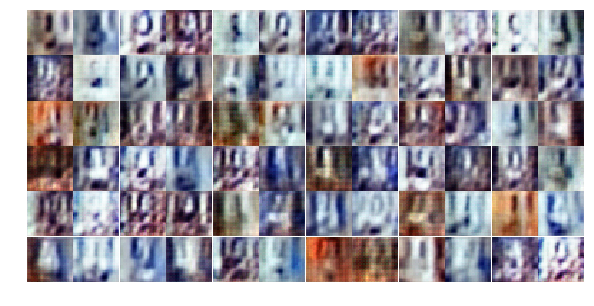

Epoch 9/25... Discriminator Loss: 1.2163... Generator Loss: 0.8200
Epoch 9/25... Discriminator Loss: 1.3214... Generator Loss: 0.7339
Epoch 9/25... Discriminator Loss: 1.2021... Generator Loss: 0.7738
Epoch 9/25... Discriminator Loss: 1.3211... Generator Loss: 0.8037
Epoch 9/25... Discriminator Loss: 1.4415... Generator Loss: 0.6830
Epoch 9/25... Discriminator Loss: 1.3062... Generator Loss: 0.7664
Epoch 9/25... Discriminator Loss: 1.3308... Generator Loss: 0.7657
Epoch 9/25... Discriminator Loss: 1.2456... Generator Loss: 0.8611
Epoch 9/25... Discriminator Loss: 1.3675... Generator Loss: 0.6699
Epoch 9/25... Discriminator Loss: 1.1671... Generator Loss: 0.8824


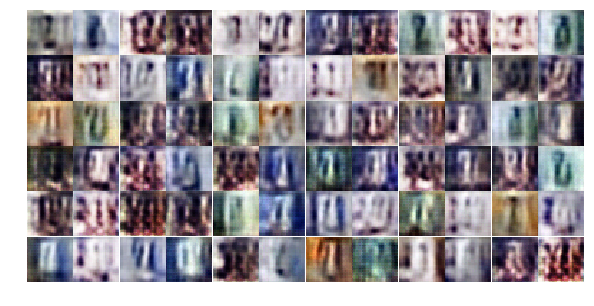

Epoch 9/25... Discriminator Loss: 1.2653... Generator Loss: 0.7087
Epoch 9/25... Discriminator Loss: 1.4301... Generator Loss: 0.6899
Epoch 9/25... Discriminator Loss: 1.2321... Generator Loss: 0.8659
Epoch 9/25... Discriminator Loss: 1.0230... Generator Loss: 1.1133
Epoch 9/25... Discriminator Loss: 1.2244... Generator Loss: 0.7715
Epoch 9/25... Discriminator Loss: 1.3386... Generator Loss: 0.7909
Epoch 9/25... Discriminator Loss: 1.2973... Generator Loss: 0.7469
Epoch 9/25... Discriminator Loss: 1.2007... Generator Loss: 0.8318
Epoch 9/25... Discriminator Loss: 1.1907... Generator Loss: 0.9378
Epoch 9/25... Discriminator Loss: 1.1756... Generator Loss: 0.7642


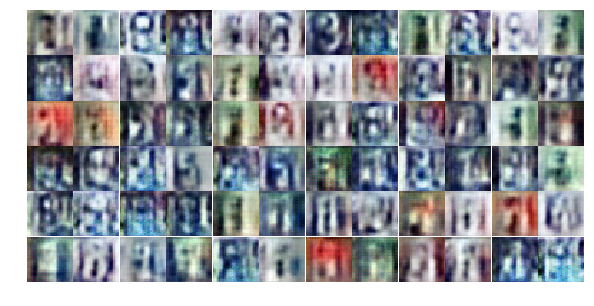

Epoch 9/25... Discriminator Loss: 1.1083... Generator Loss: 1.0327
Epoch 9/25... Discriminator Loss: 1.2723... Generator Loss: 0.7713
Epoch 9/25... Discriminator Loss: 1.4650... Generator Loss: 0.6762
Epoch 9/25... Discriminator Loss: 1.3581... Generator Loss: 0.9740
Epoch 9/25... Discriminator Loss: 1.1579... Generator Loss: 0.8864
Epoch 9/25... Discriminator Loss: 1.1958... Generator Loss: 0.7563
Epoch 9/25... Discriminator Loss: 1.2947... Generator Loss: 0.7808
Epoch 9/25... Discriminator Loss: 1.1962... Generator Loss: 0.8607
Epoch 9/25... Discriminator Loss: 1.3241... Generator Loss: 0.7817
Epoch 9/25... Discriminator Loss: 0.9991... Generator Loss: 0.9812


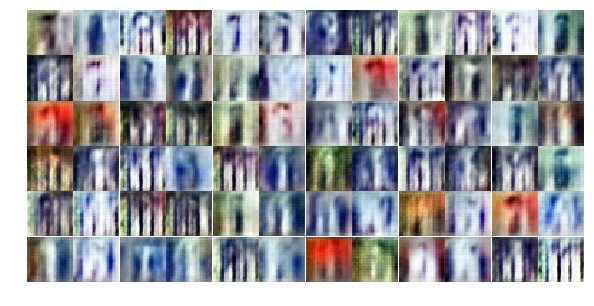

Epoch 9/25... Discriminator Loss: 1.3181... Generator Loss: 0.7392
Epoch 9/25... Discriminator Loss: 1.3546... Generator Loss: 0.8061
Epoch 9/25... Discriminator Loss: 1.1404... Generator Loss: 1.0090
Epoch 9/25... Discriminator Loss: 1.1174... Generator Loss: 0.8893
Epoch 9/25... Discriminator Loss: 1.3286... Generator Loss: 0.8328
Epoch 9/25... Discriminator Loss: 1.2925... Generator Loss: 0.7853
Epoch 9/25... Discriminator Loss: 1.1171... Generator Loss: 0.9329
Epoch 9/25... Discriminator Loss: 1.3135... Generator Loss: 0.7789
Epoch 9/25... Discriminator Loss: 1.1143... Generator Loss: 0.8615
Epoch 9/25... Discriminator Loss: 1.4052... Generator Loss: 0.7661


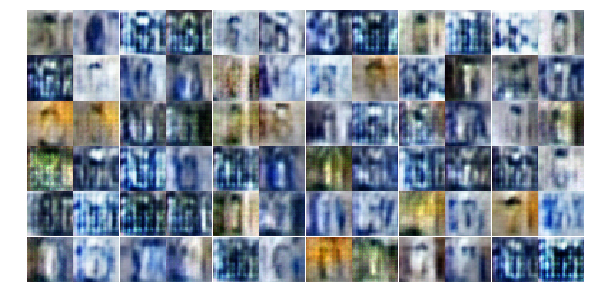

Epoch 9/25... Discriminator Loss: 1.2069... Generator Loss: 0.8697
Epoch 9/25... Discriminator Loss: 1.4171... Generator Loss: 0.6060
Epoch 9/25... Discriminator Loss: 1.2088... Generator Loss: 0.8815
Epoch 9/25... Discriminator Loss: 1.2596... Generator Loss: 0.7906
Epoch 9/25... Discriminator Loss: 1.2710... Generator Loss: 1.0595
Epoch 9/25... Discriminator Loss: 1.3063... Generator Loss: 0.7833
Epoch 9/25... Discriminator Loss: 1.1473... Generator Loss: 0.8226
Epoch 9/25... Discriminator Loss: 1.3141... Generator Loss: 0.6621
Epoch 9/25... Discriminator Loss: 1.2601... Generator Loss: 0.7380
Epoch 9/25... Discriminator Loss: 1.2851... Generator Loss: 0.7138


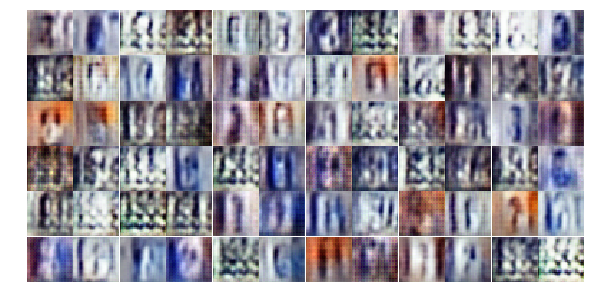

Epoch 9/25... Discriminator Loss: 1.2908... Generator Loss: 0.7529
Epoch 9/25... Discriminator Loss: 1.4153... Generator Loss: 0.6848
Epoch 9/25... Discriminator Loss: 1.3143... Generator Loss: 0.7260
Epoch 9/25... Discriminator Loss: 0.9585... Generator Loss: 1.0032
Epoch 9/25... Discriminator Loss: 1.3765... Generator Loss: 0.8703
Epoch 10/25... Discriminator Loss: 1.6909... Generator Loss: 0.5275
Epoch 10/25... Discriminator Loss: 1.2005... Generator Loss: 0.8122
Epoch 10/25... Discriminator Loss: 1.6761... Generator Loss: 0.5483
Epoch 10/25... Discriminator Loss: 1.2530... Generator Loss: 0.8091
Epoch 10/25... Discriminator Loss: 1.1668... Generator Loss: 0.7840


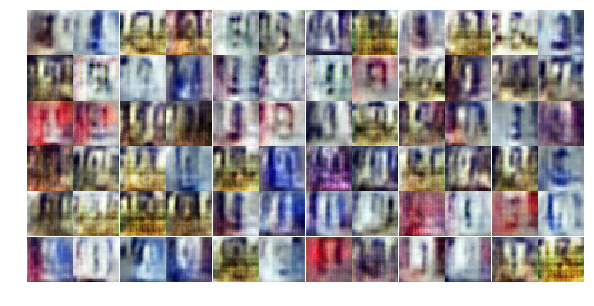

Epoch 10/25... Discriminator Loss: 1.2193... Generator Loss: 0.7649
Epoch 10/25... Discriminator Loss: 1.3166... Generator Loss: 0.8778
Epoch 10/25... Discriminator Loss: 1.2627... Generator Loss: 1.0215
Epoch 10/25... Discriminator Loss: 1.1302... Generator Loss: 0.9041
Epoch 10/25... Discriminator Loss: 1.2617... Generator Loss: 0.8112
Epoch 10/25... Discriminator Loss: 1.3640... Generator Loss: 0.7234
Epoch 10/25... Discriminator Loss: 1.2937... Generator Loss: 0.7956
Epoch 10/25... Discriminator Loss: 1.3631... Generator Loss: 0.7312
Epoch 10/25... Discriminator Loss: 1.1922... Generator Loss: 0.8517
Epoch 10/25... Discriminator Loss: 1.3122... Generator Loss: 0.7352


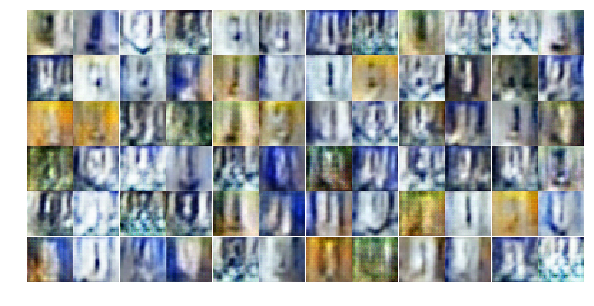

Epoch 10/25... Discriminator Loss: 1.0936... Generator Loss: 0.9547
Epoch 10/25... Discriminator Loss: 1.2330... Generator Loss: 0.8427
Epoch 10/25... Discriminator Loss: 1.1453... Generator Loss: 0.9200
Epoch 10/25... Discriminator Loss: 1.3604... Generator Loss: 0.7047
Epoch 10/25... Discriminator Loss: 1.0903... Generator Loss: 0.9059
Epoch 10/25... Discriminator Loss: 1.2298... Generator Loss: 0.8232
Epoch 10/25... Discriminator Loss: 1.3831... Generator Loss: 0.6241
Epoch 10/25... Discriminator Loss: 1.1343... Generator Loss: 0.8594
Epoch 10/25... Discriminator Loss: 1.4878... Generator Loss: 0.7090
Epoch 10/25... Discriminator Loss: 1.2824... Generator Loss: 0.8265


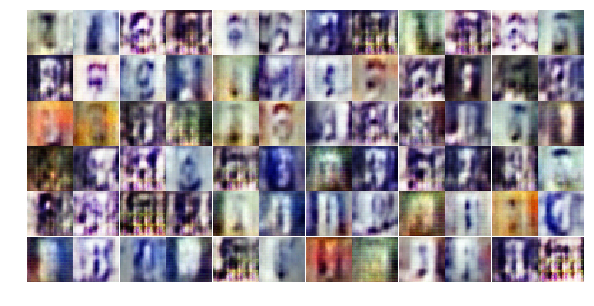

Epoch 10/25... Discriminator Loss: 1.2837... Generator Loss: 0.9207
Epoch 10/25... Discriminator Loss: 1.2878... Generator Loss: 0.8663
Epoch 10/25... Discriminator Loss: 1.1550... Generator Loss: 0.9059
Epoch 10/25... Discriminator Loss: 1.3300... Generator Loss: 0.6340
Epoch 10/25... Discriminator Loss: 1.3603... Generator Loss: 0.6542
Epoch 10/25... Discriminator Loss: 1.2566... Generator Loss: 0.7761
Epoch 10/25... Discriminator Loss: 1.2647... Generator Loss: 0.7635
Epoch 10/25... Discriminator Loss: 1.3872... Generator Loss: 0.6357
Epoch 10/25... Discriminator Loss: 1.3165... Generator Loss: 0.7095
Epoch 10/25... Discriminator Loss: 1.2220... Generator Loss: 0.7915


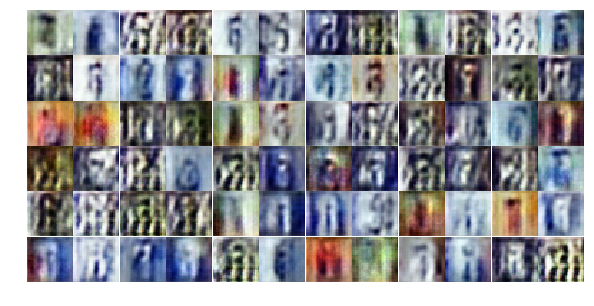

Epoch 10/25... Discriminator Loss: 1.2589... Generator Loss: 0.8800
Epoch 10/25... Discriminator Loss: 1.4035... Generator Loss: 0.7218
Epoch 10/25... Discriminator Loss: 1.0013... Generator Loss: 0.9993
Epoch 10/25... Discriminator Loss: 1.3377... Generator Loss: 0.6933
Epoch 10/25... Discriminator Loss: 1.3268... Generator Loss: 0.8716
Epoch 10/25... Discriminator Loss: 1.0088... Generator Loss: 0.8451
Epoch 10/25... Discriminator Loss: 1.0954... Generator Loss: 1.0289
Epoch 10/25... Discriminator Loss: 1.3674... Generator Loss: 0.6962
Epoch 10/25... Discriminator Loss: 1.3955... Generator Loss: 0.6516
Epoch 10/25... Discriminator Loss: 1.3290... Generator Loss: 0.7847


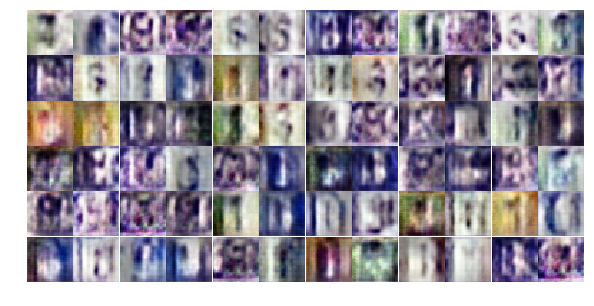

Epoch 10/25... Discriminator Loss: 1.2444... Generator Loss: 0.8498
Epoch 10/25... Discriminator Loss: 1.2636... Generator Loss: 0.7132
Epoch 10/25... Discriminator Loss: 1.4014... Generator Loss: 0.6474
Epoch 10/25... Discriminator Loss: 1.1485... Generator Loss: 0.9429
Epoch 10/25... Discriminator Loss: 1.3197... Generator Loss: 0.7801
Epoch 10/25... Discriminator Loss: 1.2771... Generator Loss: 0.7004
Epoch 10/25... Discriminator Loss: 1.2860... Generator Loss: 0.8726
Epoch 10/25... Discriminator Loss: 1.1960... Generator Loss: 0.9107
Epoch 10/25... Discriminator Loss: 1.1913... Generator Loss: 0.8510
Epoch 10/25... Discriminator Loss: 1.2328... Generator Loss: 0.8675


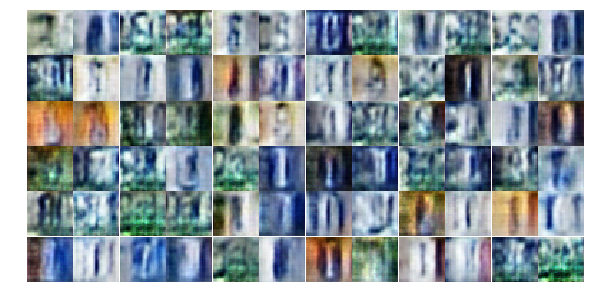

Epoch 10/25... Discriminator Loss: 1.1707... Generator Loss: 0.8126
Epoch 10/25... Discriminator Loss: 1.4690... Generator Loss: 0.6873
Epoch 10/25... Discriminator Loss: 0.8827... Generator Loss: 1.0540
Epoch 11/25... Discriminator Loss: 1.3164... Generator Loss: 0.8221
Epoch 11/25... Discriminator Loss: 1.2910... Generator Loss: 0.8351
Epoch 11/25... Discriminator Loss: 1.2367... Generator Loss: 0.7434
Epoch 11/25... Discriminator Loss: 1.2980... Generator Loss: 0.7797
Epoch 11/25... Discriminator Loss: 1.2858... Generator Loss: 0.8217
Epoch 11/25... Discriminator Loss: 1.3118... Generator Loss: 0.7064
Epoch 11/25... Discriminator Loss: 1.1745... Generator Loss: 0.8804


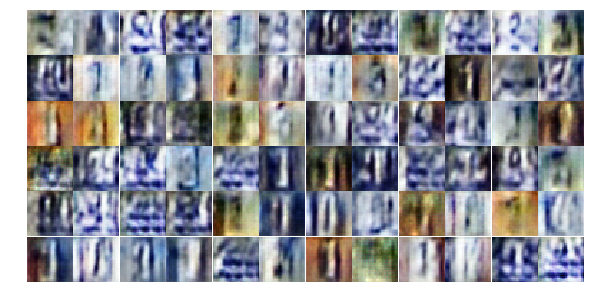

Epoch 11/25... Discriminator Loss: 1.3186... Generator Loss: 0.7888
Epoch 11/25... Discriminator Loss: 1.3264... Generator Loss: 0.7065
Epoch 11/25... Discriminator Loss: 1.2203... Generator Loss: 0.8365
Epoch 11/25... Discriminator Loss: 1.2448... Generator Loss: 0.7672
Epoch 11/25... Discriminator Loss: 1.3595... Generator Loss: 0.8298
Epoch 11/25... Discriminator Loss: 1.3928... Generator Loss: 0.6261
Epoch 11/25... Discriminator Loss: 1.2904... Generator Loss: 0.7481
Epoch 11/25... Discriminator Loss: 1.4621... Generator Loss: 0.7319
Epoch 11/25... Discriminator Loss: 1.3611... Generator Loss: 0.7193
Epoch 11/25... Discriminator Loss: 1.2669... Generator Loss: 0.7287


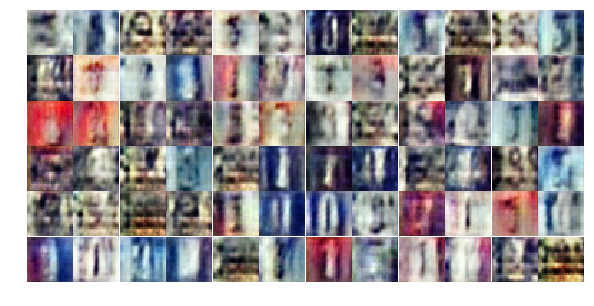

Epoch 11/25... Discriminator Loss: 1.5303... Generator Loss: 0.6103
Epoch 11/25... Discriminator Loss: 1.1139... Generator Loss: 1.0092
Epoch 11/25... Discriminator Loss: 1.3967... Generator Loss: 0.7001
Epoch 11/25... Discriminator Loss: 1.2099... Generator Loss: 0.7925
Epoch 11/25... Discriminator Loss: 1.5492... Generator Loss: 0.6725
Epoch 11/25... Discriminator Loss: 1.3030... Generator Loss: 0.8834
Epoch 11/25... Discriminator Loss: 1.2091... Generator Loss: 0.7644
Epoch 11/25... Discriminator Loss: 1.3594... Generator Loss: 0.7596
Epoch 11/25... Discriminator Loss: 1.2752... Generator Loss: 0.8359
Epoch 11/25... Discriminator Loss: 1.3256... Generator Loss: 0.7434


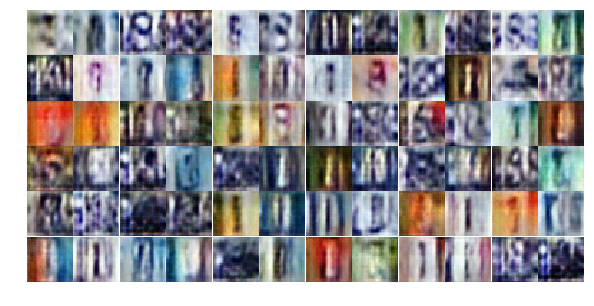

Epoch 11/25... Discriminator Loss: 1.3923... Generator Loss: 0.7099
Epoch 11/25... Discriminator Loss: 1.2065... Generator Loss: 0.7955
Epoch 11/25... Discriminator Loss: 1.4186... Generator Loss: 0.7468
Epoch 11/25... Discriminator Loss: 1.2181... Generator Loss: 0.8118
Epoch 11/25... Discriminator Loss: 1.2895... Generator Loss: 0.7361
Epoch 11/25... Discriminator Loss: 1.0530... Generator Loss: 0.8782
Epoch 11/25... Discriminator Loss: 1.5715... Generator Loss: 0.7042
Epoch 11/25... Discriminator Loss: 1.4239... Generator Loss: 0.7233
Epoch 11/25... Discriminator Loss: 1.3538... Generator Loss: 0.7344
Epoch 11/25... Discriminator Loss: 1.3344... Generator Loss: 0.7690


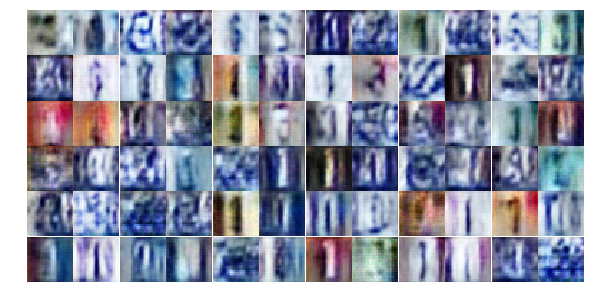

Epoch 11/25... Discriminator Loss: 1.3494... Generator Loss: 0.7560
Epoch 11/25... Discriminator Loss: 1.1652... Generator Loss: 0.8513
Epoch 11/25... Discriminator Loss: 1.3566... Generator Loss: 0.7444
Epoch 11/25... Discriminator Loss: 1.2870... Generator Loss: 0.7292
Epoch 11/25... Discriminator Loss: 1.4090... Generator Loss: 0.7095
Epoch 11/25... Discriminator Loss: 1.3433... Generator Loss: 0.7902
Epoch 11/25... Discriminator Loss: 1.1583... Generator Loss: 0.9342
Epoch 11/25... Discriminator Loss: 1.4047... Generator Loss: 0.5940
Epoch 11/25... Discriminator Loss: 1.3273... Generator Loss: 0.6952
Epoch 11/25... Discriminator Loss: 1.3694... Generator Loss: 0.7356


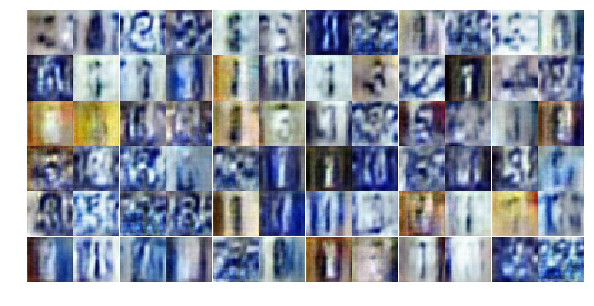

Epoch 11/25... Discriminator Loss: 1.3158... Generator Loss: 0.7615
Epoch 11/25... Discriminator Loss: 1.3313... Generator Loss: 0.6975
Epoch 11/25... Discriminator Loss: 1.2392... Generator Loss: 0.8200
Epoch 11/25... Discriminator Loss: 1.4072... Generator Loss: 0.6851
Epoch 11/25... Discriminator Loss: 1.3331... Generator Loss: 0.7205
Epoch 11/25... Discriminator Loss: 1.2943... Generator Loss: 0.7150
Epoch 11/25... Discriminator Loss: 1.3803... Generator Loss: 0.7132
Epoch 11/25... Discriminator Loss: 1.3079... Generator Loss: 0.7922
Epoch 11/25... Discriminator Loss: 1.3819... Generator Loss: 0.6232
Epoch 11/25... Discriminator Loss: 1.3024... Generator Loss: 0.7619


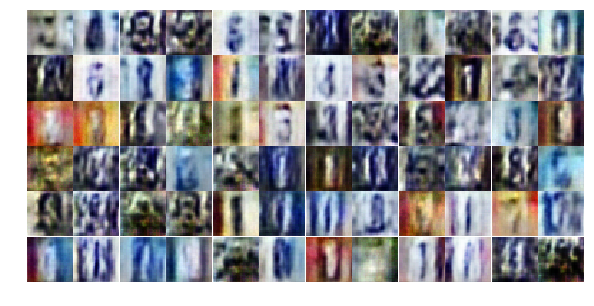

Epoch 12/25... Discriminator Loss: 1.4520... Generator Loss: 0.6047
Epoch 12/25... Discriminator Loss: 1.3201... Generator Loss: 0.7880
Epoch 12/25... Discriminator Loss: 1.4560... Generator Loss: 0.5350
Epoch 12/25... Discriminator Loss: 1.2573... Generator Loss: 0.7867
Epoch 12/25... Discriminator Loss: 1.3570... Generator Loss: 0.7325
Epoch 12/25... Discriminator Loss: 1.4414... Generator Loss: 0.6439
Epoch 12/25... Discriminator Loss: 1.2664... Generator Loss: 0.8098
Epoch 12/25... Discriminator Loss: 1.2487... Generator Loss: 0.8123
Epoch 12/25... Discriminator Loss: 1.7110... Generator Loss: 0.5505
Epoch 12/25... Discriminator Loss: 1.2460... Generator Loss: 0.6842


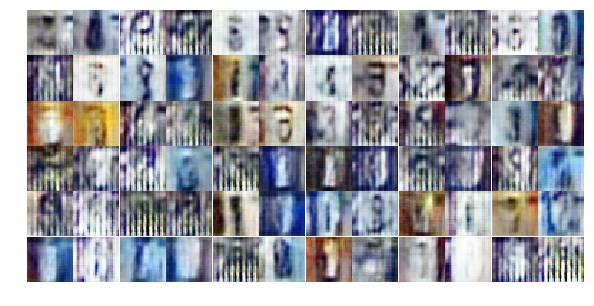

Epoch 12/25... Discriminator Loss: 1.4332... Generator Loss: 0.5978
Epoch 12/25... Discriminator Loss: 1.3045... Generator Loss: 0.7748
Epoch 12/25... Discriminator Loss: 1.3896... Generator Loss: 0.6255
Epoch 12/25... Discriminator Loss: 1.4689... Generator Loss: 0.6773
Epoch 12/25... Discriminator Loss: 1.2068... Generator Loss: 0.8754
Epoch 12/25... Discriminator Loss: 1.5289... Generator Loss: 0.6732
Epoch 12/25... Discriminator Loss: 1.3381... Generator Loss: 0.7481
Epoch 12/25... Discriminator Loss: 1.2445... Generator Loss: 0.8025
Epoch 12/25... Discriminator Loss: 1.4453... Generator Loss: 0.7893
Epoch 12/25... Discriminator Loss: 1.1467... Generator Loss: 0.7768


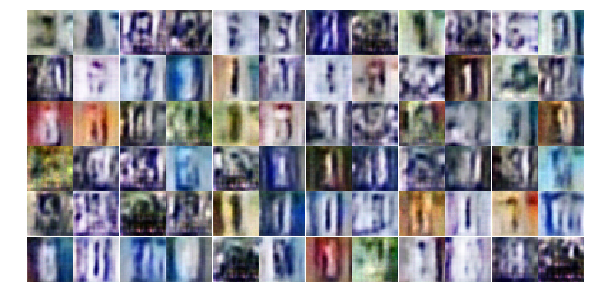

Epoch 12/25... Discriminator Loss: 1.3618... Generator Loss: 0.7234
Epoch 12/25... Discriminator Loss: 1.2583... Generator Loss: 0.7732
Epoch 12/25... Discriminator Loss: 1.3359... Generator Loss: 0.7494
Epoch 12/25... Discriminator Loss: 1.3094... Generator Loss: 0.7326
Epoch 12/25... Discriminator Loss: 1.4119... Generator Loss: 0.7195
Epoch 12/25... Discriminator Loss: 1.0618... Generator Loss: 1.0503
Epoch 12/25... Discriminator Loss: 1.1951... Generator Loss: 0.8759
Epoch 12/25... Discriminator Loss: 1.2613... Generator Loss: 0.8033
Epoch 12/25... Discriminator Loss: 1.1991... Generator Loss: 0.8176
Epoch 12/25... Discriminator Loss: 1.1415... Generator Loss: 0.8987


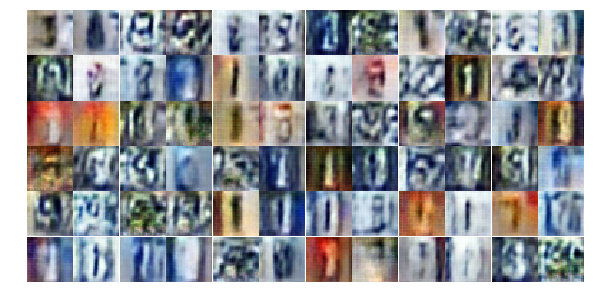

Epoch 12/25... Discriminator Loss: 1.3281... Generator Loss: 0.7101
Epoch 12/25... Discriminator Loss: 1.3027... Generator Loss: 0.7199
Epoch 12/25... Discriminator Loss: 1.2307... Generator Loss: 0.7774
Epoch 12/25... Discriminator Loss: 1.5081... Generator Loss: 0.5717
Epoch 12/25... Discriminator Loss: 1.3379... Generator Loss: 0.8714
Epoch 12/25... Discriminator Loss: 1.2626... Generator Loss: 0.7771
Epoch 12/25... Discriminator Loss: 1.3022... Generator Loss: 0.7755
Epoch 12/25... Discriminator Loss: 1.2969... Generator Loss: 0.7173
Epoch 12/25... Discriminator Loss: 1.2126... Generator Loss: 0.8181
Epoch 12/25... Discriminator Loss: 1.2917... Generator Loss: 0.8247


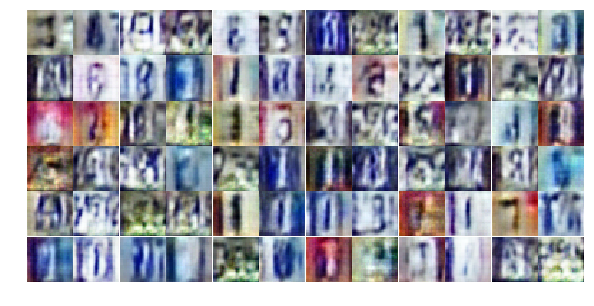

Epoch 12/25... Discriminator Loss: 1.2780... Generator Loss: 0.7978
Epoch 12/25... Discriminator Loss: 1.3685... Generator Loss: 0.7935
Epoch 12/25... Discriminator Loss: 1.2809... Generator Loss: 0.7559
Epoch 12/25... Discriminator Loss: 1.3026... Generator Loss: 0.6621
Epoch 12/25... Discriminator Loss: 1.2432... Generator Loss: 0.8086
Epoch 12/25... Discriminator Loss: 1.2111... Generator Loss: 0.8592
Epoch 12/25... Discriminator Loss: 1.1893... Generator Loss: 0.8380
Epoch 12/25... Discriminator Loss: 1.4019... Generator Loss: 0.6530
Epoch 12/25... Discriminator Loss: 1.4882... Generator Loss: 0.6108
Epoch 12/25... Discriminator Loss: 1.1506... Generator Loss: 0.8568


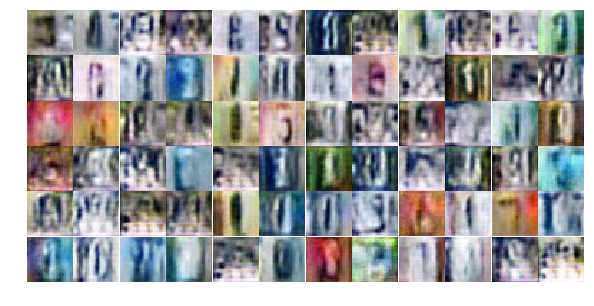

Epoch 12/25... Discriminator Loss: 1.3808... Generator Loss: 0.6557
Epoch 12/25... Discriminator Loss: 1.1371... Generator Loss: 0.8644
Epoch 12/25... Discriminator Loss: 1.3224... Generator Loss: 0.8033
Epoch 12/25... Discriminator Loss: 1.3791... Generator Loss: 0.7187
Epoch 12/25... Discriminator Loss: 1.3683... Generator Loss: 0.7528
Epoch 12/25... Discriminator Loss: 1.2906... Generator Loss: 0.7132
Epoch 12/25... Discriminator Loss: 1.4461... Generator Loss: 0.8231
Epoch 13/25... Discriminator Loss: 1.0081... Generator Loss: 1.0181
Epoch 13/25... Discriminator Loss: 1.3579... Generator Loss: 0.7633
Epoch 13/25... Discriminator Loss: 1.3407... Generator Loss: 0.7319


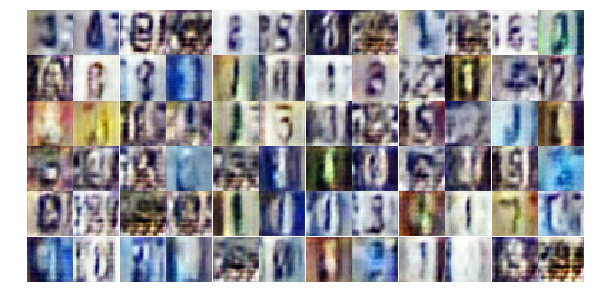

Epoch 13/25... Discriminator Loss: 1.6667... Generator Loss: 0.5559
Epoch 13/25... Discriminator Loss: 1.2186... Generator Loss: 0.7586
Epoch 13/25... Discriminator Loss: 1.4040... Generator Loss: 0.6777
Epoch 13/25... Discriminator Loss: 1.3447... Generator Loss: 0.6818
Epoch 13/25... Discriminator Loss: 1.3493... Generator Loss: 0.7561
Epoch 13/25... Discriminator Loss: 1.3224... Generator Loss: 0.7582
Epoch 13/25... Discriminator Loss: 1.2372... Generator Loss: 0.8073
Epoch 13/25... Discriminator Loss: 1.4465... Generator Loss: 0.6600
Epoch 13/25... Discriminator Loss: 1.3378... Generator Loss: 0.8053
Epoch 13/25... Discriminator Loss: 1.3526... Generator Loss: 0.6884


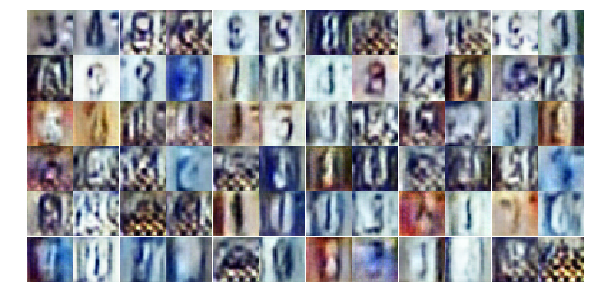

Epoch 13/25... Discriminator Loss: 1.3476... Generator Loss: 0.7112
Epoch 13/25... Discriminator Loss: 1.1103... Generator Loss: 0.8814
Epoch 13/25... Discriminator Loss: 1.5619... Generator Loss: 0.6006
Epoch 13/25... Discriminator Loss: 1.1284... Generator Loss: 0.8528
Epoch 13/25... Discriminator Loss: 1.3586... Generator Loss: 0.7293
Epoch 13/25... Discriminator Loss: 1.1697... Generator Loss: 0.7615
Epoch 13/25... Discriminator Loss: 1.2042... Generator Loss: 0.8580
Epoch 13/25... Discriminator Loss: 1.3150... Generator Loss: 0.7447
Epoch 13/25... Discriminator Loss: 1.2587... Generator Loss: 0.8226
Epoch 13/25... Discriminator Loss: 1.2260... Generator Loss: 0.7934


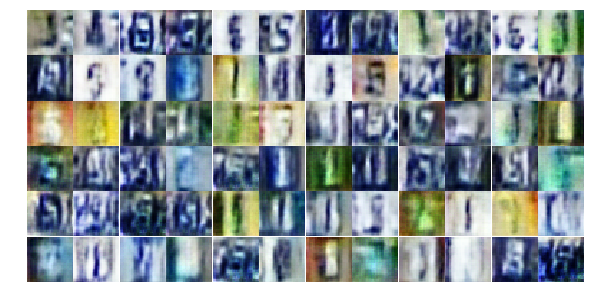

Epoch 13/25... Discriminator Loss: 1.1988... Generator Loss: 0.8359
Epoch 13/25... Discriminator Loss: 1.3199... Generator Loss: 0.7677
Epoch 13/25... Discriminator Loss: 1.2894... Generator Loss: 0.7866
Epoch 13/25... Discriminator Loss: 1.3601... Generator Loss: 0.6872
Epoch 13/25... Discriminator Loss: 1.3621... Generator Loss: 0.7512
Epoch 13/25... Discriminator Loss: 1.2668... Generator Loss: 0.7650
Epoch 13/25... Discriminator Loss: 1.2515... Generator Loss: 0.7938
Epoch 13/25... Discriminator Loss: 1.2741... Generator Loss: 0.8140
Epoch 13/25... Discriminator Loss: 1.4002... Generator Loss: 0.7460
Epoch 13/25... Discriminator Loss: 1.3428... Generator Loss: 0.7469


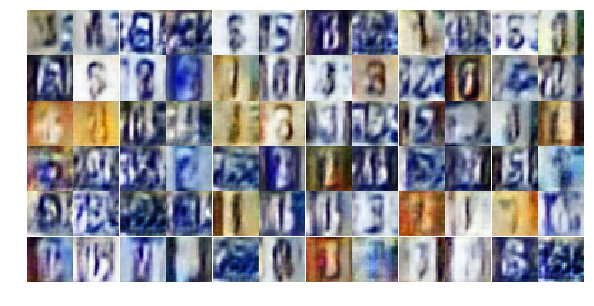

Epoch 13/25... Discriminator Loss: 1.4128... Generator Loss: 0.6757
Epoch 13/25... Discriminator Loss: 1.3912... Generator Loss: 0.7166
Epoch 13/25... Discriminator Loss: 1.4045... Generator Loss: 0.6935
Epoch 13/25... Discriminator Loss: 1.2862... Generator Loss: 0.7200
Epoch 13/25... Discriminator Loss: 1.1832... Generator Loss: 0.8433
Epoch 13/25... Discriminator Loss: 1.2639... Generator Loss: 0.7948
Epoch 13/25... Discriminator Loss: 1.5459... Generator Loss: 0.6223
Epoch 13/25... Discriminator Loss: 1.2901... Generator Loss: 0.7336
Epoch 13/25... Discriminator Loss: 1.3400... Generator Loss: 0.6922
Epoch 13/25... Discriminator Loss: 1.3212... Generator Loss: 0.7549


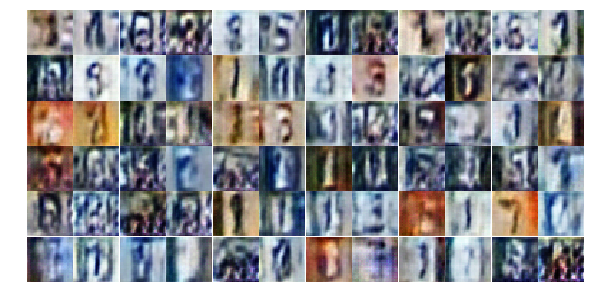

Epoch 13/25... Discriminator Loss: 1.3919... Generator Loss: 0.6852
Epoch 13/25... Discriminator Loss: 1.2720... Generator Loss: 0.8930
Epoch 13/25... Discriminator Loss: 1.3506... Generator Loss: 0.6705
Epoch 13/25... Discriminator Loss: 1.3684... Generator Loss: 0.7397
Epoch 13/25... Discriminator Loss: 1.3671... Generator Loss: 0.7057
Epoch 13/25... Discriminator Loss: 1.3983... Generator Loss: 0.6822
Epoch 13/25... Discriminator Loss: 1.3235... Generator Loss: 0.7872
Epoch 13/25... Discriminator Loss: 1.2414... Generator Loss: 0.7600
Epoch 13/25... Discriminator Loss: 1.2672... Generator Loss: 0.8139
Epoch 13/25... Discriminator Loss: 1.3409... Generator Loss: 0.6948


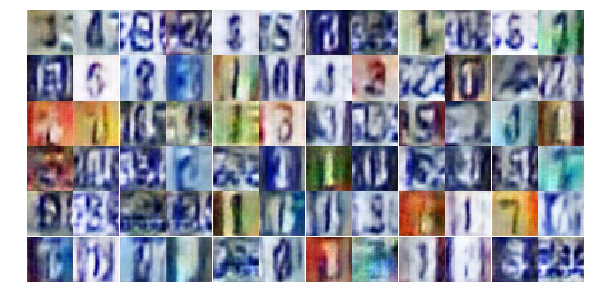

Epoch 13/25... Discriminator Loss: 1.2239... Generator Loss: 0.8122
Epoch 13/25... Discriminator Loss: 1.2190... Generator Loss: 0.7542
Epoch 13/25... Discriminator Loss: 1.3466... Generator Loss: 0.7837
Epoch 13/25... Discriminator Loss: 1.3753... Generator Loss: 0.5894
Epoch 14/25... Discriminator Loss: 1.2480... Generator Loss: 0.8428
Epoch 14/25... Discriminator Loss: 1.2828... Generator Loss: 0.7569
Epoch 14/25... Discriminator Loss: 1.2010... Generator Loss: 0.7427
Epoch 14/25... Discriminator Loss: 1.2944... Generator Loss: 0.7419
Epoch 14/25... Discriminator Loss: 1.2840... Generator Loss: 0.7641
Epoch 14/25... Discriminator Loss: 1.4139... Generator Loss: 0.6791


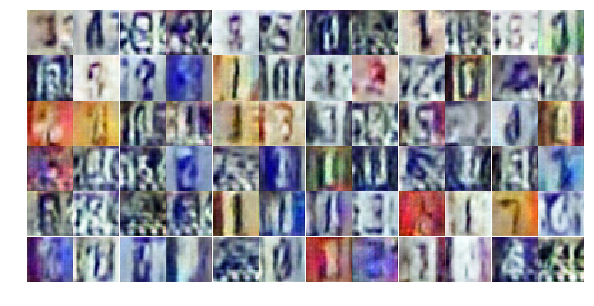

Epoch 14/25... Discriminator Loss: 1.5187... Generator Loss: 0.6124
Epoch 14/25... Discriminator Loss: 1.3192... Generator Loss: 0.7166
Epoch 14/25... Discriminator Loss: 1.3025... Generator Loss: 0.7449
Epoch 14/25... Discriminator Loss: 1.3470... Generator Loss: 0.6898
Epoch 14/25... Discriminator Loss: 1.2041... Generator Loss: 0.7671
Epoch 14/25... Discriminator Loss: 1.3535... Generator Loss: 0.7178
Epoch 14/25... Discriminator Loss: 1.2315... Generator Loss: 0.8676
Epoch 14/25... Discriminator Loss: 1.3979... Generator Loss: 0.5874
Epoch 14/25... Discriminator Loss: 1.4840... Generator Loss: 0.5871
Epoch 14/25... Discriminator Loss: 1.3038... Generator Loss: 0.6954


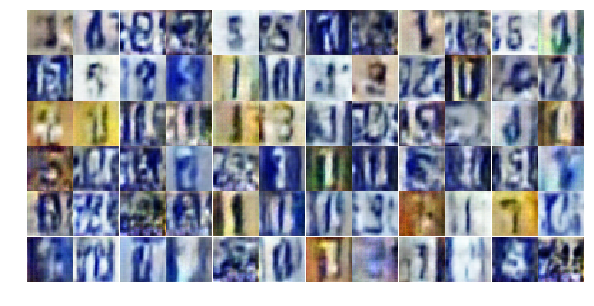

Epoch 14/25... Discriminator Loss: 1.2497... Generator Loss: 0.8535
Epoch 14/25... Discriminator Loss: 1.5045... Generator Loss: 0.5699
Epoch 14/25... Discriminator Loss: 1.1942... Generator Loss: 0.7875
Epoch 14/25... Discriminator Loss: 1.4444... Generator Loss: 0.7175
Epoch 14/25... Discriminator Loss: 1.2979... Generator Loss: 0.7208
Epoch 14/25... Discriminator Loss: 1.3968... Generator Loss: 0.6850
Epoch 14/25... Discriminator Loss: 1.3311... Generator Loss: 0.7795
Epoch 14/25... Discriminator Loss: 1.2112... Generator Loss: 0.8596
Epoch 14/25... Discriminator Loss: 1.4367... Generator Loss: 0.7376
Epoch 14/25... Discriminator Loss: 1.3590... Generator Loss: 0.5999


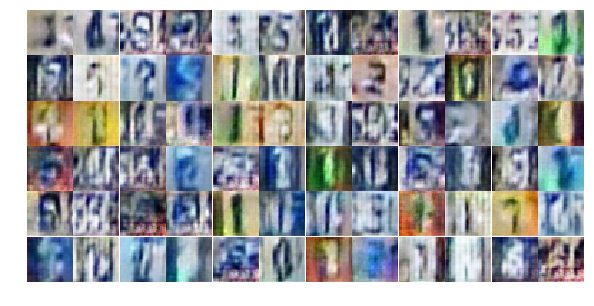

Epoch 14/25... Discriminator Loss: 1.3959... Generator Loss: 0.6754
Epoch 14/25... Discriminator Loss: 1.3197... Generator Loss: 0.7422
Epoch 14/25... Discriminator Loss: 1.2128... Generator Loss: 0.8404
Epoch 14/25... Discriminator Loss: 1.4008... Generator Loss: 0.6305
Epoch 14/25... Discriminator Loss: 1.3486... Generator Loss: 0.7512
Epoch 14/25... Discriminator Loss: 1.2947... Generator Loss: 0.8515
Epoch 14/25... Discriminator Loss: 1.3138... Generator Loss: 0.7667
Epoch 14/25... Discriminator Loss: 1.2964... Generator Loss: 0.7380
Epoch 14/25... Discriminator Loss: 1.4698... Generator Loss: 0.6268
Epoch 14/25... Discriminator Loss: 1.4637... Generator Loss: 0.6913


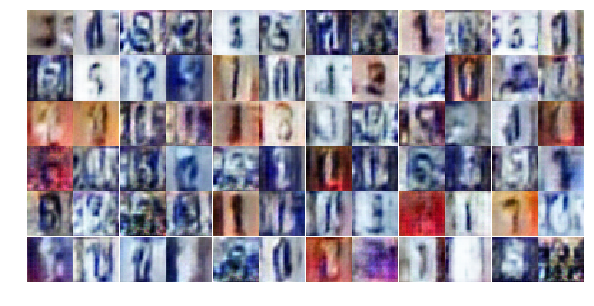

Epoch 14/25... Discriminator Loss: 1.4786... Generator Loss: 0.5571
Epoch 14/25... Discriminator Loss: 1.2303... Generator Loss: 0.7767
Epoch 14/25... Discriminator Loss: 1.1200... Generator Loss: 0.8097
Epoch 14/25... Discriminator Loss: 1.3287... Generator Loss: 0.8266
Epoch 14/25... Discriminator Loss: 1.3794... Generator Loss: 0.7108
Epoch 14/25... Discriminator Loss: 1.3222... Generator Loss: 0.6714
Epoch 14/25... Discriminator Loss: 1.2644... Generator Loss: 0.7272
Epoch 14/25... Discriminator Loss: 1.4163... Generator Loss: 0.6746
Epoch 14/25... Discriminator Loss: 1.2836... Generator Loss: 0.8201
Epoch 14/25... Discriminator Loss: 1.3075... Generator Loss: 0.6936


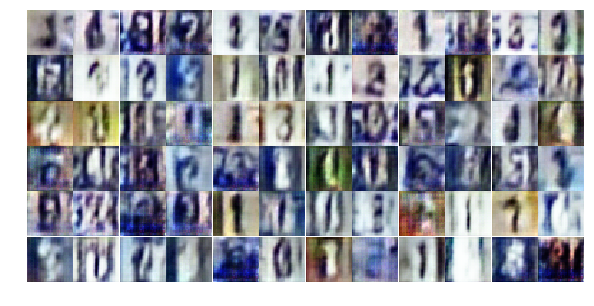

Epoch 14/25... Discriminator Loss: 1.3713... Generator Loss: 0.7397
Epoch 14/25... Discriminator Loss: 1.3602... Generator Loss: 0.7860
Epoch 14/25... Discriminator Loss: 1.2436... Generator Loss: 0.7874
Epoch 14/25... Discriminator Loss: 1.5124... Generator Loss: 0.6405
Epoch 14/25... Discriminator Loss: 1.2977... Generator Loss: 0.7539
Epoch 14/25... Discriminator Loss: 1.4153... Generator Loss: 0.6430
Epoch 14/25... Discriminator Loss: 1.3334... Generator Loss: 0.7154
Epoch 14/25... Discriminator Loss: 1.3351... Generator Loss: 0.6973
Epoch 14/25... Discriminator Loss: 1.3958... Generator Loss: 0.7269
Epoch 14/25... Discriminator Loss: 1.4719... Generator Loss: 0.6391


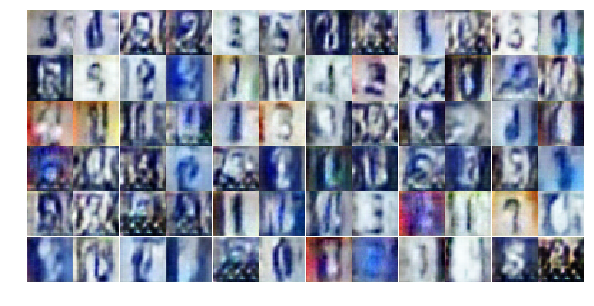

Epoch 14/25... Discriminator Loss: 1.2577... Generator Loss: 0.7508
Epoch 14/25... Discriminator Loss: 1.3015... Generator Loss: 0.7440
Epoch 15/25... Discriminator Loss: 1.5375... Generator Loss: 0.6276
Epoch 15/25... Discriminator Loss: 1.3219... Generator Loss: 0.7134
Epoch 15/25... Discriminator Loss: 1.1272... Generator Loss: 0.8724
Epoch 15/25... Discriminator Loss: 1.4721... Generator Loss: 0.7182
Epoch 15/25... Discriminator Loss: 1.3467... Generator Loss: 0.6984
Epoch 15/25... Discriminator Loss: 1.3830... Generator Loss: 0.7240
Epoch 15/25... Discriminator Loss: 1.4081... Generator Loss: 0.6656
Epoch 15/25... Discriminator Loss: 1.3573... Generator Loss: 0.7218


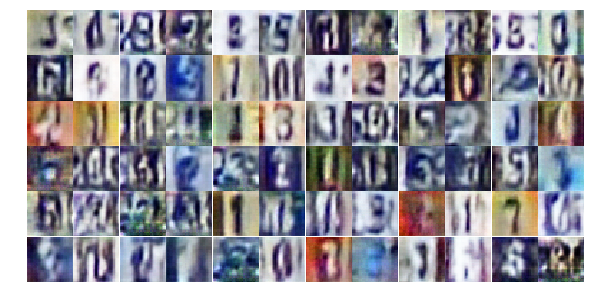

Epoch 15/25... Discriminator Loss: 1.3743... Generator Loss: 0.7850
Epoch 15/25... Discriminator Loss: 1.3474... Generator Loss: 0.7044
Epoch 15/25... Discriminator Loss: 1.3587... Generator Loss: 0.7231
Epoch 15/25... Discriminator Loss: 1.4402... Generator Loss: 0.6292
Epoch 15/25... Discriminator Loss: 1.3483... Generator Loss: 0.7033
Epoch 15/25... Discriminator Loss: 1.3186... Generator Loss: 0.7447
Epoch 15/25... Discriminator Loss: 1.3990... Generator Loss: 0.7058
Epoch 15/25... Discriminator Loss: 1.4378... Generator Loss: 0.6865
Epoch 15/25... Discriminator Loss: 1.3022... Generator Loss: 0.7366
Epoch 15/25... Discriminator Loss: 1.3626... Generator Loss: 0.7203


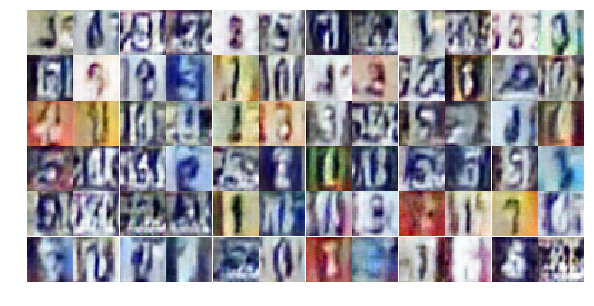

Epoch 15/25... Discriminator Loss: 1.3751... Generator Loss: 0.7425
Epoch 15/25... Discriminator Loss: 1.4099... Generator Loss: 0.6736
Epoch 15/25... Discriminator Loss: 1.3186... Generator Loss: 0.7714
Epoch 15/25... Discriminator Loss: 1.3209... Generator Loss: 0.7244
Epoch 15/25... Discriminator Loss: 1.3687... Generator Loss: 0.6961
Epoch 15/25... Discriminator Loss: 1.4843... Generator Loss: 0.6609
Epoch 15/25... Discriminator Loss: 1.2584... Generator Loss: 0.8154
Epoch 15/25... Discriminator Loss: 1.4671... Generator Loss: 0.7004
Epoch 15/25... Discriminator Loss: 1.2770... Generator Loss: 0.7880
Epoch 15/25... Discriminator Loss: 1.3838... Generator Loss: 0.6553


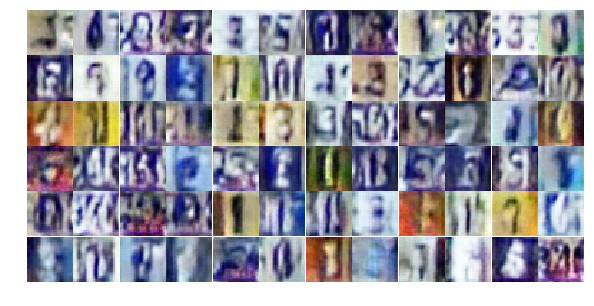

Epoch 15/25... Discriminator Loss: 1.3718... Generator Loss: 0.7029
Epoch 15/25... Discriminator Loss: 1.4105... Generator Loss: 0.7215
Epoch 15/25... Discriminator Loss: 1.3417... Generator Loss: 0.7017
Epoch 15/25... Discriminator Loss: 1.4040... Generator Loss: 0.6856
Epoch 15/25... Discriminator Loss: 1.2982... Generator Loss: 0.7386
Epoch 15/25... Discriminator Loss: 1.3306... Generator Loss: 0.7226
Epoch 15/25... Discriminator Loss: 1.3060... Generator Loss: 0.7385
Epoch 15/25... Discriminator Loss: 1.3653... Generator Loss: 0.6620
Epoch 15/25... Discriminator Loss: 1.4849... Generator Loss: 0.7093
Epoch 15/25... Discriminator Loss: 1.2812... Generator Loss: 0.7116


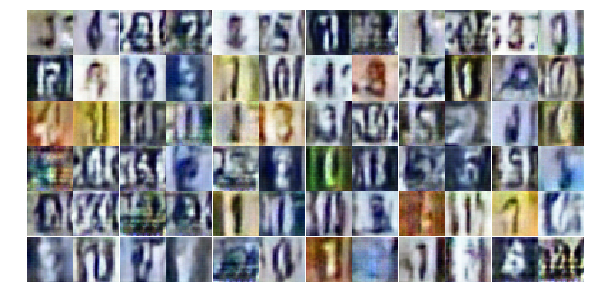

Epoch 15/25... Discriminator Loss: 1.4090... Generator Loss: 0.8214
Epoch 15/25... Discriminator Loss: 1.3604... Generator Loss: 0.7275
Epoch 15/25... Discriminator Loss: 1.3553... Generator Loss: 0.7468
Epoch 15/25... Discriminator Loss: 1.2456... Generator Loss: 0.7956
Epoch 15/25... Discriminator Loss: 1.3326... Generator Loss: 0.7106
Epoch 15/25... Discriminator Loss: 1.1022... Generator Loss: 0.8764
Epoch 15/25... Discriminator Loss: 1.2578... Generator Loss: 0.9414
Epoch 15/25... Discriminator Loss: 1.2992... Generator Loss: 0.6895
Epoch 15/25... Discriminator Loss: 1.3965... Generator Loss: 0.6654
Epoch 15/25... Discriminator Loss: 1.4489... Generator Loss: 0.6361


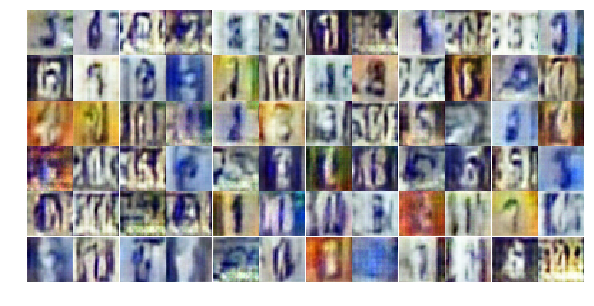

Epoch 15/25... Discriminator Loss: 1.3267... Generator Loss: 0.6771
Epoch 15/25... Discriminator Loss: 1.3627... Generator Loss: 0.7042
Epoch 15/25... Discriminator Loss: 1.3509... Generator Loss: 0.6834
Epoch 15/25... Discriminator Loss: 1.4237... Generator Loss: 0.7370
Epoch 15/25... Discriminator Loss: 1.3307... Generator Loss: 0.7837
Epoch 15/25... Discriminator Loss: 1.4026... Generator Loss: 0.6786
Epoch 15/25... Discriminator Loss: 1.2882... Generator Loss: 0.7662
Epoch 15/25... Discriminator Loss: 1.3869... Generator Loss: 0.7170
Epoch 15/25... Discriminator Loss: 1.2356... Generator Loss: 0.7463
Epoch 16/25... Discriminator Loss: 1.3474... Generator Loss: 0.7614


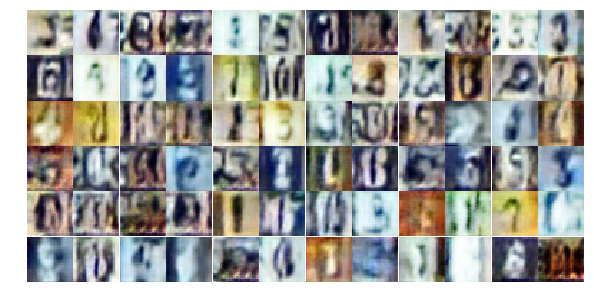

Epoch 16/25... Discriminator Loss: 1.2788... Generator Loss: 0.7469
Epoch 16/25... Discriminator Loss: 1.1534... Generator Loss: 0.8585
Epoch 16/25... Discriminator Loss: 1.4238... Generator Loss: 0.6653
Epoch 16/25... Discriminator Loss: 1.3161... Generator Loss: 0.7469
Epoch 16/25... Discriminator Loss: 1.3484... Generator Loss: 0.7580
Epoch 16/25... Discriminator Loss: 1.3451... Generator Loss: 0.7103
Epoch 16/25... Discriminator Loss: 1.4478... Generator Loss: 0.6337
Epoch 16/25... Discriminator Loss: 1.3238... Generator Loss: 0.7403
Epoch 16/25... Discriminator Loss: 1.3815... Generator Loss: 0.7850
Epoch 16/25... Discriminator Loss: 1.3763... Generator Loss: 0.7115


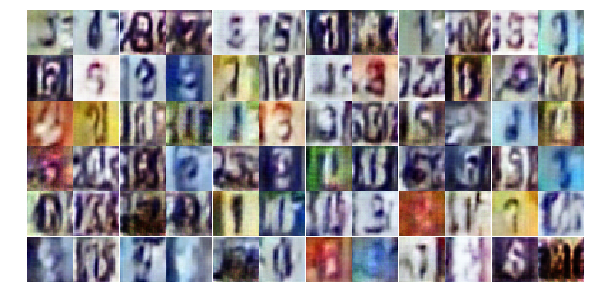

Epoch 16/25... Discriminator Loss: 1.3950... Generator Loss: 0.7194
Epoch 16/25... Discriminator Loss: 1.2940... Generator Loss: 0.7146
Epoch 16/25... Discriminator Loss: 1.3983... Generator Loss: 0.7006
Epoch 16/25... Discriminator Loss: 1.3527... Generator Loss: 0.7074
Epoch 16/25... Discriminator Loss: 1.3041... Generator Loss: 0.7352
Epoch 16/25... Discriminator Loss: 1.5323... Generator Loss: 0.5963
Epoch 16/25... Discriminator Loss: 1.4122... Generator Loss: 0.6638
Epoch 16/25... Discriminator Loss: 1.4388... Generator Loss: 0.7103
Epoch 16/25... Discriminator Loss: 1.4557... Generator Loss: 0.7541
Epoch 16/25... Discriminator Loss: 1.3666... Generator Loss: 0.6396


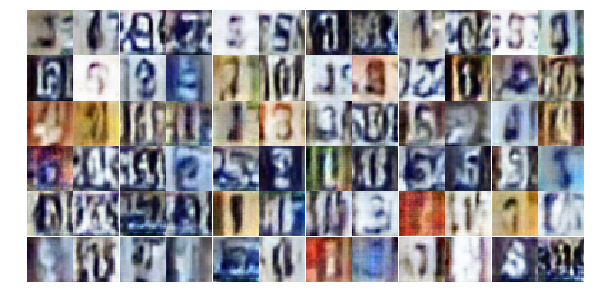

Epoch 16/25... Discriminator Loss: 1.4654... Generator Loss: 0.6216
Epoch 16/25... Discriminator Loss: 1.3621... Generator Loss: 0.6906
Epoch 16/25... Discriminator Loss: 1.3178... Generator Loss: 0.7627
Epoch 16/25... Discriminator Loss: 1.3574... Generator Loss: 0.6943
Epoch 16/25... Discriminator Loss: 1.4980... Generator Loss: 0.5660
Epoch 16/25... Discriminator Loss: 1.3905... Generator Loss: 0.7009
Epoch 16/25... Discriminator Loss: 1.2858... Generator Loss: 0.7985
Epoch 16/25... Discriminator Loss: 1.4396... Generator Loss: 0.7987
Epoch 16/25... Discriminator Loss: 1.3547... Generator Loss: 0.6323
Epoch 16/25... Discriminator Loss: 1.3278... Generator Loss: 0.6989


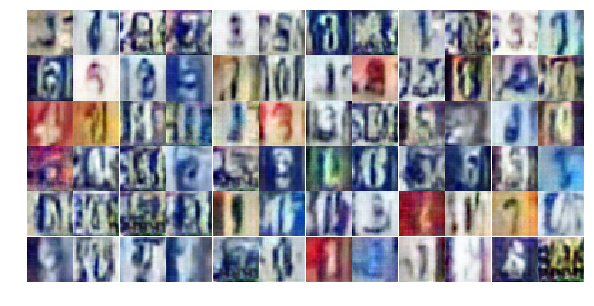

Epoch 16/25... Discriminator Loss: 1.2455... Generator Loss: 0.8107
Epoch 16/25... Discriminator Loss: 1.3258... Generator Loss: 0.7836
Epoch 16/25... Discriminator Loss: 1.3109... Generator Loss: 0.7484
Epoch 16/25... Discriminator Loss: 1.3191... Generator Loss: 0.7352
Epoch 16/25... Discriminator Loss: 1.4186... Generator Loss: 0.6237
Epoch 16/25... Discriminator Loss: 1.3119... Generator Loss: 0.6483
Epoch 16/25... Discriminator Loss: 1.3467... Generator Loss: 0.7402
Epoch 16/25... Discriminator Loss: 1.4273... Generator Loss: 0.6868
Epoch 16/25... Discriminator Loss: 1.3491... Generator Loss: 0.6888
Epoch 16/25... Discriminator Loss: 1.3328... Generator Loss: 0.8007


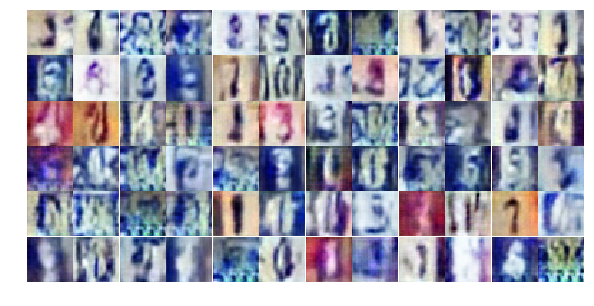

Epoch 16/25... Discriminator Loss: 1.2745... Generator Loss: 0.7181
Epoch 16/25... Discriminator Loss: 1.3061... Generator Loss: 0.7239
Epoch 16/25... Discriminator Loss: 1.3887... Generator Loss: 0.6572
Epoch 16/25... Discriminator Loss: 1.4619... Generator Loss: 0.6996
Epoch 16/25... Discriminator Loss: 1.5137... Generator Loss: 0.5777
Epoch 16/25... Discriminator Loss: 1.4520... Generator Loss: 0.6417
Epoch 16/25... Discriminator Loss: 1.3481... Generator Loss: 0.7088
Epoch 16/25... Discriminator Loss: 1.3312... Generator Loss: 0.8032
Epoch 16/25... Discriminator Loss: 1.3676... Generator Loss: 0.7698
Epoch 16/25... Discriminator Loss: 1.2929... Generator Loss: 0.7954


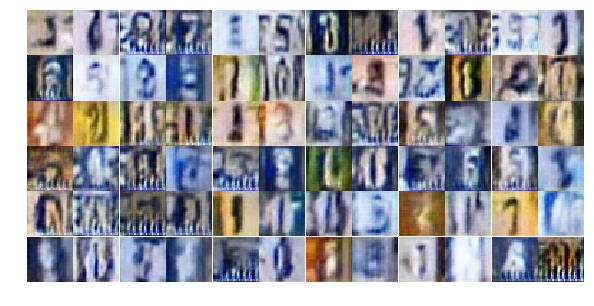

Epoch 16/25... Discriminator Loss: 1.3935... Generator Loss: 0.6553
Epoch 16/25... Discriminator Loss: 1.3957... Generator Loss: 0.7378
Epoch 16/25... Discriminator Loss: 1.6250... Generator Loss: 0.5241
Epoch 16/25... Discriminator Loss: 1.4106... Generator Loss: 0.7124
Epoch 16/25... Discriminator Loss: 1.4647... Generator Loss: 0.7244
Epoch 16/25... Discriminator Loss: 1.3693... Generator Loss: 0.6807
Epoch 17/25... Discriminator Loss: 1.3588... Generator Loss: 0.6275
Epoch 17/25... Discriminator Loss: 1.4142... Generator Loss: 0.6731
Epoch 17/25... Discriminator Loss: 1.3956... Generator Loss: 0.7052
Epoch 17/25... Discriminator Loss: 1.3200... Generator Loss: 0.7795


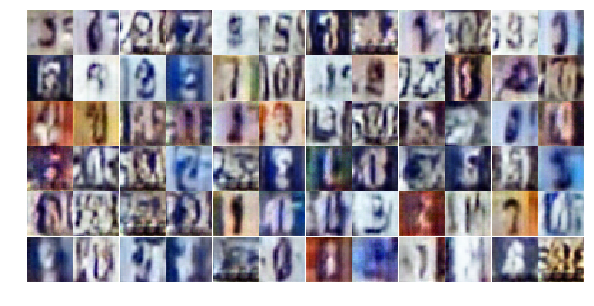

Epoch 17/25... Discriminator Loss: 1.3948... Generator Loss: 0.7197
Epoch 17/25... Discriminator Loss: 1.3501... Generator Loss: 0.7230
Epoch 17/25... Discriminator Loss: 1.3558... Generator Loss: 0.8550
Epoch 17/25... Discriminator Loss: 1.2928... Generator Loss: 0.6803
Epoch 17/25... Discriminator Loss: 1.3762... Generator Loss: 0.6487
Epoch 17/25... Discriminator Loss: 1.3951... Generator Loss: 0.6584
Epoch 17/25... Discriminator Loss: 1.3041... Generator Loss: 0.6948
Epoch 17/25... Discriminator Loss: 1.4211... Generator Loss: 0.6796
Epoch 17/25... Discriminator Loss: 1.3217... Generator Loss: 0.7727
Epoch 17/25... Discriminator Loss: 1.3573... Generator Loss: 0.7017


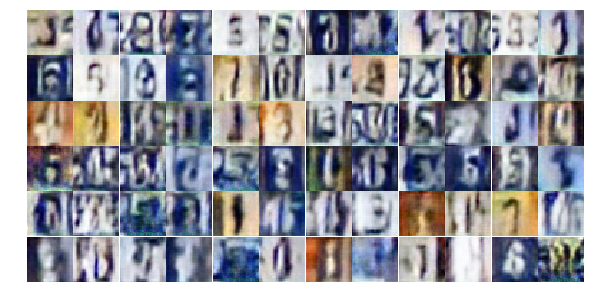

Epoch 17/25... Discriminator Loss: 1.3844... Generator Loss: 0.7011
Epoch 17/25... Discriminator Loss: 1.3893... Generator Loss: 0.6911
Epoch 17/25... Discriminator Loss: 1.2507... Generator Loss: 0.8444
Epoch 17/25... Discriminator Loss: 1.3385... Generator Loss: 0.7191
Epoch 17/25... Discriminator Loss: 1.3014... Generator Loss: 0.7171
Epoch 17/25... Discriminator Loss: 1.3620... Generator Loss: 0.7314
Epoch 17/25... Discriminator Loss: 1.3405... Generator Loss: 0.7727
Epoch 17/25... Discriminator Loss: 1.3553... Generator Loss: 0.7069
Epoch 17/25... Discriminator Loss: 1.3138... Generator Loss: 0.7239
Epoch 17/25... Discriminator Loss: 1.2870... Generator Loss: 0.7389


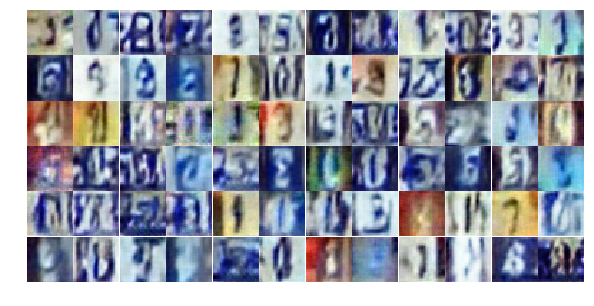

Epoch 17/25... Discriminator Loss: 1.4087... Generator Loss: 0.6626
Epoch 17/25... Discriminator Loss: 1.4348... Generator Loss: 0.6492
Epoch 17/25... Discriminator Loss: 1.4102... Generator Loss: 0.6985
Epoch 17/25... Discriminator Loss: 1.4072... Generator Loss: 0.6954
Epoch 17/25... Discriminator Loss: 1.3481... Generator Loss: 0.7125
Epoch 17/25... Discriminator Loss: 1.4241... Generator Loss: 0.6828
Epoch 17/25... Discriminator Loss: 1.2839... Generator Loss: 0.7672
Epoch 17/25... Discriminator Loss: 1.3615... Generator Loss: 0.6731
Epoch 17/25... Discriminator Loss: 1.4683... Generator Loss: 0.6680
Epoch 17/25... Discriminator Loss: 1.4049... Generator Loss: 0.6203


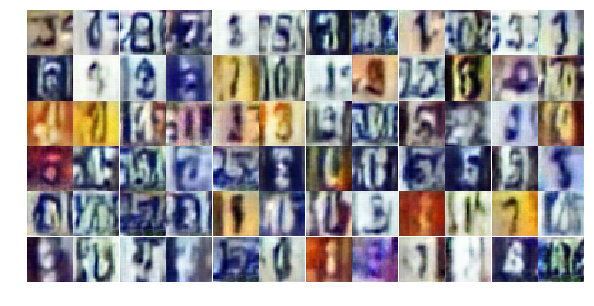

Epoch 17/25... Discriminator Loss: 1.6167... Generator Loss: 0.6020
Epoch 17/25... Discriminator Loss: 1.3368... Generator Loss: 0.7043
Epoch 17/25... Discriminator Loss: 1.2585... Generator Loss: 0.7855
Epoch 17/25... Discriminator Loss: 1.3646... Generator Loss: 0.7483
Epoch 17/25... Discriminator Loss: 1.5165... Generator Loss: 0.7180
Epoch 17/25... Discriminator Loss: 1.2159... Generator Loss: 0.8327
Epoch 17/25... Discriminator Loss: 1.4780... Generator Loss: 0.6268
Epoch 17/25... Discriminator Loss: 1.2401... Generator Loss: 0.7364
Epoch 17/25... Discriminator Loss: 1.3954... Generator Loss: 0.7270
Epoch 17/25... Discriminator Loss: 1.3017... Generator Loss: 0.7868


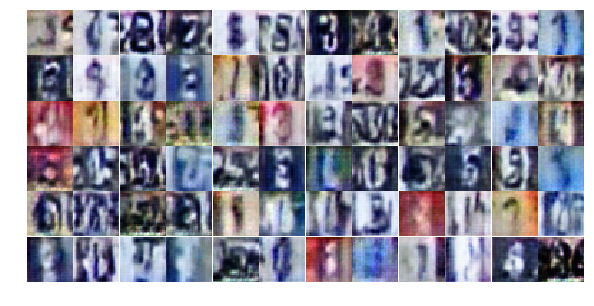

Epoch 17/25... Discriminator Loss: 1.4647... Generator Loss: 0.6425
Epoch 17/25... Discriminator Loss: 1.1933... Generator Loss: 0.8748
Epoch 17/25... Discriminator Loss: 1.3974... Generator Loss: 0.6157
Epoch 17/25... Discriminator Loss: 1.4482... Generator Loss: 0.6578
Epoch 17/25... Discriminator Loss: 1.3208... Generator Loss: 0.8711
Epoch 17/25... Discriminator Loss: 1.3084... Generator Loss: 0.8071
Epoch 17/25... Discriminator Loss: 1.4671... Generator Loss: 0.7514
Epoch 17/25... Discriminator Loss: 1.3700... Generator Loss: 0.7003
Epoch 17/25... Discriminator Loss: 1.3755... Generator Loss: 0.7361
Epoch 17/25... Discriminator Loss: 1.4161... Generator Loss: 0.6603


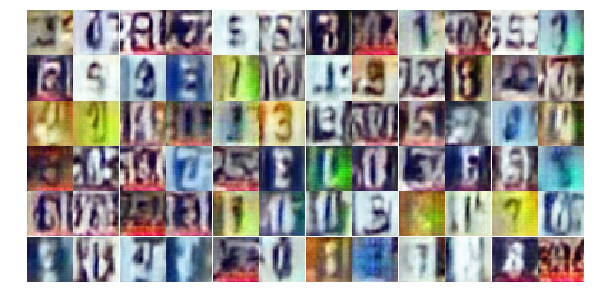

Epoch 17/25... Discriminator Loss: 1.4507... Generator Loss: 0.6641
Epoch 17/25... Discriminator Loss: 1.3729... Generator Loss: 0.6778
Epoch 17/25... Discriminator Loss: 1.1614... Generator Loss: 0.8841
Epoch 17/25... Discriminator Loss: 1.3334... Generator Loss: 0.7280
Epoch 18/25... Discriminator Loss: 1.4229... Generator Loss: 0.6809
Epoch 18/25... Discriminator Loss: 1.2988... Generator Loss: 0.7541
Epoch 18/25... Discriminator Loss: 1.5514... Generator Loss: 0.6884
Epoch 18/25... Discriminator Loss: 1.3288... Generator Loss: 0.7805
Epoch 18/25... Discriminator Loss: 1.2750... Generator Loss: 0.6987
Epoch 18/25... Discriminator Loss: 1.4031... Generator Loss: 0.6608


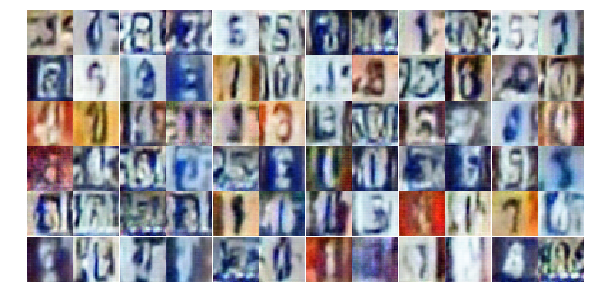

Epoch 18/25... Discriminator Loss: 1.3439... Generator Loss: 0.7194
Epoch 18/25... Discriminator Loss: 1.4576... Generator Loss: 0.6637
Epoch 18/25... Discriminator Loss: 1.4068... Generator Loss: 0.7077
Epoch 18/25... Discriminator Loss: 1.3210... Generator Loss: 0.7840
Epoch 18/25... Discriminator Loss: 1.2024... Generator Loss: 0.7674
Epoch 18/25... Discriminator Loss: 1.3927... Generator Loss: 0.6724
Epoch 18/25... Discriminator Loss: 1.3869... Generator Loss: 0.7687
Epoch 18/25... Discriminator Loss: 1.3466... Generator Loss: 0.7077
Epoch 18/25... Discriminator Loss: 1.3310... Generator Loss: 0.7410
Epoch 18/25... Discriminator Loss: 1.3356... Generator Loss: 0.7450


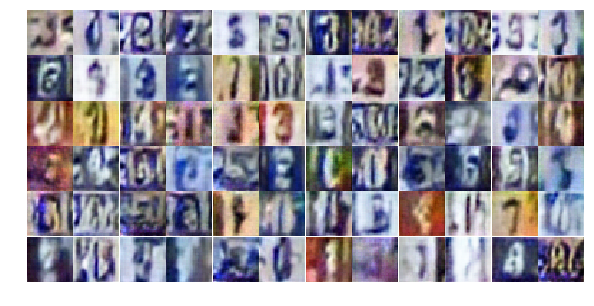

Epoch 18/25... Discriminator Loss: 1.3497... Generator Loss: 0.7401
Epoch 18/25... Discriminator Loss: 1.4088... Generator Loss: 0.7049
Epoch 18/25... Discriminator Loss: 1.4154... Generator Loss: 0.6676
Epoch 18/25... Discriminator Loss: 1.3289... Generator Loss: 0.7358
Epoch 18/25... Discriminator Loss: 1.3723... Generator Loss: 0.6874
Epoch 18/25... Discriminator Loss: 1.4138... Generator Loss: 0.6325
Epoch 18/25... Discriminator Loss: 1.3763... Generator Loss: 0.6716
Epoch 18/25... Discriminator Loss: 1.3574... Generator Loss: 0.7048
Epoch 18/25... Discriminator Loss: 1.4360... Generator Loss: 0.7134
Epoch 18/25... Discriminator Loss: 1.2169... Generator Loss: 0.7649


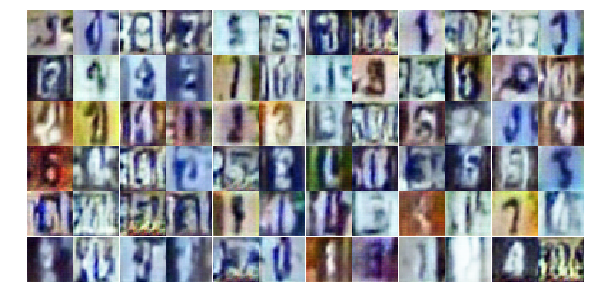

Epoch 18/25... Discriminator Loss: 1.4122... Generator Loss: 0.7153
Epoch 18/25... Discriminator Loss: 1.3461... Generator Loss: 0.7123
Epoch 18/25... Discriminator Loss: 1.5000... Generator Loss: 0.5475
Epoch 18/25... Discriminator Loss: 1.4053... Generator Loss: 0.6753
Epoch 18/25... Discriminator Loss: 1.3192... Generator Loss: 0.7256
Epoch 18/25... Discriminator Loss: 1.4879... Generator Loss: 0.6271
Epoch 18/25... Discriminator Loss: 1.2234... Generator Loss: 0.7532
Epoch 18/25... Discriminator Loss: 1.2300... Generator Loss: 0.7583
Epoch 18/25... Discriminator Loss: 1.2855... Generator Loss: 0.8236
Epoch 18/25... Discriminator Loss: 1.3109... Generator Loss: 0.7688


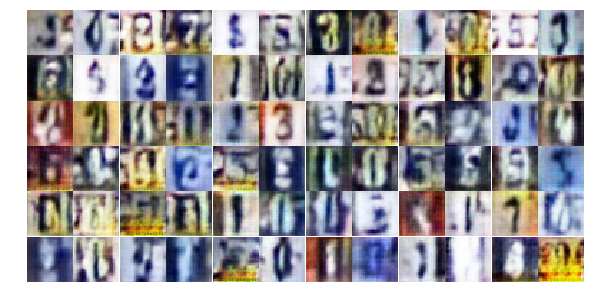

Epoch 18/25... Discriminator Loss: 1.3580... Generator Loss: 0.7174
Epoch 18/25... Discriminator Loss: 1.3363... Generator Loss: 0.6739
Epoch 18/25... Discriminator Loss: 1.3881... Generator Loss: 0.6809
Epoch 18/25... Discriminator Loss: 1.3775... Generator Loss: 0.6767
Epoch 18/25... Discriminator Loss: 1.3882... Generator Loss: 0.7114
Epoch 18/25... Discriminator Loss: 1.3415... Generator Loss: 0.7757
Epoch 18/25... Discriminator Loss: 1.3564... Generator Loss: 0.6957
Epoch 18/25... Discriminator Loss: 1.4116... Generator Loss: 0.6855
Epoch 18/25... Discriminator Loss: 1.3902... Generator Loss: 0.6823
Epoch 18/25... Discriminator Loss: 1.4341... Generator Loss: 0.6422


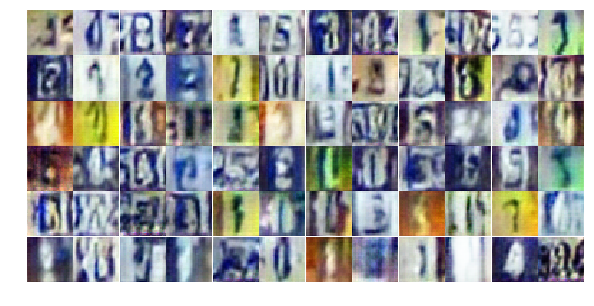

Epoch 18/25... Discriminator Loss: 1.4092... Generator Loss: 0.6386
Epoch 18/25... Discriminator Loss: 1.2591... Generator Loss: 0.7623
Epoch 18/25... Discriminator Loss: 1.3865... Generator Loss: 0.7093
Epoch 18/25... Discriminator Loss: 1.5326... Generator Loss: 0.6323
Epoch 18/25... Discriminator Loss: 1.3005... Generator Loss: 0.7743
Epoch 18/25... Discriminator Loss: 1.3130... Generator Loss: 0.7643
Epoch 18/25... Discriminator Loss: 1.3933... Generator Loss: 0.6914
Epoch 18/25... Discriminator Loss: 1.4098... Generator Loss: 0.7099
Epoch 18/25... Discriminator Loss: 1.3372... Generator Loss: 0.6873
Epoch 18/25... Discriminator Loss: 1.3782... Generator Loss: 0.7182


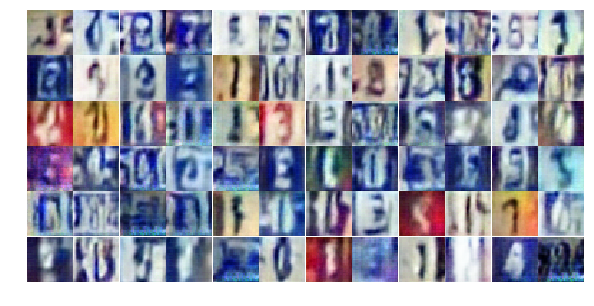

Epoch 18/25... Discriminator Loss: 1.3680... Generator Loss: 0.7099
Epoch 19/25... Discriminator Loss: 1.4413... Generator Loss: 0.6503
Epoch 19/25... Discriminator Loss: 1.4596... Generator Loss: 0.6386
Epoch 19/25... Discriminator Loss: 1.4229... Generator Loss: 0.6935
Epoch 19/25... Discriminator Loss: 1.5024... Generator Loss: 0.7017
Epoch 19/25... Discriminator Loss: 1.4117... Generator Loss: 0.7184
Epoch 19/25... Discriminator Loss: 1.3659... Generator Loss: 0.7052
Epoch 19/25... Discriminator Loss: 1.3939... Generator Loss: 0.7360
Epoch 19/25... Discriminator Loss: 1.3697... Generator Loss: 0.6658
Epoch 19/25... Discriminator Loss: 1.4293... Generator Loss: 0.7163


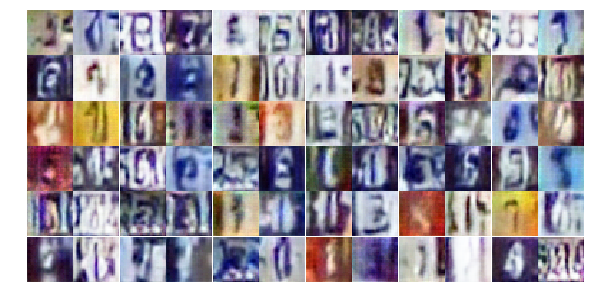

Epoch 19/25... Discriminator Loss: 1.4173... Generator Loss: 0.6579
Epoch 19/25... Discriminator Loss: 1.3497... Generator Loss: 0.7020
Epoch 19/25... Discriminator Loss: 1.3677... Generator Loss: 0.6892
Epoch 19/25... Discriminator Loss: 1.3684... Generator Loss: 0.7400
Epoch 19/25... Discriminator Loss: 1.3264... Generator Loss: 0.7108
Epoch 19/25... Discriminator Loss: 1.4141... Generator Loss: 0.6428
Epoch 19/25... Discriminator Loss: 1.3079... Generator Loss: 0.7102
Epoch 19/25... Discriminator Loss: 1.3854... Generator Loss: 0.7735
Epoch 19/25... Discriminator Loss: 1.4007... Generator Loss: 0.6172
Epoch 19/25... Discriminator Loss: 1.4768... Generator Loss: 0.6925


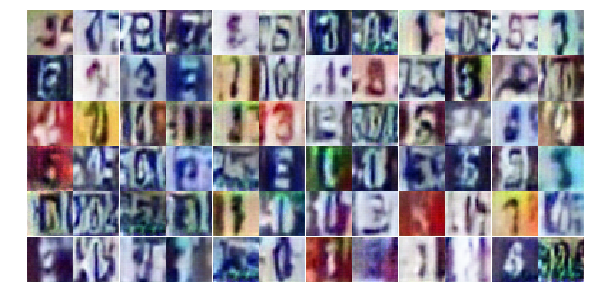

Epoch 19/25... Discriminator Loss: 1.3310... Generator Loss: 0.6409
Epoch 19/25... Discriminator Loss: 1.3982... Generator Loss: 0.6565
Epoch 19/25... Discriminator Loss: 1.4237... Generator Loss: 0.6418
Epoch 19/25... Discriminator Loss: 1.3805... Generator Loss: 0.6565
Epoch 19/25... Discriminator Loss: 1.3138... Generator Loss: 0.7063
Epoch 19/25... Discriminator Loss: 1.5729... Generator Loss: 0.5817
Epoch 19/25... Discriminator Loss: 1.1543... Generator Loss: 0.8062
Epoch 19/25... Discriminator Loss: 1.5789... Generator Loss: 0.5286
Epoch 19/25... Discriminator Loss: 1.3437... Generator Loss: 0.6841
Epoch 19/25... Discriminator Loss: 1.4725... Generator Loss: 0.6899


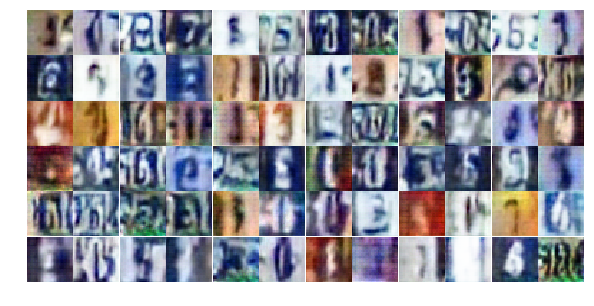

Epoch 19/25... Discriminator Loss: 1.3663... Generator Loss: 0.7857
Epoch 19/25... Discriminator Loss: 1.4456... Generator Loss: 0.7047
Epoch 19/25... Discriminator Loss: 1.4368... Generator Loss: 0.7121
Epoch 19/25... Discriminator Loss: 1.3491... Generator Loss: 0.7261
Epoch 19/25... Discriminator Loss: 1.4145... Generator Loss: 0.7348
Epoch 19/25... Discriminator Loss: 1.1356... Generator Loss: 0.8814
Epoch 19/25... Discriminator Loss: 1.4143... Generator Loss: 0.6546
Epoch 19/25... Discriminator Loss: 1.4156... Generator Loss: 0.7302
Epoch 19/25... Discriminator Loss: 1.3840... Generator Loss: 0.6697
Epoch 19/25... Discriminator Loss: 1.3333... Generator Loss: 0.6950


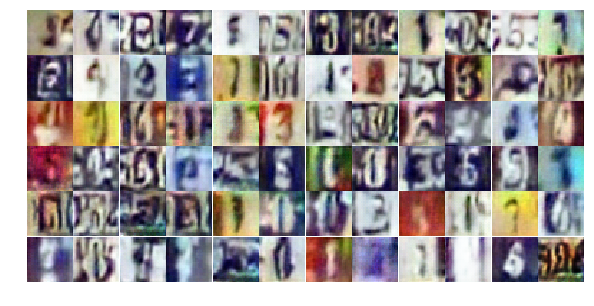

Epoch 19/25... Discriminator Loss: 1.5402... Generator Loss: 0.5752
Epoch 19/25... Discriminator Loss: 1.2913... Generator Loss: 0.7420
Epoch 19/25... Discriminator Loss: 1.4149... Generator Loss: 0.6429
Epoch 19/25... Discriminator Loss: 1.3136... Generator Loss: 0.8041
Epoch 19/25... Discriminator Loss: 1.4353... Generator Loss: 0.6701
Epoch 19/25... Discriminator Loss: 1.3204... Generator Loss: 0.7313
Epoch 19/25... Discriminator Loss: 1.4256... Generator Loss: 0.6677
Epoch 19/25... Discriminator Loss: 1.3724... Generator Loss: 0.7014
Epoch 19/25... Discriminator Loss: 1.4059... Generator Loss: 0.6741
Epoch 19/25... Discriminator Loss: 1.2835... Generator Loss: 0.7782


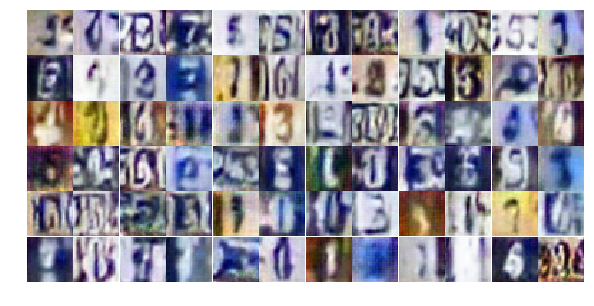

Epoch 19/25... Discriminator Loss: 1.3799... Generator Loss: 0.6550
Epoch 19/25... Discriminator Loss: 1.2763... Generator Loss: 0.7589
Epoch 19/25... Discriminator Loss: 1.4021... Generator Loss: 0.5932
Epoch 19/25... Discriminator Loss: 1.4135... Generator Loss: 0.5941
Epoch 19/25... Discriminator Loss: 1.5236... Generator Loss: 0.5855
Epoch 19/25... Discriminator Loss: 1.2546... Generator Loss: 0.7957
Epoch 19/25... Discriminator Loss: 1.4645... Generator Loss: 0.6036
Epoch 19/25... Discriminator Loss: 1.3779... Generator Loss: 0.6757
Epoch 20/25... Discriminator Loss: 1.3642... Generator Loss: 0.6955
Epoch 20/25... Discriminator Loss: 1.2819... Generator Loss: 0.7506


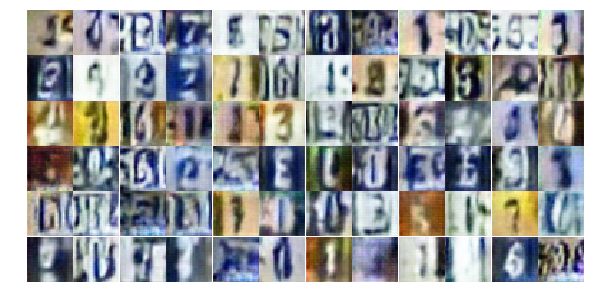

Epoch 20/25... Discriminator Loss: 1.3491... Generator Loss: 0.7142
Epoch 20/25... Discriminator Loss: 1.4163... Generator Loss: 0.6952
Epoch 20/25... Discriminator Loss: 1.4329... Generator Loss: 0.6523
Epoch 20/25... Discriminator Loss: 1.5151... Generator Loss: 0.6122
Epoch 20/25... Discriminator Loss: 1.3974... Generator Loss: 0.7290
Epoch 20/25... Discriminator Loss: 1.3441... Generator Loss: 0.7202
Epoch 20/25... Discriminator Loss: 1.4843... Generator Loss: 0.6615
Epoch 20/25... Discriminator Loss: 1.3491... Generator Loss: 0.7064
Epoch 20/25... Discriminator Loss: 1.3775... Generator Loss: 0.7136
Epoch 20/25... Discriminator Loss: 1.3395... Generator Loss: 0.6957


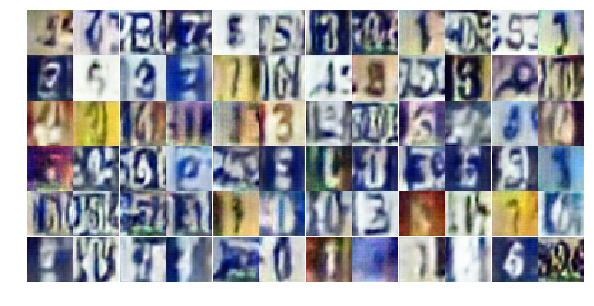

Epoch 20/25... Discriminator Loss: 1.4359... Generator Loss: 0.6685
Epoch 20/25... Discriminator Loss: 1.4079... Generator Loss: 0.6689
Epoch 20/25... Discriminator Loss: 1.3994... Generator Loss: 0.6601
Epoch 20/25... Discriminator Loss: 1.2858... Generator Loss: 0.7181
Epoch 20/25... Discriminator Loss: 1.3807... Generator Loss: 0.7422
Epoch 20/25... Discriminator Loss: 1.3535... Generator Loss: 0.7434
Epoch 20/25... Discriminator Loss: 1.4314... Generator Loss: 0.6654
Epoch 20/25... Discriminator Loss: 1.3650... Generator Loss: 0.7269
Epoch 20/25... Discriminator Loss: 1.3871... Generator Loss: 0.7250
Epoch 20/25... Discriminator Loss: 1.3718... Generator Loss: 0.6930


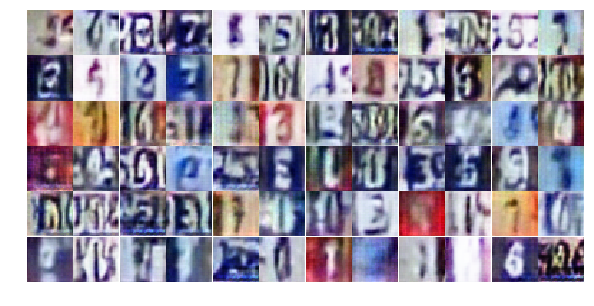

Epoch 20/25... Discriminator Loss: 1.3129... Generator Loss: 0.7347
Epoch 20/25... Discriminator Loss: 1.4111... Generator Loss: 0.6906
Epoch 20/25... Discriminator Loss: 1.3487... Generator Loss: 0.7207
Epoch 20/25... Discriminator Loss: 1.3448... Generator Loss: 0.7354
Epoch 20/25... Discriminator Loss: 1.3576... Generator Loss: 0.7142
Epoch 20/25... Discriminator Loss: 1.3296... Generator Loss: 0.7381
Epoch 20/25... Discriminator Loss: 1.4624... Generator Loss: 0.6484
Epoch 20/25... Discriminator Loss: 1.4025... Generator Loss: 0.6397
Epoch 20/25... Discriminator Loss: 1.3543... Generator Loss: 0.7276
Epoch 20/25... Discriminator Loss: 1.2386... Generator Loss: 0.8317


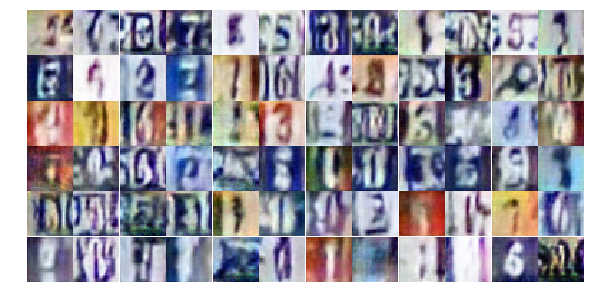

Epoch 20/25... Discriminator Loss: 1.1827... Generator Loss: 0.7925
Epoch 20/25... Discriminator Loss: 1.4157... Generator Loss: 0.6422
Epoch 20/25... Discriminator Loss: 1.3385... Generator Loss: 0.6806
Epoch 20/25... Discriminator Loss: 1.4365... Generator Loss: 0.6610
Epoch 20/25... Discriminator Loss: 1.4110... Generator Loss: 0.7087
Epoch 20/25... Discriminator Loss: 1.2861... Generator Loss: 0.7306
Epoch 20/25... Discriminator Loss: 1.4560... Generator Loss: 0.6170
Epoch 20/25... Discriminator Loss: 1.2613... Generator Loss: 0.7713
Epoch 20/25... Discriminator Loss: 1.5013... Generator Loss: 0.5715
Epoch 20/25... Discriminator Loss: 1.1995... Generator Loss: 0.8240


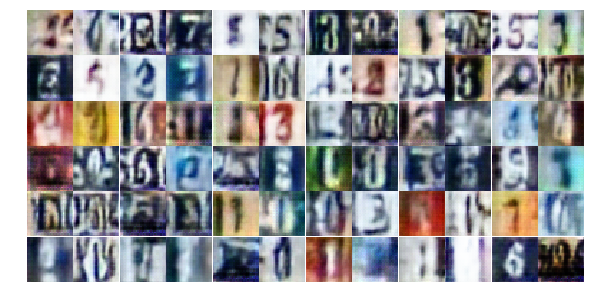

Epoch 20/25... Discriminator Loss: 1.5390... Generator Loss: 0.6232
Epoch 20/25... Discriminator Loss: 1.3678... Generator Loss: 0.6706
Epoch 20/25... Discriminator Loss: 1.4923... Generator Loss: 0.5783
Epoch 20/25... Discriminator Loss: 1.4123... Generator Loss: 0.7438
Epoch 20/25... Discriminator Loss: 1.3509... Generator Loss: 0.7770
Epoch 20/25... Discriminator Loss: 1.4460... Generator Loss: 0.6349
Epoch 20/25... Discriminator Loss: 1.3821... Generator Loss: 0.7120
Epoch 20/25... Discriminator Loss: 1.3472... Generator Loss: 0.7274
Epoch 20/25... Discriminator Loss: 1.3782... Generator Loss: 0.6519
Epoch 20/25... Discriminator Loss: 1.3580... Generator Loss: 0.7694


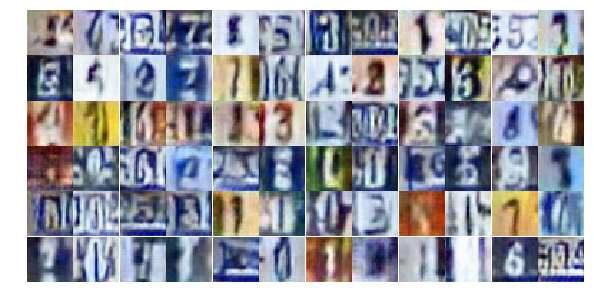

Epoch 20/25... Discriminator Loss: 1.3686... Generator Loss: 0.7442
Epoch 20/25... Discriminator Loss: 1.3646... Generator Loss: 0.6737
Epoch 20/25... Discriminator Loss: 1.3212... Generator Loss: 0.7769
Epoch 20/25... Discriminator Loss: 1.4799... Generator Loss: 0.6292
Epoch 20/25... Discriminator Loss: 1.3560... Generator Loss: 0.7931
Epoch 20/25... Discriminator Loss: 1.3548... Generator Loss: 0.7129
Epoch 21/25... Discriminator Loss: 1.3747... Generator Loss: 0.6822
Epoch 21/25... Discriminator Loss: 1.4264... Generator Loss: 0.6499
Epoch 21/25... Discriminator Loss: 1.2687... Generator Loss: 0.6619
Epoch 21/25... Discriminator Loss: 1.3600... Generator Loss: 0.7422


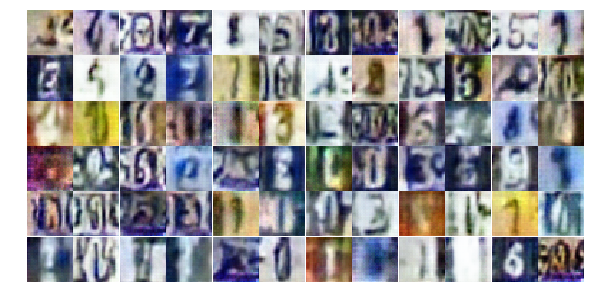

Epoch 21/25... Discriminator Loss: 1.1871... Generator Loss: 0.8763
Epoch 21/25... Discriminator Loss: 1.4575... Generator Loss: 0.6006
Epoch 21/25... Discriminator Loss: 1.3264... Generator Loss: 0.7205
Epoch 21/25... Discriminator Loss: 1.4041... Generator Loss: 0.6912
Epoch 21/25... Discriminator Loss: 1.3513... Generator Loss: 0.6796
Epoch 21/25... Discriminator Loss: 1.2790... Generator Loss: 0.8133
Epoch 21/25... Discriminator Loss: 1.3688... Generator Loss: 0.7277
Epoch 21/25... Discriminator Loss: 1.2585... Generator Loss: 0.7781
Epoch 21/25... Discriminator Loss: 1.3658... Generator Loss: 0.7383
Epoch 21/25... Discriminator Loss: 1.3410... Generator Loss: 0.7458


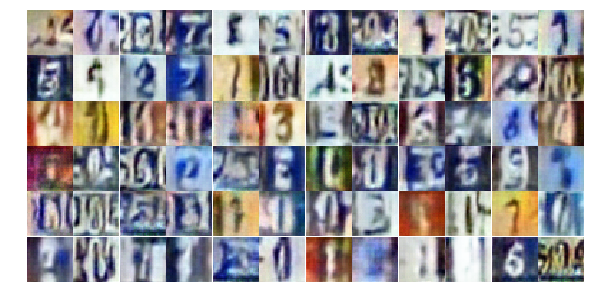

Epoch 21/25... Discriminator Loss: 1.3137... Generator Loss: 0.7823
Epoch 21/25... Discriminator Loss: 1.3503... Generator Loss: 0.7789
Epoch 21/25... Discriminator Loss: 1.3857... Generator Loss: 0.6688
Epoch 21/25... Discriminator Loss: 1.3616... Generator Loss: 0.6979
Epoch 21/25... Discriminator Loss: 1.2526... Generator Loss: 0.7877
Epoch 21/25... Discriminator Loss: 1.3944... Generator Loss: 0.6734
Epoch 21/25... Discriminator Loss: 1.3636... Generator Loss: 0.6751
Epoch 21/25... Discriminator Loss: 1.4757... Generator Loss: 0.6716
Epoch 21/25... Discriminator Loss: 1.3381... Generator Loss: 0.7217
Epoch 21/25... Discriminator Loss: 1.3703... Generator Loss: 0.6893


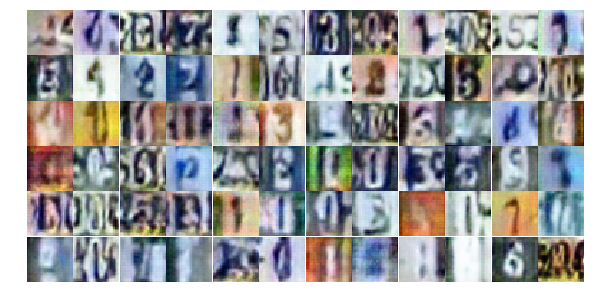

Epoch 21/25... Discriminator Loss: 1.4403... Generator Loss: 0.6966
Epoch 21/25... Discriminator Loss: 1.4456... Generator Loss: 0.7274
Epoch 21/25... Discriminator Loss: 1.4290... Generator Loss: 0.6578
Epoch 21/25... Discriminator Loss: 1.3809... Generator Loss: 0.6709
Epoch 21/25... Discriminator Loss: 1.3405... Generator Loss: 0.7583
Epoch 21/25... Discriminator Loss: 1.3384... Generator Loss: 0.7054
Epoch 21/25... Discriminator Loss: 1.3933... Generator Loss: 0.6997
Epoch 21/25... Discriminator Loss: 1.3534... Generator Loss: 0.6796
Epoch 21/25... Discriminator Loss: 1.2430... Generator Loss: 0.7542
Epoch 21/25... Discriminator Loss: 1.4728... Generator Loss: 0.8262


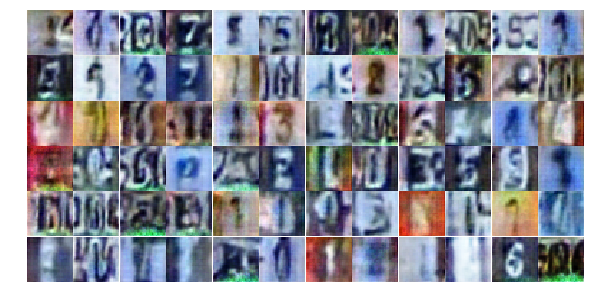

Epoch 21/25... Discriminator Loss: 1.3940... Generator Loss: 0.7080
Epoch 21/25... Discriminator Loss: 1.3550... Generator Loss: 0.7143
Epoch 21/25... Discriminator Loss: 1.3224... Generator Loss: 0.7303
Epoch 21/25... Discriminator Loss: 1.6213... Generator Loss: 0.6234
Epoch 21/25... Discriminator Loss: 1.1150... Generator Loss: 0.8581
Epoch 21/25... Discriminator Loss: 1.4178... Generator Loss: 0.6763
Epoch 21/25... Discriminator Loss: 1.4101... Generator Loss: 0.6574
Epoch 21/25... Discriminator Loss: 1.4512... Generator Loss: 0.9130
Epoch 21/25... Discriminator Loss: 1.7680... Generator Loss: 0.4900
Epoch 21/25... Discriminator Loss: 1.1838... Generator Loss: 1.0167


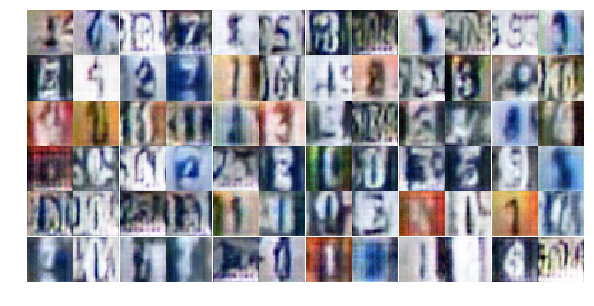

Epoch 21/25... Discriminator Loss: 1.3940... Generator Loss: 0.6160
Epoch 21/25... Discriminator Loss: 1.3713... Generator Loss: 0.6827
Epoch 21/25... Discriminator Loss: 1.3001... Generator Loss: 0.7293
Epoch 21/25... Discriminator Loss: 1.4104... Generator Loss: 0.7156
Epoch 21/25... Discriminator Loss: 1.3295... Generator Loss: 0.7342
Epoch 21/25... Discriminator Loss: 1.4234... Generator Loss: 0.6644
Epoch 21/25... Discriminator Loss: 1.3388... Generator Loss: 0.7849
Epoch 21/25... Discriminator Loss: 1.3860... Generator Loss: 0.6647
Epoch 21/25... Discriminator Loss: 1.4051... Generator Loss: 0.6495
Epoch 21/25... Discriminator Loss: 1.4238... Generator Loss: 0.6958


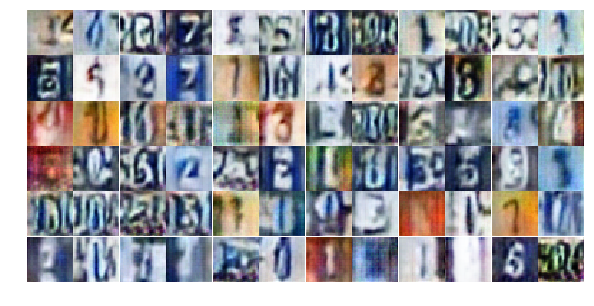

Epoch 21/25... Discriminator Loss: 1.3288... Generator Loss: 0.7234
Epoch 21/25... Discriminator Loss: 1.4139... Generator Loss: 0.6472
Epoch 21/25... Discriminator Loss: 1.4848... Generator Loss: 0.6659
Epoch 22/25... Discriminator Loss: 1.3578... Generator Loss: 0.7108
Epoch 22/25... Discriminator Loss: 1.4509... Generator Loss: 0.6499
Epoch 22/25... Discriminator Loss: 1.3769... Generator Loss: 0.6848
Epoch 22/25... Discriminator Loss: 1.4456... Generator Loss: 0.6904
Epoch 22/25... Discriminator Loss: 1.3465... Generator Loss: 0.7253
Epoch 22/25... Discriminator Loss: 1.3693... Generator Loss: 0.7148
Epoch 22/25... Discriminator Loss: 1.3519... Generator Loss: 0.7180


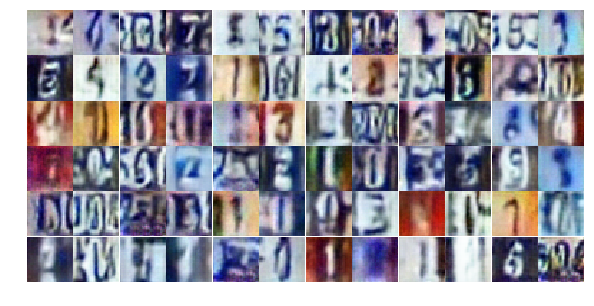

Epoch 22/25... Discriminator Loss: 1.3902... Generator Loss: 0.6746
Epoch 22/25... Discriminator Loss: 1.3762... Generator Loss: 0.7179
Epoch 22/25... Discriminator Loss: 1.4057... Generator Loss: 0.7148
Epoch 22/25... Discriminator Loss: 1.3235... Generator Loss: 0.7220
Epoch 22/25... Discriminator Loss: 1.4025... Generator Loss: 0.6342
Epoch 22/25... Discriminator Loss: 1.3474... Generator Loss: 0.6714
Epoch 22/25... Discriminator Loss: 1.3744... Generator Loss: 0.6720
Epoch 22/25... Discriminator Loss: 1.3615... Generator Loss: 0.7083
Epoch 22/25... Discriminator Loss: 1.4778... Generator Loss: 0.6768
Epoch 22/25... Discriminator Loss: 1.4782... Generator Loss: 0.6458


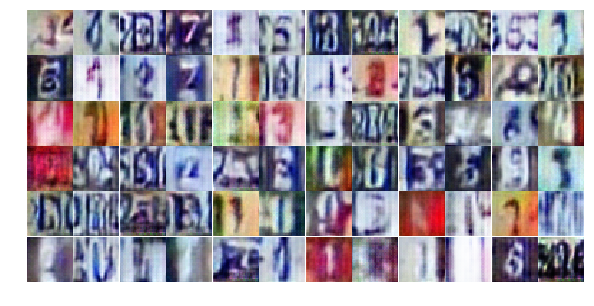

Epoch 22/25... Discriminator Loss: 1.4266... Generator Loss: 0.6275
Epoch 22/25... Discriminator Loss: 1.4127... Generator Loss: 0.7218
Epoch 22/25... Discriminator Loss: 1.3746... Generator Loss: 0.6788
Epoch 22/25... Discriminator Loss: 1.4204... Generator Loss: 0.7361
Epoch 22/25... Discriminator Loss: 1.3297... Generator Loss: 0.6648
Epoch 22/25... Discriminator Loss: 1.3116... Generator Loss: 0.7530
Epoch 22/25... Discriminator Loss: 1.3336... Generator Loss: 0.7282
Epoch 22/25... Discriminator Loss: 1.4312... Generator Loss: 0.6600
Epoch 22/25... Discriminator Loss: 1.2074... Generator Loss: 0.8700
Epoch 22/25... Discriminator Loss: 1.2099... Generator Loss: 0.7285


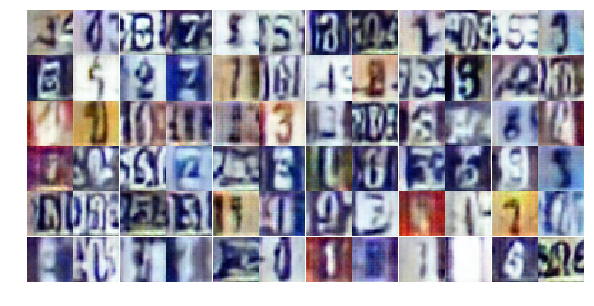

Epoch 22/25... Discriminator Loss: 1.3177... Generator Loss: 0.7575
Epoch 22/25... Discriminator Loss: 1.3781... Generator Loss: 0.6801
Epoch 22/25... Discriminator Loss: 1.0778... Generator Loss: 0.8659
Epoch 22/25... Discriminator Loss: 1.3640... Generator Loss: 0.7179
Epoch 22/25... Discriminator Loss: 1.3193... Generator Loss: 0.7052
Epoch 22/25... Discriminator Loss: 1.3154... Generator Loss: 0.6991
Epoch 22/25... Discriminator Loss: 1.4513... Generator Loss: 0.6214
Epoch 22/25... Discriminator Loss: 1.3639... Generator Loss: 0.7213
Epoch 22/25... Discriminator Loss: 1.4660... Generator Loss: 0.6930
Epoch 22/25... Discriminator Loss: 1.3674... Generator Loss: 0.7114


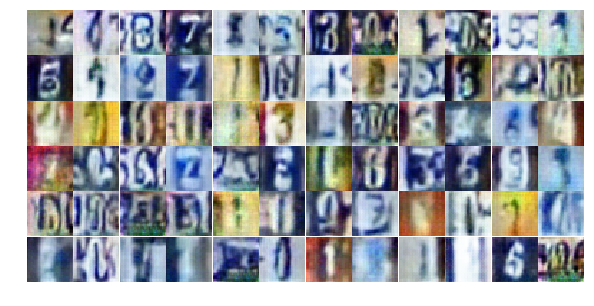

Epoch 22/25... Discriminator Loss: 1.3825... Generator Loss: 0.6758
Epoch 22/25... Discriminator Loss: 1.4208... Generator Loss: 0.7212
Epoch 22/25... Discriminator Loss: 1.2867... Generator Loss: 0.7763
Epoch 22/25... Discriminator Loss: 1.3810... Generator Loss: 0.7181
Epoch 22/25... Discriminator Loss: 1.3862... Generator Loss: 0.6897
Epoch 22/25... Discriminator Loss: 1.4717... Generator Loss: 0.6517
Epoch 22/25... Discriminator Loss: 1.4655... Generator Loss: 0.6605
Epoch 22/25... Discriminator Loss: 1.1781... Generator Loss: 0.8930
Epoch 22/25... Discriminator Loss: 1.3350... Generator Loss: 0.7909
Epoch 22/25... Discriminator Loss: 1.2702... Generator Loss: 0.7657


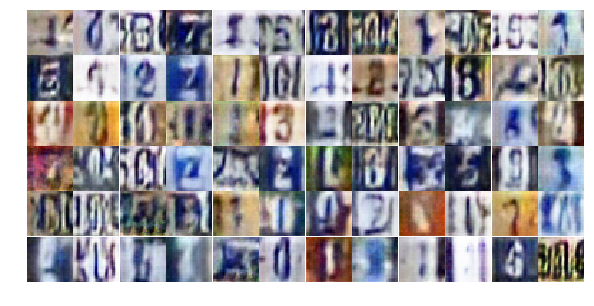

Epoch 22/25... Discriminator Loss: 1.4634... Generator Loss: 0.6470
Epoch 22/25... Discriminator Loss: 1.4997... Generator Loss: 0.6828
Epoch 22/25... Discriminator Loss: 1.4167... Generator Loss: 0.6191
Epoch 22/25... Discriminator Loss: 1.2981... Generator Loss: 0.7213
Epoch 22/25... Discriminator Loss: 1.2614... Generator Loss: 0.7539
Epoch 22/25... Discriminator Loss: 1.4141... Generator Loss: 0.8041
Epoch 22/25... Discriminator Loss: 1.3207... Generator Loss: 0.6937
Epoch 22/25... Discriminator Loss: 1.3820... Generator Loss: 0.6795
Epoch 22/25... Discriminator Loss: 1.4652... Generator Loss: 0.6590
Epoch 22/25... Discriminator Loss: 1.3835... Generator Loss: 0.7374


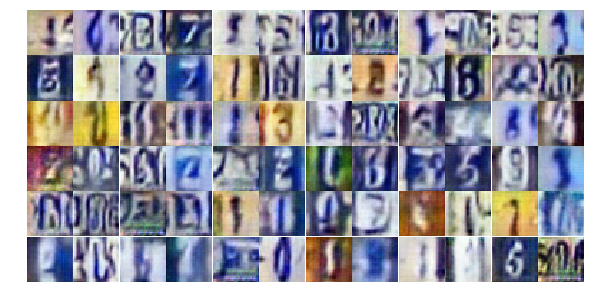

Epoch 23/25... Discriminator Loss: 1.2705... Generator Loss: 0.8150
Epoch 23/25... Discriminator Loss: 1.3693... Generator Loss: 0.6823
Epoch 23/25... Discriminator Loss: 1.4359... Generator Loss: 0.6649
Epoch 23/25... Discriminator Loss: 1.3973... Generator Loss: 0.6576
Epoch 23/25... Discriminator Loss: 1.2983... Generator Loss: 0.7319
Epoch 23/25... Discriminator Loss: 1.3470... Generator Loss: 0.7051
Epoch 23/25... Discriminator Loss: 1.3793... Generator Loss: 0.6961
Epoch 23/25... Discriminator Loss: 1.4527... Generator Loss: 0.6942
Epoch 23/25... Discriminator Loss: 1.3925... Generator Loss: 0.7131
Epoch 23/25... Discriminator Loss: 1.4011... Generator Loss: 0.6814


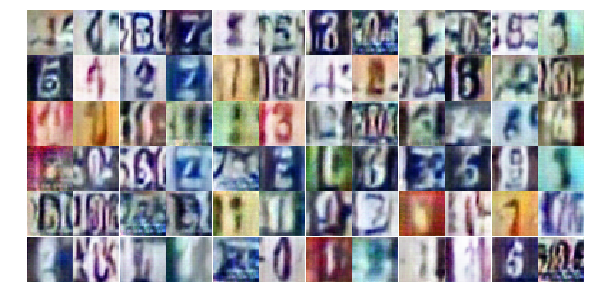

Epoch 23/25... Discriminator Loss: 1.4661... Generator Loss: 0.6529
Epoch 23/25... Discriminator Loss: 1.3318... Generator Loss: 0.7434
Epoch 23/25... Discriminator Loss: 1.4077... Generator Loss: 0.6202
Epoch 23/25... Discriminator Loss: 1.4171... Generator Loss: 0.7156
Epoch 23/25... Discriminator Loss: 1.2233... Generator Loss: 0.8025
Epoch 23/25... Discriminator Loss: 1.4101... Generator Loss: 0.6870
Epoch 23/25... Discriminator Loss: 1.3350... Generator Loss: 0.6834
Epoch 23/25... Discriminator Loss: 1.3102... Generator Loss: 0.6947
Epoch 23/25... Discriminator Loss: 1.4792... Generator Loss: 0.6890
Epoch 23/25... Discriminator Loss: 1.1421... Generator Loss: 0.8209


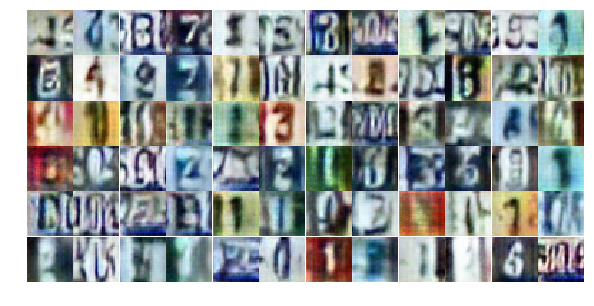

Epoch 23/25... Discriminator Loss: 1.4575... Generator Loss: 0.6519
Epoch 23/25... Discriminator Loss: 1.3724... Generator Loss: 0.7172
Epoch 23/25... Discriminator Loss: 1.1545... Generator Loss: 0.8248
Epoch 23/25... Discriminator Loss: 1.3497... Generator Loss: 0.6724
Epoch 23/25... Discriminator Loss: 1.3693... Generator Loss: 0.7439
Epoch 23/25... Discriminator Loss: 1.3506... Generator Loss: 0.7358
Epoch 23/25... Discriminator Loss: 1.3717... Generator Loss: 0.7200
Epoch 23/25... Discriminator Loss: 1.4037... Generator Loss: 0.6984
Epoch 23/25... Discriminator Loss: 1.3535... Generator Loss: 0.6794
Epoch 23/25... Discriminator Loss: 1.4352... Generator Loss: 0.6311


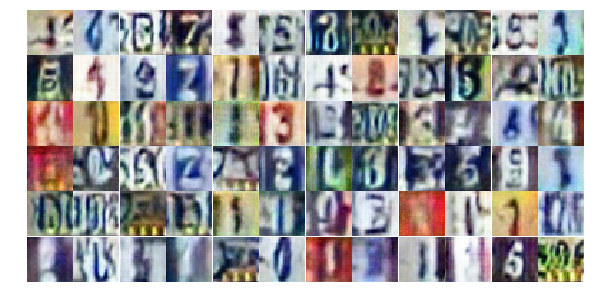

Epoch 23/25... Discriminator Loss: 1.4057... Generator Loss: 0.6990
Epoch 23/25... Discriminator Loss: 1.3486... Generator Loss: 0.7655
Epoch 23/25... Discriminator Loss: 1.4386... Generator Loss: 0.6551
Epoch 23/25... Discriminator Loss: 1.4018... Generator Loss: 0.6282
Epoch 23/25... Discriminator Loss: 1.4278... Generator Loss: 0.6990
Epoch 23/25... Discriminator Loss: 1.4338... Generator Loss: 0.6807
Epoch 23/25... Discriminator Loss: 1.4300... Generator Loss: 0.6445
Epoch 23/25... Discriminator Loss: 1.3108... Generator Loss: 0.7354
Epoch 23/25... Discriminator Loss: 1.4520... Generator Loss: 0.6547
Epoch 23/25... Discriminator Loss: 1.4295... Generator Loss: 0.6960


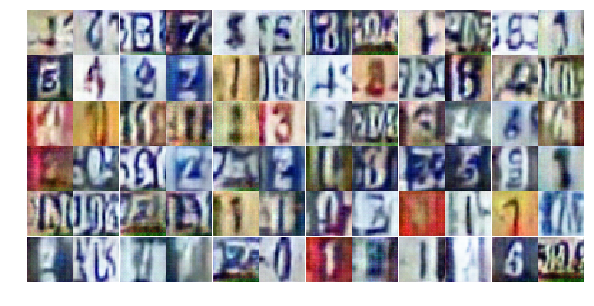

Epoch 23/25... Discriminator Loss: 1.3461... Generator Loss: 0.7156
Epoch 23/25... Discriminator Loss: 1.3305... Generator Loss: 0.6737
Epoch 23/25... Discriminator Loss: 1.4264... Generator Loss: 0.6749
Epoch 23/25... Discriminator Loss: 1.4244... Generator Loss: 0.6978
Epoch 23/25... Discriminator Loss: 1.2751... Generator Loss: 0.7774
Epoch 23/25... Discriminator Loss: 1.4138... Generator Loss: 0.6340
Epoch 23/25... Discriminator Loss: 1.3757... Generator Loss: 0.6889
Epoch 23/25... Discriminator Loss: 1.3780... Generator Loss: 0.6852
Epoch 23/25... Discriminator Loss: 1.3838... Generator Loss: 0.7395
Epoch 23/25... Discriminator Loss: 1.2804... Generator Loss: 0.7641


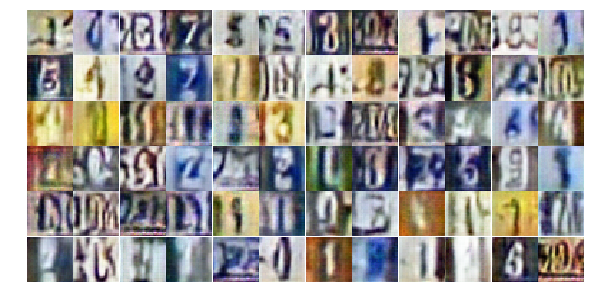

Epoch 23/25... Discriminator Loss: 1.5409... Generator Loss: 0.7442
Epoch 23/25... Discriminator Loss: 1.3686... Generator Loss: 0.7143
Epoch 23/25... Discriminator Loss: 1.3930... Generator Loss: 0.6989
Epoch 23/25... Discriminator Loss: 1.2944... Generator Loss: 0.7235
Epoch 23/25... Discriminator Loss: 1.3964... Generator Loss: 0.6818
Epoch 23/25... Discriminator Loss: 1.4048... Generator Loss: 0.7229
Epoch 23/25... Discriminator Loss: 1.3808... Generator Loss: 0.6850
Epoch 24/25... Discriminator Loss: 1.3048... Generator Loss: 0.7319
Epoch 24/25... Discriminator Loss: 1.4004... Generator Loss: 0.6637
Epoch 24/25... Discriminator Loss: 1.3818... Generator Loss: 0.6681


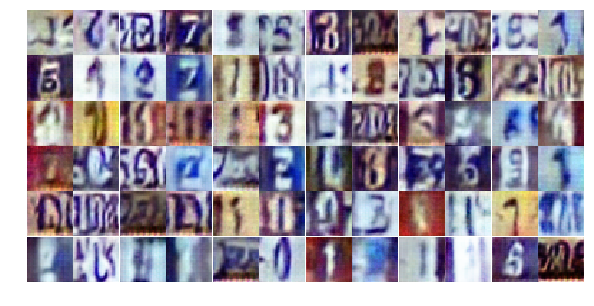

Epoch 24/25... Discriminator Loss: 1.1724... Generator Loss: 0.7740
Epoch 24/25... Discriminator Loss: 1.5475... Generator Loss: 0.6078
Epoch 24/25... Discriminator Loss: 1.4171... Generator Loss: 0.7186
Epoch 24/25... Discriminator Loss: 1.3066... Generator Loss: 0.7350
Epoch 24/25... Discriminator Loss: 1.4650... Generator Loss: 0.6166
Epoch 24/25... Discriminator Loss: 1.3458... Generator Loss: 0.6903
Epoch 24/25... Discriminator Loss: 1.3833... Generator Loss: 0.7038
Epoch 24/25... Discriminator Loss: 1.3499... Generator Loss: 0.6604
Epoch 24/25... Discriminator Loss: 1.3900... Generator Loss: 0.7208
Epoch 24/25... Discriminator Loss: 1.3010... Generator Loss: 0.7662


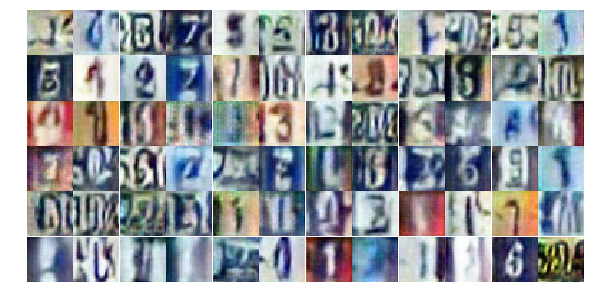

Epoch 24/25... Discriminator Loss: 1.3693... Generator Loss: 0.6684
Epoch 24/25... Discriminator Loss: 1.4575... Generator Loss: 0.6320
Epoch 24/25... Discriminator Loss: 1.3510... Generator Loss: 0.6848
Epoch 24/25... Discriminator Loss: 1.2669... Generator Loss: 0.7568
Epoch 24/25... Discriminator Loss: 1.4210... Generator Loss: 0.6603
Epoch 24/25... Discriminator Loss: 1.2970... Generator Loss: 0.7205
Epoch 24/25... Discriminator Loss: 1.3789... Generator Loss: 0.7457
Epoch 24/25... Discriminator Loss: 1.4759... Generator Loss: 0.6836
Epoch 24/25... Discriminator Loss: 1.4085... Generator Loss: 0.6274
Epoch 24/25... Discriminator Loss: 1.3757... Generator Loss: 0.7290


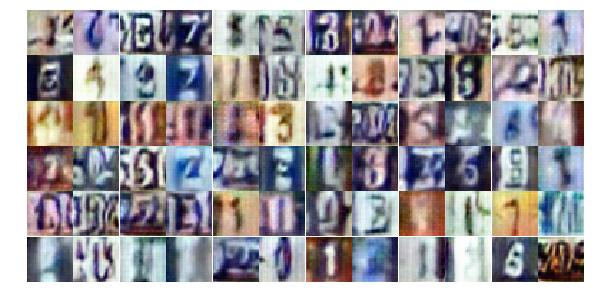

Epoch 24/25... Discriminator Loss: 1.3699... Generator Loss: 0.7423
Epoch 24/25... Discriminator Loss: 1.3635... Generator Loss: 0.6876
Epoch 24/25... Discriminator Loss: 1.4216... Generator Loss: 0.6672
Epoch 24/25... Discriminator Loss: 1.4264... Generator Loss: 0.6578
Epoch 24/25... Discriminator Loss: 1.3563... Generator Loss: 0.6882
Epoch 24/25... Discriminator Loss: 1.2263... Generator Loss: 0.7833
Epoch 24/25... Discriminator Loss: 1.3665... Generator Loss: 0.7038
Epoch 24/25... Discriminator Loss: 1.4276... Generator Loss: 0.6899
Epoch 24/25... Discriminator Loss: 1.3949... Generator Loss: 0.7177
Epoch 24/25... Discriminator Loss: 1.3259... Generator Loss: 0.6965


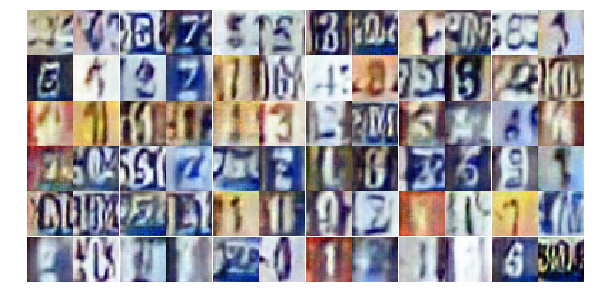

Epoch 24/25... Discriminator Loss: 1.4751... Generator Loss: 0.6971
Epoch 24/25... Discriminator Loss: 1.4575... Generator Loss: 0.6351
Epoch 24/25... Discriminator Loss: 1.3874... Generator Loss: 0.6804
Epoch 24/25... Discriminator Loss: 1.5411... Generator Loss: 0.5519
Epoch 24/25... Discriminator Loss: 1.3864... Generator Loss: 0.6593
Epoch 24/25... Discriminator Loss: 1.0651... Generator Loss: 0.8200
Epoch 24/25... Discriminator Loss: 1.4315... Generator Loss: 0.7489
Epoch 24/25... Discriminator Loss: 1.3216... Generator Loss: 0.7727
Epoch 24/25... Discriminator Loss: 1.3395... Generator Loss: 0.6778
Epoch 24/25... Discriminator Loss: 1.3847... Generator Loss: 0.6361


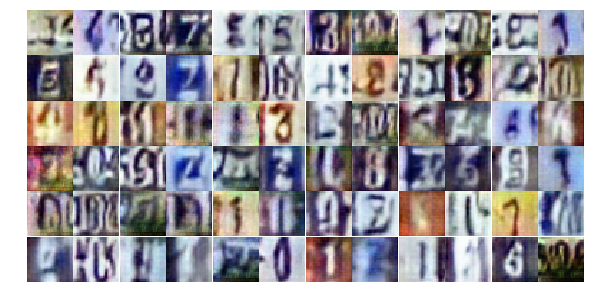

Epoch 24/25... Discriminator Loss: 1.4293... Generator Loss: 0.6422
Epoch 24/25... Discriminator Loss: 1.3950... Generator Loss: 0.7502
Epoch 24/25... Discriminator Loss: 1.3107... Generator Loss: 0.6884
Epoch 24/25... Discriminator Loss: 1.4217... Generator Loss: 0.7107
Epoch 24/25... Discriminator Loss: 1.4072... Generator Loss: 0.6642
Epoch 24/25... Discriminator Loss: 1.4055... Generator Loss: 0.6784
Epoch 24/25... Discriminator Loss: 1.4432... Generator Loss: 0.6558
Epoch 24/25... Discriminator Loss: 1.3687... Generator Loss: 0.8045
Epoch 24/25... Discriminator Loss: 1.3792... Generator Loss: 0.6637
Epoch 24/25... Discriminator Loss: 1.4202... Generator Loss: 0.6624


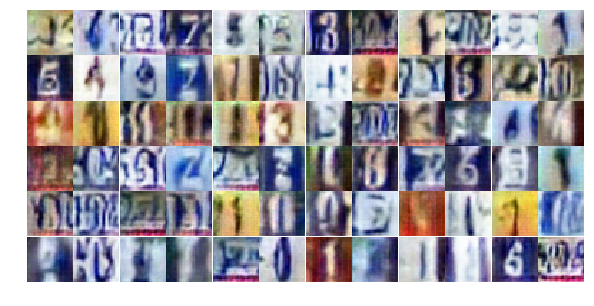

Epoch 24/25... Discriminator Loss: 1.3823... Generator Loss: 0.6622
Epoch 24/25... Discriminator Loss: 1.3472... Generator Loss: 0.7118
Epoch 24/25... Discriminator Loss: 1.5003... Generator Loss: 0.6262
Epoch 24/25... Discriminator Loss: 1.3091... Generator Loss: 0.7161
Epoch 24/25... Discriminator Loss: 1.4160... Generator Loss: 0.7050
Epoch 25/25... Discriminator Loss: 1.4714... Generator Loss: 0.6418
Epoch 25/25... Discriminator Loss: 1.3696... Generator Loss: 0.6984
Epoch 25/25... Discriminator Loss: 1.1586... Generator Loss: 0.7827
Epoch 25/25... Discriminator Loss: 1.4508... Generator Loss: 0.6944
Epoch 25/25... Discriminator Loss: 1.4078... Generator Loss: 0.6628


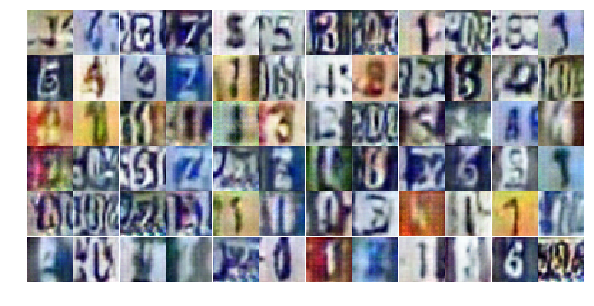

Epoch 25/25... Discriminator Loss: 1.4336... Generator Loss: 0.6844
Epoch 25/25... Discriminator Loss: 1.4488... Generator Loss: 0.6578
Epoch 25/25... Discriminator Loss: 1.3229... Generator Loss: 0.7126
Epoch 25/25... Discriminator Loss: 1.4260... Generator Loss: 0.6811
Epoch 25/25... Discriminator Loss: 1.4169... Generator Loss: 0.6861
Epoch 25/25... Discriminator Loss: 1.4567... Generator Loss: 0.6694
Epoch 25/25... Discriminator Loss: 1.4204... Generator Loss: 0.6051
Epoch 25/25... Discriminator Loss: 1.3781... Generator Loss: 0.6904
Epoch 25/25... Discriminator Loss: 1.3298... Generator Loss: 0.7276
Epoch 25/25... Discriminator Loss: 1.4811... Generator Loss: 0.6657


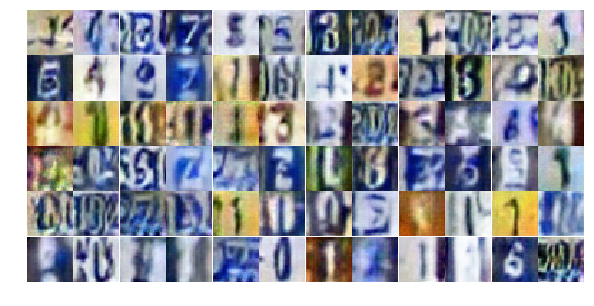

Epoch 25/25... Discriminator Loss: 1.3337... Generator Loss: 0.7492
Epoch 25/25... Discriminator Loss: 1.3292... Generator Loss: 0.7111
Epoch 25/25... Discriminator Loss: 1.3314... Generator Loss: 0.7377
Epoch 25/25... Discriminator Loss: 1.4543... Generator Loss: 0.6750
Epoch 25/25... Discriminator Loss: 1.4303... Generator Loss: 0.6868
Epoch 25/25... Discriminator Loss: 1.3565... Generator Loss: 0.7353
Epoch 25/25... Discriminator Loss: 1.3792... Generator Loss: 0.7013
Epoch 25/25... Discriminator Loss: 1.3607... Generator Loss: 0.6594
Epoch 25/25... Discriminator Loss: 1.3336... Generator Loss: 0.7340
Epoch 25/25... Discriminator Loss: 1.6056... Generator Loss: 0.6005


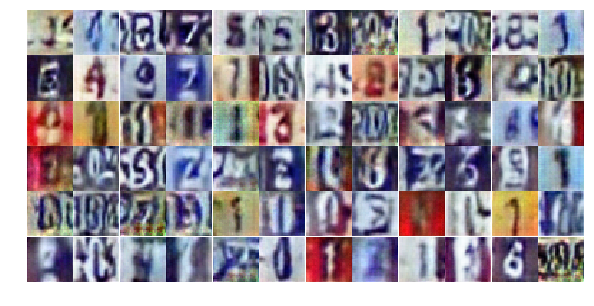

Epoch 25/25... Discriminator Loss: 1.3655... Generator Loss: 0.6000
Epoch 25/25... Discriminator Loss: 1.2748... Generator Loss: 0.9360
Epoch 25/25... Discriminator Loss: 1.4360... Generator Loss: 0.6477
Epoch 25/25... Discriminator Loss: 1.3679... Generator Loss: 0.7136
Epoch 25/25... Discriminator Loss: 1.4628... Generator Loss: 0.6614
Epoch 25/25... Discriminator Loss: 1.4310... Generator Loss: 0.6785
Epoch 25/25... Discriminator Loss: 1.3919... Generator Loss: 0.6940
Epoch 25/25... Discriminator Loss: 1.3770... Generator Loss: 0.7064
Epoch 25/25... Discriminator Loss: 1.4113... Generator Loss: 0.6244
Epoch 25/25... Discriminator Loss: 1.3273... Generator Loss: 0.7360


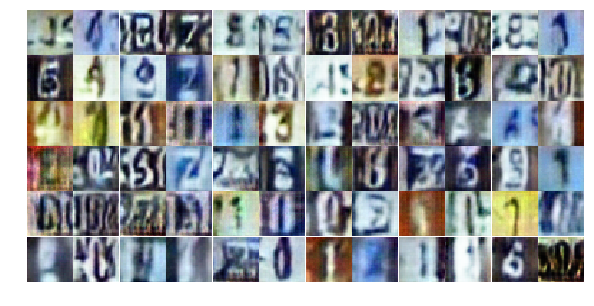

Epoch 25/25... Discriminator Loss: 1.4376... Generator Loss: 0.6069
Epoch 25/25... Discriminator Loss: 1.4132... Generator Loss: 0.7024
Epoch 25/25... Discriminator Loss: 1.4369... Generator Loss: 0.6417
Epoch 25/25... Discriminator Loss: 1.3821... Generator Loss: 0.7388
Epoch 25/25... Discriminator Loss: 1.3951... Generator Loss: 0.6806
Epoch 25/25... Discriminator Loss: 1.3339... Generator Loss: 0.7236
Epoch 25/25... Discriminator Loss: 1.2264... Generator Loss: 0.8031
Epoch 25/25... Discriminator Loss: 1.3237... Generator Loss: 0.6924
Epoch 25/25... Discriminator Loss: 1.2119... Generator Loss: 0.8365
Epoch 25/25... Discriminator Loss: 1.3367... Generator Loss: 0.8151


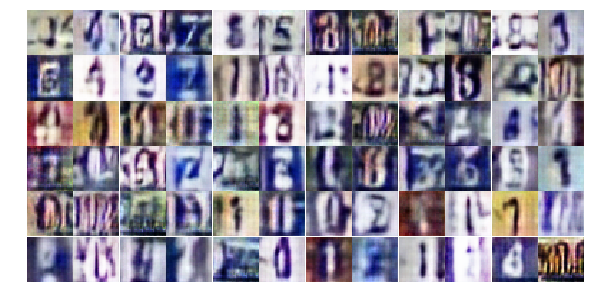

Epoch 25/25... Discriminator Loss: 1.3968... Generator Loss: 0.6350
Epoch 25/25... Discriminator Loss: 1.4044... Generator Loss: 0.6898
Epoch 25/25... Discriminator Loss: 1.3226... Generator Loss: 0.6692
Epoch 25/25... Discriminator Loss: 1.3257... Generator Loss: 0.7205
Epoch 25/25... Discriminator Loss: 1.3658... Generator Loss: 0.6782
Epoch 25/25... Discriminator Loss: 1.3925... Generator Loss: 0.6724
Epoch 25/25... Discriminator Loss: 1.3250... Generator Loss: 0.7914
Epoch 25/25... Discriminator Loss: 1.3595... Generator Loss: 0.6792
Epoch 25/25... Discriminator Loss: 1.3926... Generator Loss: 0.6719
Epoch 25/25... Discriminator Loss: 1.4295... Generator Loss: 0.6474


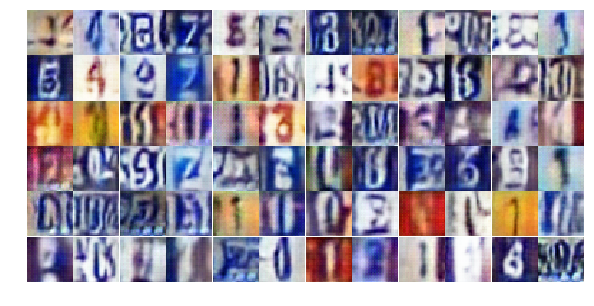

Epoch 25/25... Discriminator Loss: 1.4515... Generator Loss: 0.6683
Epoch 25/25... Discriminator Loss: 1.3720... Generator Loss: 0.6799


In [17]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

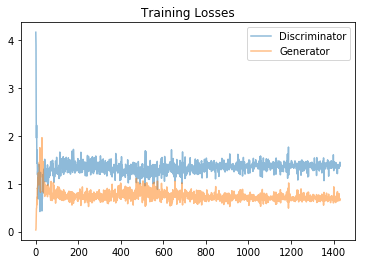

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

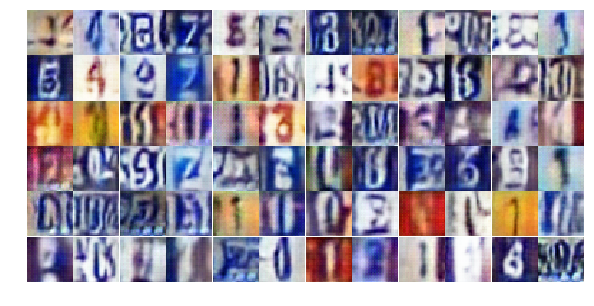

In [19]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))